#**Data Analysis on a Spotify Tracks Dataset**

#**About The Dataset**
The dataset is a collection of **Spotify** tracks with various features, providing a
rich source for analysis.


---

#**Track Information**

**track_id :** A unique identifier for the track on Spotify.

**track_name :** The title of the song.

**artist_name :** The name of the artist(s) who performed the song.

**album_name :** The name of the album the track belongs to.

**year :** The release year of the song.

**language :** The detected language of the song's lyrics.

**artwork_url :** A URL pointing to the album artwork for the track.

**track_url :** A URL to the Spotify track.


---



#**Popularity / Engagement**

**popularity :** A measure of how popular a track is, ranging from 0 to 100.


---



#**Audio Features (Musical Attributes)**

**acousticness :** A confidence measure indicating whether the track is acoustic, ranging from -1.0 to 1.0.

**danceability :** A measure of how suitable a track is for dancing, ranging from -1.0 to 1.0.

**energy :** A perceptual measure of intensity and activity, ranging from -1.0 to 1.0.

**instrumentalness :** Predicts whether a track contains no vocal content, ranging from -1.0 to 1.0.

**liveness :** Detects the presence of an audience in the recording, ranging from -1.0 to 1.0.

**loudness :** The overall loudness of a track in decibels (dB).

**speechiness :** A measure detecting the presence of spoken words in a track.

**valence :** A measure from -1.0 to 1.0 describing the musical positiveness conveyed by a track.


---



#**Technical Features (Musical Composition)**

**duration_ms :** The duration of the track in milliseconds.

**tempo :** The overall estimated tempo of a track in beats per minute (BPM).

**key :** The key the track is in, represented as an integer (e.g., 0 = C, 1 = C#, etc.).

**mode :** Indicates the modality (major or minor) of a track (0 for minor, 1 for major).

**time_signature :** An estimated overall time signature of a track.

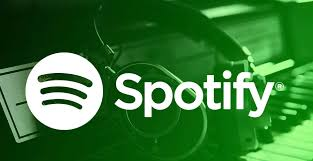

#**Notebook Structure**

1.   Importing Necessary Libraries.

1.   Importing The Datasets.

1.   Visualizing The Dataset.

1.   Important Pre-computation/Cleaning.

1.   Segregation Of Features.

1.   Exploratory Data Analysis - Univariate Analysis of Numerical Variables.

2.   Exploratory Data Analysis - Univariate Analysis of Categorical Variables.

2.   Exploratory Data Analysis - Bivariate Analysis.

2.   Exploratory Data Analysis - Multivariate Analysis.

2.   Exploratory Data Analysis - Timeseries Analysis.

2.   Exploratory Data Analysis - Top N & Bottom N Analysis.

2.   Exploratory Data Analysis - Some Hypothetical Analysis

1.   Final Recommendation

# **1. Importing Necessary Libraries**

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import textwrap
import warnings
warnings.filterwarnings('ignore')

# **2. Importing The Datasets**

In [ ]:
spotify = pd.read_csv('spotify_tracks.csv')
data_description = pd.read_csv('spotify_data_description.csv')

# **3. Visualizing The Dataset**

In [ ]:
data_description

,Column Name,Description
0,track_id,A unique identifier for the track on Spotify.
1,track_name,The title of the song.
2,artist_name,The name of the artist(s) who performed the song.
3,year,The release year of the song.
4,popularity,"A measure of how popular a track is, ranging f..."
5,artwork_url,A URL pointing to the album artwork for the tr...
6,album_name,The name of the album the track belongs to.
7,acousticness,A confidence measure indicating whether the tr...
8,danceability,A measure of how suitable a track is for danci...
9,duration_ms,The duration of the track in milliseconds.


In [ ]:
spotify.shape

(62317, 22)

In [ ]:
# Top 5 rows
spotify.head()

,track_id,track_name,artist_name,year,popularity,artwork_url,album_name,acousticness,danceability,duration_ms,...,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,track_url,language
0,2r0ROhr7pRN4MXDMT1fEmd,"Leo Das Entry (From ""Leo"")",Anirudh Ravichander,2024,59,https://i.scdn.co/image/ab67616d0000b273ce9c65...,"Leo Das Entry (From ""Leo"")",0.0241,0.753,97297.0,...,8.0,0.1000,-5.994,0.0,0.1030,110.997,4.0,0.459,https://open.spotify.com/track/2r0ROhr7pRN4MXD...,Tamil
1,4I38e6Dg52a2o2a8i5Q5PW,AAO KILLELLE,"Anirudh Ravichander, Pravin Mani, Vaishali Sri...",2024,47,https://i.scdn.co/image/ab67616d0000b273be1b03...,AAO KILLELLE,0.0851,0.780,207369.0,...,10.0,0.0951,-5.674,0.0,0.0952,164.995,3.0,0.821,https://open.spotify.com/track/4I38e6Dg52a2o2a...,Tamil
2,59NoiRhnom3lTeRFaBzOev,Mayakiriye Sirikiriye - Orchestral EDM,"Anirudh Ravichander, Anivee, Alvin Bruno",2024,35,https://i.scdn.co/image/ab67616d0000b27334a1dd...,Mayakiriye Sirikiriye (Orchestral EDM),0.0311,0.457,82551.0,...,2.0,0.0831,-8.937,0.0,0.1530,169.996,4.0,0.598,https://open.spotify.com/track/59NoiRhnom3lTeR...,Tamil
3,5uUqRQd385pvLxC8JX3tXn,Scene Ah Scene Ah - Experimental EDM Mix,"Anirudh Ravichander, Bharath Sankar, Kabilan, ...",2024,24,https://i.scdn.co/image/ab67616d0000b27332e623...,Scene Ah Scene Ah (Experimental EDM Mix),0.2270,0.718,115831.0,...,7.0,0.1240,-11.104,1.0,0.4450,169.996,4.0,0.362,https://open.spotify.com/track/5uUqRQd385pvLxC...,Tamil
4,1KaBRg2xgNeCljmyxBH1mo,Gundellonaa X I Am A Disco Dancer - Mashup,"Anirudh Ravichander, Benny Dayal, Leon James, ...",2024,22,https://i.scdn.co/image/ab67616d0000b2735a59b6...,Gundellonaa X I Am a Disco Dancer (Mashup),0.0153,0.689,129621.0,...,7.0,0.3450,-9.637,1.0,0.1580,128.961,4.0,0.593,https://open.spotify.com/track/1KaBRg2xgNeCljm...,Tamil


In [ ]:
# Bottom 5 rows
spotify.tail()

,track_id,track_name,artist_name,year,popularity,artwork_url,album_name,acousticness,danceability,duration_ms,...,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,track_url,language
62312,3eHDwMQYPEziy2DWRBNoLv,Sani - G.O.A.T Remix,"Arvind Raj, Sheezay, Music Kitchen, FSPROD Vin...",2021,30,https://i.scdn.co/image/ab67616d0000b273819d23...,Sani (G.O.A.T Remix),0.08490,0.877,359718.0,...,7.0,0.110,-11.458,1.0,0.3530,100.024,4.0,0.504,https://open.spotify.com/track/3eHDwMQYPEziy2D...,Tamil
62313,5hHtCqkNv5eo99OrEFFcgS,Life of Bachelor,"A H Kaashif, Navakkarai Naveen Prabanjam, Asal...",2021,30,https://i.scdn.co/image/ab67616d0000b2736cd651...,Bachelor (Original Motion Picture Soundtrack),0.07880,0.833,154364.0,...,8.0,0.267,-5.061,1.0,0.0813,110.041,4.0,0.524,https://open.spotify.com/track/5hHtCqkNv5eo99O...,Tamil
62314,08foF9YHgKmIgOy3xMWRZy,Yo Baby,"Rakesh Ambigapathy, Asal Kolaar, MC Vickey",2021,18,https://i.scdn.co/image/ab67616d0000b27300da25...,Yo Baby,0.00918,0.842,234000.0,...,7.0,0.079,-5.855,1.0,0.1370,122.038,4.0,0.669,https://open.spotify.com/track/08foF9YHgKmIgOy...,Tamil
62315,2wLFbVlQGKJSd9lwzwL47F,Fast Fast Vadiley,"Asal Kolaar, Priyadarshan Balasubramanian",2021,1,https://i.scdn.co/image/ab67616d0000b273e051e1...,Arjuna Phalguna,0.10100,0.682,180807.0,...,1.0,0.320,-6.061,1.0,0.2850,74.993,4.0,0.439,https://open.spotify.com/track/2wLFbVlQGKJSd9l...,Tamil
62316,5OYxwYeFfumMTAoAdVeet3,"Moonu Moonu Moonu (From ""3:33"")","Harshavardhan Rameshwar, G. V. Prakash, Dharma...",2021,1,https://i.scdn.co/image/ab67616d0000b273efd671...,"Moonu Moonu Moonu (From ""3:33"")",0.18600,0.817,202667.0,...,6.0,0.378,-7.353,0.0,0.1170,89.975,4.0,0.837,https://open.spotify.com/track/5OYxwYeFfumMTAo...,Tamil


In [ ]:
# Complete details(columns) of 1st row
spotify.head(1).T

,0
track_id,2r0ROhr7pRN4MXDMT1fEmd
track_name,"Leo Das Entry (From ""Leo"")"
artist_name,Anirudh Ravichander
year,2024
popularity,59
artwork_url,https://i.scdn.co/image/ab67616d0000b273ce9c65...
album_name,"Leo Das Entry (From ""Leo"")"
acousticness,0.0241
danceability,0.753
duration_ms,97297.0


In [ ]:
spotify.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62317 entries, 0 to 62316
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   track_id          62317 non-null  object 
 1   track_name        62317 non-null  object 
 2   artist_name       62317 non-null  object 
 3   year              62317 non-null  int64  
 4   popularity        62317 non-null  int64  
 5   artwork_url       62317 non-null  object 
 6   album_name        62317 non-null  object 
 7   acousticness      62317 non-null  float64
 8   danceability      62317 non-null  float64
 9   duration_ms       62317 non-null  float64
 10  energy            62317 non-null  float64
 11  instrumentalness  62317 non-null  float64
 12  key               62317 non-null  float64
 13  liveness          62317 non-null  float64
 14  loudness          62317 non-null  float64
 15  mode              62317 non-null  float64
 16  speechiness       62317 non-null  float6

# **4. Important Pre-computation/Cleaning**



*   Conversion of "year" to datetime.
*   Deriving new matrices.
*   Removing the missing values (unknown language).
*   Removing the invalid values (The -1 value for key, mode, tempo and time_signature & the -100000 value of loudness).
*   Finally how is the Dataset looking?







##A. Conversion of "year" to datetime

In [ ]:
# Convert year (int64) into datetime (YYYY-01-01)
spotify["year"] = pd.to_datetime(spotify["year"], format="%Y")

##B. Deriving new metrics



*   Converting duration from milliseconds to seconds in a new column.
*   New column for Energy to Danceability ratio (energy/danceability).
*   Decade ((year//10)*10), e.g 1990 to 1999 will be 1990 decade.
*   Mood (according on valence & energy).





In [ ]:
# Duration in seconds
spotify["duration_sec"] = spotify["duration_ms"] / 1000

In [ ]:
# Energy-to-Danceability Ratio
spotify["energy_dance_ratio"] = spotify["energy"] / (spotify["danceability"] + 1e-6)

In [ ]:
# Decade
spotify["decade"] = ((spotify["year"].dt.year // 10) * 10).astype("int64")

In [ ]:
# Mood Category (based on valence & energy)
def mood_category(row):
    if row["valence"] >= 0.5 and row["energy"] >= 0.5:
        return "Happy/Excited"
    elif row["valence"] < 0.5 and row["energy"] >= 0.5:
        return "Angry/Intense"
    elif row["valence"] < 0.5 and row["energy"] < 0.5:
        return "Sad/Calm"
    else:
        return "Peaceful/Chill"

spotify["mood"] = spotify.apply(mood_category, axis=1)


##C. Removing the missing values (unknown language)

In [ ]:
# Remove rows where language is "Unknown"
spotify = spotify[spotify["language"] != "Unknown"].reset_index(drop=True)

##D. Removing the invalid values of 'key', 'mode', 'tempo', 'time_signature' and 'loudness'

In [ ]:
# Define invalid conditions
invalid_condition = (
    (spotify['key'] == -1) |
    (spotify['mode'] == -1) |
    (spotify['tempo'] == -1) |
    (spotify['time_signature'] == -1) |
    (spotify['loudness'] == -100000)  # unrealistic loudness
)

# Extract invalid rows
invalid_rows = spotify[invalid_condition]

# Print number of invalid rows and the rows themselves
print(f"Number of invalid rows: {len(invalid_rows)}")


Number of invalid rows: 35


In [ ]:
# Keep only valid rows
spotify = spotify[~invalid_condition].reset_index(drop=True)

##E. The Dataset after all the basic pre-computation and cleaning

In [ ]:
spotify.shape

(49277, 26)

In [ ]:
spotify.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49277 entries, 0 to 49276
Data columns (total 26 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   track_id            49277 non-null  object        
 1   track_name          49277 non-null  object        
 2   artist_name         49277 non-null  object        
 3   year                49277 non-null  datetime64[ns]
 4   popularity          49277 non-null  int64         
 5   artwork_url         49277 non-null  object        
 6   album_name          49277 non-null  object        
 7   acousticness        49277 non-null  float64       
 8   danceability        49277 non-null  float64       
 9   duration_ms         49277 non-null  float64       
 10  energy              49277 non-null  float64       
 11  instrumentalness    49277 non-null  float64       
 12  key                 49277 non-null  float64       
 13  liveness            49277 non-null  float64   

In [ ]:
# Top 5 rows
spotify.head()

,track_id,track_name,artist_name,year,popularity,artwork_url,album_name,acousticness,danceability,duration_ms,...,speechiness,tempo,time_signature,valence,track_url,language,duration_sec,energy_dance_ratio,decade,mood
0,2r0ROhr7pRN4MXDMT1fEmd,"Leo Das Entry (From ""Leo"")",Anirudh Ravichander,2024-01-01,59,https://i.scdn.co/image/ab67616d0000b273ce9c65...,"Leo Das Entry (From ""Leo"")",0.0241,0.753,97297.0,...,0.1030,110.997,4.0,0.459,https://open.spotify.com/track/2r0ROhr7pRN4MXD...,Tamil,97.297,1.288179,2020,Angry/Intense
1,4I38e6Dg52a2o2a8i5Q5PW,AAO KILLELLE,"Anirudh Ravichander, Pravin Mani, Vaishali Sri...",2024-01-01,47,https://i.scdn.co/image/ab67616d0000b273be1b03...,AAO KILLELLE,0.0851,0.780,207369.0,...,0.0952,164.995,3.0,0.821,https://open.spotify.com/track/4I38e6Dg52a2o2a...,Tamil,207.369,1.016665,2020,Happy/Excited
2,59NoiRhnom3lTeRFaBzOev,Mayakiriye Sirikiriye - Orchestral EDM,"Anirudh Ravichander, Anivee, Alvin Bruno",2024-01-01,35,https://i.scdn.co/image/ab67616d0000b27334a1dd...,Mayakiriye Sirikiriye (Orchestral EDM),0.0311,0.457,82551.0,...,0.1530,169.996,4.0,0.598,https://open.spotify.com/track/59NoiRhnom3lTeR...,Tamil,82.551,1.074396,2020,Peaceful/Chill
3,5uUqRQd385pvLxC8JX3tXn,Scene Ah Scene Ah - Experimental EDM Mix,"Anirudh Ravichander, Bharath Sankar, Kabilan, ...",2024-01-01,24,https://i.scdn.co/image/ab67616d0000b27332e623...,Scene Ah Scene Ah (Experimental EDM Mix),0.2270,0.718,115831.0,...,0.4450,169.996,4.0,0.362,https://open.spotify.com/track/5uUqRQd385pvLxC...,Tamil,115.831,0.877436,2020,Angry/Intense
4,1KaBRg2xgNeCljmyxBH1mo,Gundellonaa X I Am A Disco Dancer - Mashup,"Anirudh Ravichander, Benny Dayal, Leon James, ...",2024-01-01,22,https://i.scdn.co/image/ab67616d0000b2735a59b6...,Gundellonaa X I Am a Disco Dancer (Mashup),0.0153,0.689,129621.0,...,0.1580,128.961,4.0,0.593,https://open.spotify.com/track/1KaBRg2xgNeCljm...,Tamil,129.621,1.085630,2020,Happy/Excited


In [ ]:
# Bottom 5 rows
spotify.tail()

,track_id,track_name,artist_name,year,popularity,artwork_url,album_name,acousticness,danceability,duration_ms,...,speechiness,tempo,time_signature,valence,track_url,language,duration_sec,energy_dance_ratio,decade,mood
49272,3eHDwMQYPEziy2DWRBNoLv,Sani - G.O.A.T Remix,"Arvind Raj, Sheezay, Music Kitchen, FSPROD Vin...",2021-01-01,30,https://i.scdn.co/image/ab67616d0000b273819d23...,Sani (G.O.A.T Remix),0.08490,0.877,359718.0,...,0.3530,100.024,4.0,0.504,https://open.spotify.com/track/3eHDwMQYPEziy2D...,Tamil,359.718,0.534777,2020,Peaceful/Chill
49273,5hHtCqkNv5eo99OrEFFcgS,Life of Bachelor,"A H Kaashif, Navakkarai Naveen Prabanjam, Asal...",2021-01-01,30,https://i.scdn.co/image/ab67616d0000b2736cd651...,Bachelor (Original Motion Picture Soundtrack),0.07880,0.833,154364.0,...,0.0813,110.041,4.0,0.524,https://open.spotify.com/track/5hHtCqkNv5eo99O...,Tamil,154.364,0.827130,2020,Happy/Excited
49274,08foF9YHgKmIgOy3xMWRZy,Yo Baby,"Rakesh Ambigapathy, Asal Kolaar, MC Vickey",2021-01-01,18,https://i.scdn.co/image/ab67616d0000b27300da25...,Yo Baby,0.00918,0.842,234000.0,...,0.1370,122.038,4.0,0.669,https://open.spotify.com/track/08foF9YHgKmIgOy...,Tamil,234.000,0.908550,2020,Happy/Excited
49275,2wLFbVlQGKJSd9lwzwL47F,Fast Fast Vadiley,"Asal Kolaar, Priyadarshan Balasubramanian",2021-01-01,1,https://i.scdn.co/image/ab67616d0000b273e051e1...,Arjuna Phalguna,0.10100,0.682,180807.0,...,0.2850,74.993,4.0,0.439,https://open.spotify.com/track/2wLFbVlQGKJSd9l...,Tamil,180.807,1.262461,2020,Angry/Intense
49276,5OYxwYeFfumMTAoAdVeet3,"Moonu Moonu Moonu (From ""3:33"")","Harshavardhan Rameshwar, G. V. Prakash, Dharma...",2021-01-01,1,https://i.scdn.co/image/ab67616d0000b273efd671...,"Moonu Moonu Moonu (From ""3:33"")",0.18600,0.817,202667.0,...,0.1170,89.975,4.0,0.837,https://open.spotify.com/track/5OYxwYeFfumMTAo...,Tamil,202.667,1.105262,2020,Happy/Excited


#**5. Segregation Of Features**

**Numerical (Continuous) :** acousticness, danceability, duration_ms, duration_sec, energy, instrumentalness, liveness, loudness, speechiness, tempo, valence, energy_dance_ratio

**Numerical (Discrete) :** popularity, key, mode, time_signature, decade

**Categorical :** track_id, track_name, artist_name, album_name, artwork_url, track_url, language, mood, popularity_segment

**Temporal :** year





# **6. Exploratory Data Analysis - Univariate Analysis of Numerical Variables**

*   Quantitative Analysis.
*   Visualizing Data Distribution using Histograms with KDE.
*   Visualization of Outliers using boxplot.
*   Visualizing the Discrete Numerical Variables.

In [ ]:
# Numerical Variables to be analyzed -
# Continious : acousticness, danceability, duration_sec, energy, instrumentalness, liveness, loudness, speechiness, tempo, valence, energy_dance_ratio
# Discrete: popularity, key, mode, time_signature, decade

##**A. Quantitative Analysis**

1. How are popularity, energy, danceability, and valence distributed across the tracks? Do songs tend to be popular, energetic, danceable, or happy?

2. What is the typical song length and tempo, and how much variation exists?

3. Which keys and modes are most common, and how are time signatures distributed?

4. How are acousticness, instrumentalness, and speechiness represented? Are songs mostly vocal, instrumental, or spoken?

5. What are the typical loudness and liveness levels? Are tracks mostly studio or live recordings?

6. How are songs distributed across decades, and how balanced is the energy–danceability ratio?

###**I. Distribution of Numerical Variables**

In [ ]:
print("Distribution of Numerical Variables:\n")

num_col = ['popularity', 'duration_sec', 'key', 'tempo', 'acousticness', 'loudness', 'danceability', 'energy', 'time_signature', 'speechiness', 'valence', 'instrumentalness', 'liveness', 'mode', 'decade', 'energy_dance_ratio']

i = 1

for col in num_col:
    print(f"{i}. Distribution of {col.upper()}\n")
    i += 1
    # Central tendency
    print(f"Mean      : {spotify[col].mean():.2f}")
    print(f"Median    : {spotify[col].median():.2f}")

    if col in ['popularity', 'key', 'mode', 'time_signature', 'decade', 'energy']:
        print(f"Mode      : {spotify[col].mode().tolist()}")

    # Dispersion
    print(f"Std Dev   : {spotify[col].std():.2f}")
    print(f"Min       : {spotify[col].min():.4f}")
    print(f"25% (Q1)  : {spotify[col].quantile(0.25):.2f}")
    print(f"50% (Q2)  : {spotify[col].quantile(0.50):.2f}")  # same as median
    print(f"75% (Q3)  : {spotify[col].quantile(0.75):.2f}")
    print(f"Max       : {spotify[col].max():.4f}")

    # Skewness & Kurtosis
    print(f"Skewness  : {spotify[col].skew():.2f}")
    print(f"Kurtosis  : {spotify[col].kurt():.2f}")

    print("="*60)
    print()


Distribution of Numerical Variables:

1. Distribution of POPULARITY

Mean      : 16.18
Median    : 8.00
Mode      : [0]
Std Dev   : 19.08
Min       : 0.0000
25% (Q1)  : 0.00
50% (Q2)  : 8.00
75% (Q3)  : 28.00
Max       : 93.0000
Skewness  : 1.17
Kurtosis  : 0.51

2. Distribution of DURATION_SEC

Mean      : 233.52
Median    : 228.84
Std Dev   : 102.41
Min       : 10.0270
25% (Q1)  : 188.89
50% (Q2)  : 228.84
75% (Q3)  : 276.71
Max       : 4581.4830
Skewness  : 10.32
Kurtosis  : 314.23

3. Distribution of KEY

Mean      : 5.10
Median    : 5.00
Mode      : [0.0]
Std Dev   : 3.56
Min       : 0.0000
25% (Q1)  : 2.00
50% (Q2)  : 5.00
75% (Q3)  : 8.00
Max       : 11.0000
Skewness  : 0.06
Kurtosis  : -1.27

4. Distribution of TEMPO

Mean      : 118.08
Median    : 118.34
Std Dev   : 28.44
Min       : 0.0000
25% (Q1)  : 96.01
50% (Q2)  : 118.34
75% (Q3)  : 135.03
Max       : 232.1980
Skewness  : 0.36
Kurtosis  : -0.15

5. Distribution of ACOUSTICNESS

Mean      : 0.35
Median    : 0.26
Std Dev  

###**II. Insights**

**Popularity**
*  **Mean :** 16, Median: 8, Mode: 0 → Most tracks are at the low end of popularity.
*   Skewness = 1.17 → long right tail (a few highly popular tracks raise the mean).
*   **The track set is dominated by unpopular or niche songs, only a small fraction achieve very high popularity.**

**Duration**
*   **Mean :** 233 sec (~3.9 min), Median: 229 sec.
*   Typical range (Q1–Q3): 189 – 277 sec (~3.1–4.6 min).
*   some extreme tracks up to 76 minutes (4581 sec) → skewness 10.3.
*   **The typical song length is ~3–4 minutes, aligning with standard commercial music. Outliers may represent live recordings or experimental tracks.**

**Keys**
*   **Mode :** Key = 0 (C major).
*  Spread is relatively uniform (Q1=2, Median=5, Q3=8).
*   **Songs are distributed across keys, but C major is slightly more common. No strong bias toward unusual keys.**

**Tempo**
*   **Mean/Median :** ~118 BPM.
*   **Typical range :** 96–135 BPM (Q1–Q3).
*   Balanced distribution, no strong skew.
*   **Most songs fall into mid-tempo range, typical for pop and mainstream music (danceable but not extremely fast/slow).**

**Acousticness**

*   **Median :** 0.26 (fairly low).
*   Distribution spread across full 0–1 range, but right-skewed.
*   **The track set leans toward electronic/produced tracks but still includes many acoustic songs.**

**Loudness**

*   **Median :** -7.3 dB, Typical range: -10.8 to -5.3 dB.
*   **Most tracks are loud and compressed, consistent with modern production standards.**

**Danceability**

*   **Median :** 0.63, Typical range: 0.49–0.73
*   Slight skew toward higher values.
*   **Songs are generally danceable, which fits with mainstream modern track sets.**

**Energy**


*   **Median :** 0.65, Mode: 0.65 → clustering around medium-high energy.
*   Balanced distribution, slight left skew.
*    **The track set leans toward energetic tracks rather than calm/ambient music.**

**Time Signature**

*   Mode = 4, overwhelmingly dominant.
*   Very few tracks in 3 or 5.
*   **4/4 is the standard time signature, as expected in pop and electronic music.**

**Speechiness**

*   **Median :** 0.05 → most songs are low speechiness (sung rather than spoken).
*   Long tail up to 0.95 → rap/spoken-word tracks.
*   **The track set is mostly lyrical, but includes some rap songs.**

**Valence**

*   **Median :** 0.50 → balanced mood.
*   **Spread :** wide across 0–1.
*   **The track set contains both happy and sad tracks, with no strong lean.**

**Instrumentalness**

*   **Median :** 0.00, Q3=0.04 → most tracks are non-instrumental (vocal).
*   Few high values near 1 → fully instrumental tracks.
*   **The track set leans heavily toward vocal tracks, but still represents instrumental music.**

**Liveness**

*  **Median :** 0.13, typical range 0.09–0.25.
*   Some very high values (~1.0) → live recordings.
*   **Mostly studio recordings, with a smaller presence of live performances.**

**Mode**

*   Mode = 1 (major), median also 1 → majority of songs are in major keys.
*   **The track set leans major (happier), but minor-key songs are also present.**

**Decade**

*   **Median :** 2010, Mode: 2020.
*   Majority of songs from 2010s and 2020s.
*   **The track set is modern-heavy, less historical coverage before 2000.**

**Energy-Dance Ratio**


*   **Median :** ~1.0, IQR: 0.76–1.31 → balanced energy vs danceability.
*   **Ignoring outliers, most songs maintain a natural balance between energy and danceability.**

**General Overview**

*   **Typical Song Profile :** A ~3.5 min, mid-tempo (118 BPM), danceable, energetic, studio-recorded pop track in a major key.
*   **Bias :** Skews toward recent, mainstream, high-energy, major-key songs.

##**B. Visualizing Data Distribution using Histograms with KDE**


*   **Variables :** popularity, acousticness, danceability, duration_sec, energy, instrumentalness, liveness, loudness, speechiness, tempo, valence, energy_dance_ratio
*   **Objective :** To show their distribution shapes, skewness, and potential multi-modality.



###**I. Visualizations**

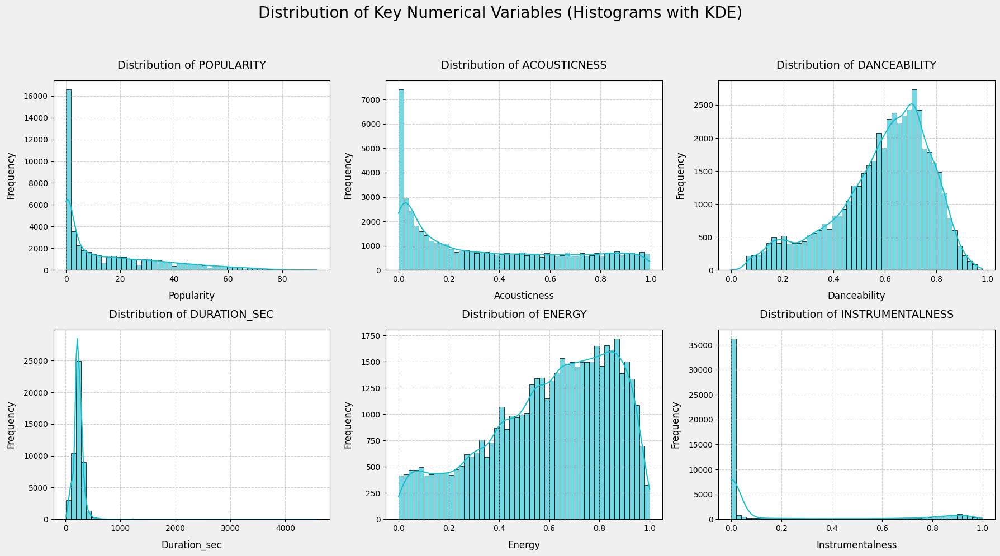

In [ ]:
# --- Define the numerical columns to plot ---

columns_to_plot = ['popularity', 'acousticness', 'danceability', 'duration_sec', 'energy', 'instrumentalness']

# Set a professional plotting style
# sns.set_theme(style="whitegrid")

# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10)) # Adjust figsize as needed
axes = axes.flatten() # Flatten the 2x3 array of axes for easy iteration

fig.suptitle('Distribution of Key Numerical Variables (Histograms with KDE)', fontsize=20, y=1.02) # Main title for the entire figure


# For BG color
fig.patch.set_facecolor('#f0f0f0')  # light grey background


# Loop through each column and plot its histogram with KDE
for i, col in enumerate(columns_to_plot):
    # Use sns.histplot for histogram and KDE (Kernel Density Estimate)
    # sns.histplot(data=spotify, x=col, kde=True, ax=axes[i], bins=50, color='#1f77b4', palette='Set1' , edgecolor='black')
    # sns.histplot(data=spotify, x=col, kde=True, ax=axes[i], bins=50, color='#2ca02c', edgecolor='black', alpha=0.6)
    sns.histplot(data=spotify, x=col, kde=True, ax=axes[i], bins=50, color='#17becf', edgecolor='black', alpha=0.6)

    # Set title and labels for each subplot
    axes[i].set_title(f'Distribution of {col.upper()}', fontsize=14, pad = 15)
    axes[i].set_xlabel(col.capitalize(), fontsize=12, labelpad = 10)
    axes[i].set_ylabel('Frequency', fontsize=12, labelpad = 10)

    # Axis color
    axes[i].set_facecolor('#ffffff')  # white, can be any color

    # Optional: Add grid for better readability
    axes[i].grid(True, linestyle='--', alpha=0.6)

# Adjust layout to prevent titles/labels from overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # [left, bottom, right, top] for padding

# Display the plot
plt.show()

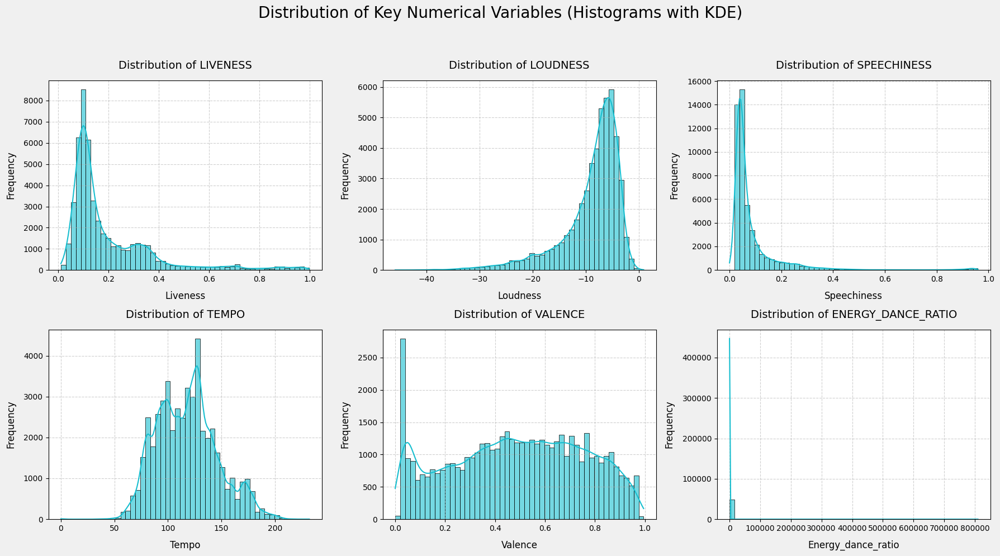

In [ ]:
# --- Define the numerical columns to plot ---

columns_to_plot = ['liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'energy_dance_ratio']

# Set a professional plotting style
# sns.set_theme(style="whitegrid")

# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10)) # Adjust figsize as needed
axes = axes.flatten() # Flatten the 2x3 array of axes for easy iteration

fig.suptitle('Distribution of Key Numerical Variables (Histograms with KDE)', fontsize=20, y=1.02) # Main title for the entire figure


# For BG color
fig.patch.set_facecolor('#f0f0f0')  # light grey background

# Loop through each column and plot its histogram with KDE
for i, col in enumerate(columns_to_plot):
    # Use sns.histplot for histogram and KDE (Kernel Density Estimate)
    # sns.histplot(data=spotify, x=col, kde=True, ax=axes[i], bins=50, color='#1f77b4', palette='Set1' , edgecolor='black')
    # sns.histplot(data=spotify, x=col, kde=True, ax=axes[i], bins=50, color='#2ca02c', edgecolor='black', alpha=0.6)
    sns.histplot(data=spotify, x=col, kde=True, ax=axes[i], bins=50, color='#17becf', edgecolor='black', alpha=0.6)

    # Set title and labels for each subplot
    axes[i].set_title(f'Distribution of {col.upper()}', fontsize=14, pad = 15)
    axes[i].set_xlabel(col.capitalize(), fontsize=12, labelpad = 10)
    axes[i].set_ylabel('Frequency', fontsize=12, labelpad = 10)

    # Axis color
    axes[i].set_facecolor('#ffffff')  # white, can be any color

    # Optional: Add grid for better readability
    axes[i].grid(True, linestyle='--', alpha=0.6)

# Adjust layout to prevent titles/labels from overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # [left, bottom, right, top] for padding

# Display the plot
plt.show()

###**II. Insights**

**Popularity :** Highly right-skewed with most tracks clustered at very low popularity, only a small tail reaches moderate-to-high popularity, indicating a long-tail distribution where hits are rare.

**Acousticness :** Broad spread with many tracks at low acousticness and a steady presence across mid-to-high values; catalog leans more electric/produced than purely acoustic.

**Danceability :** Unimodal concentration around 0.6–0.8, implying the dataset is generally oriented toward moderately to highly danceable tracks.

**Duration :** Strong right skew centered roughly around 180–240 seconds, with a small tail of very long tracks; typical song lengths dominate.

**Energy :** Distribution weighted toward 0.6–0.9 with fewer low-energy tracks, showing a preference for energetic music.

**Instrumentalness :** Mass piled near zero with a minor high-end bump, indicating most tracks contain vocals with a small subset of true instrumentals.

**Liveness :** Predominantly low liveness around 0.1–0.2 with a long right tail, suggesting most tracks are studio recordings with few live-performance cues.

**Loudness :** Concentration between roughly −12 to −5 dB with very few near 0 dB, indicating generally well-compressed but not clipping mixes typical of commercial releases.

**Speechiness :** Heavily skewed near 0 with sparse high values, meaning most tracks are music-dominant with limited spoken-word or rap-like segments.

**Tempo :** Bimodal-to-multimodal clusters around ~95–110 BPM and ~120–135 BPM, aligning with common pop/hip-hop and dance tempos.

**Valence :** Fairly even spread with a tilt toward mid-to-high valence (0.4–0.8), implying the catalog leans more positive/cheerful than dark.

**Energy Dance Ratio :** Mass near small values with extreme outliers, signaling the ratio is unstable for some records and dominated by a few anomalously large cases; consider winsorizing or using log/robust scaling before modeling.

##**C. Visualization of Outliers using Boxplot**

*   **Variables :** popularity, acousticness, danceability, duration_sec, energy, instrumentalness, liveness, loudness, speechiness, tempo, valence, energy_dance_ratio
*   **Objective :** Identify outliers and quartiles.

###**I. Visualizations**

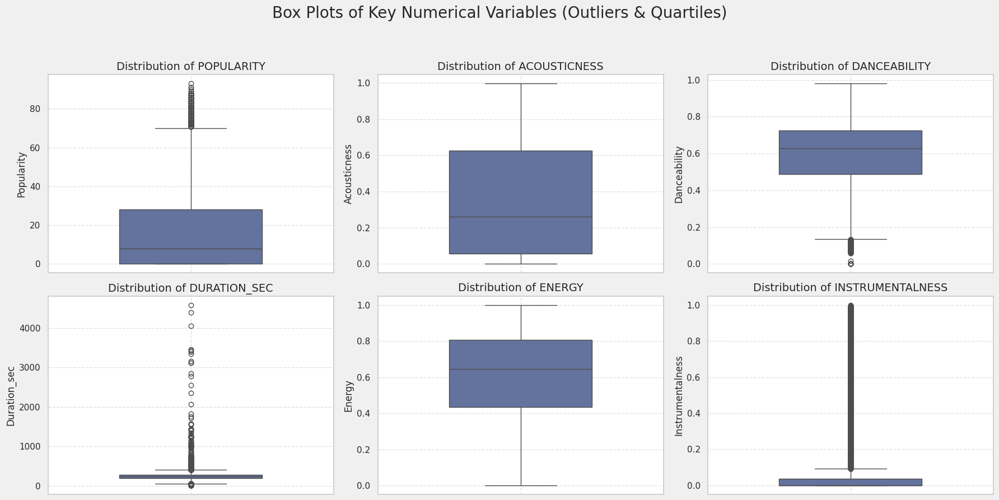

In [ ]:
# --- Define the numerical columns to plot ---

columns_to_plot = ['popularity', 'acousticness', 'danceability', 'duration_sec', 'energy', 'instrumentalness']

# Set a professional plotting style
sns.set_theme(style="whitegrid")

# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 9)) # Adjust figsize as needed
axes = axes.flatten() # Flatten the 2x3 array of axes for easy iteration

fig.suptitle('Box Plots of Key Numerical Variables (Outliers & Quartiles)', fontsize=20, y=1.02) # Main title for the entire figure

# For BG color
fig.patch.set_facecolor('#f0f0f0')  # light grey background

# Loop through each column and plot its box plot
for i, col in enumerate(columns_to_plot):
    # Use sns.boxplot for box plots
    sns.boxplot(data=spotify, y=col, ax=axes[i], color='#5B6EA6', width=0.5)

    # Set title and labels for each subplot
    axes[i].set_title(f'Distribution of {col.upper()}', fontsize=14)
    axes[i].set_xlabel('') # No x-label needed as it's a single box plot
    axes[i].set_ylabel(col.capitalize(), fontsize=12)

    # Optional: Add grid for better readability
    axes[i].grid(True, linestyle='--', alpha=0.6)

# Adjust layout to prevent titles/labels from overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # [left, bottom, right, top] for padding

# Display the plot
plt.show()

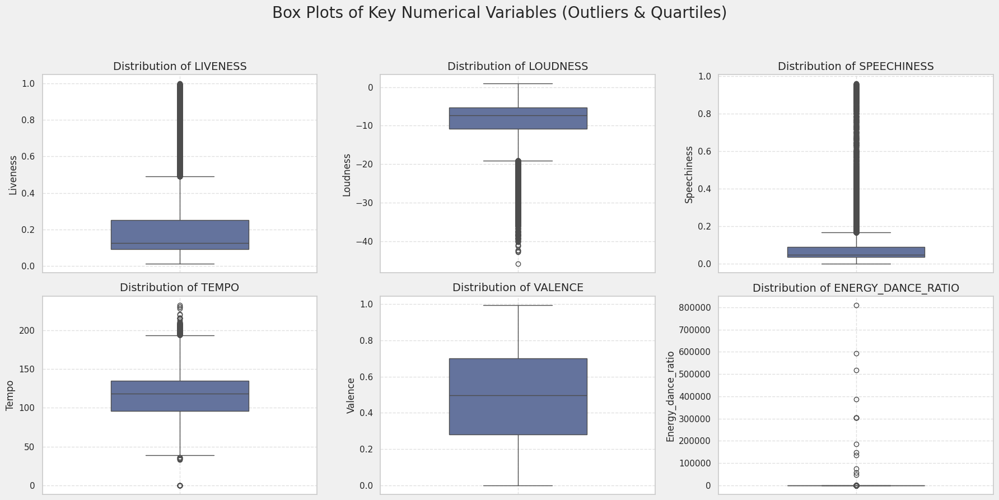

In [ ]:
# --- Define the numerical columns to plot ---

columns_to_plot = ['liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'energy_dance_ratio']

# Set a professional plotting style
sns.set_theme(style="whitegrid")

# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 9)) # Adjust figsize as needed
axes = axes.flatten() # Flatten the 2x3 array of axes for easy iteration

fig.suptitle('Box Plots of Key Numerical Variables (Outliers & Quartiles)', fontsize=20, y=1.02) # Main title for the entire figure

# For BG color
fig.patch.set_facecolor('#f0f0f0')  # light grey background

# Loop through each column and plot its box plot
for i, col in enumerate(columns_to_plot):
    # Use sns.boxplot for box plots
    sns.boxplot(data=spotify, y=col, ax=axes[i], color='#5B6EA6', width=0.5)

    # Set title and labels for each subplot
    axes[i].set_title(f'Distribution of {col.upper()}', fontsize=14)
    axes[i].set_xlabel('') # No x-label needed as it's a single box plot
    axes[i].set_ylabel(col.capitalize(), fontsize=12)

    # Optional: Add grid for better readability
    axes[i].grid(True, linestyle='--', alpha=0.6)

# Adjust layout to prevent titles/labels from overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # [left, bottom, right, top] for padding

# Display the plot
plt.show()

###**II. Insights**

**Popularity :** Median near the low single digits with IQR roughly 1–25, and a long upper whisker with many high-end outliers up to ~90, confirming a heavy right skew where a small fraction of tracks are disproportionately popular.

**Acousticness :** Median around ~0.25 with IQR ~0.07–0.60, showing broad variability; numerous low-end and high-end points beyond whiskers indicate both very electric and very acoustic extremes present as outliers.

**Danceability :** Median near ~0.62 with a compact IQR ~0.50–0.72, suggesting consistency toward moderate–high danceability, sparse low-end outliers exist but few extreme highs beyond ~0.95.

**Duration :** Median around standard song length (~200–240s) with a tight IQR centered near typical pop durations, but extreme upper outliers extend well past 1000s, highlighting a long tail of unusually long tracks and a handful of short anomalies.

**Energy :** Median near ~0.65 with IQR ~0.45–0.80, indicating a tilt toward energetic content, both low-energy and near-1.0 values appear as outliers, reflecting niche ambient and peak-intensity cuts.

**Instrumentalness :** Median near zero with a very low IQR close to 0–0.05, and a dense cluster of high-end outliers up to 1.0, confirming that vocals dominate while a minority are strongly instrumental.

**Liveness :** Median ~0.15 with IQR ~0.08–0.25; numerous high-end outliers beyond ~0.45 up to 1.0 indicate most tracks are studio-like while a minority show strong live characteristics.

**Loudness :** Median around −8 to −9 dB with IQR roughly −11 to −6 dB; substantial lower outliers extend below −20 dB suggesting a tail of very quiet/mastered-low tracks.

**Speechiness :** Median near ~0.05 with tight IQR ~0.03–0.08; a dense spike of outliers above ~0.15 up to ~1.0 reflects a small subset with spoken-word/rap features.

**Tempo :** Median ~115–120 BPM with IQR ~100–130 BPM; outliers include very slow (<40 BPM) and very fast (>190 BPM) pieces, revealing edge-case tempos.

Valence : Median ~0.5 with IQR ~0.3–0.7; symmetric spread with moderate tails and few extremes indicates a balanced mix of moods from sad to cheerful.

**Energy Dance Ratio :** Median near zero with extremely compressed IQR and massive positive outliers reaching ~800k, indicating a highly unstable ratio dominated by anomalies and requiring clipping/log-transform before modeling.

##**D. Visualizing the Discrete Numerical Variables**

*   Visualizing the Popularity distribution.
*   Visualizing the Key distribution.
*   Visualizing the Mode distribution.
*   Visualizing the Time Signature distribution.
*   Visualizing the Decade distribution.

###**I. Frequency/count analysis of variables**

In [ ]:
# Distribution of Popularity

print("\n--- Distribution of Popularity ---\n")
print("A. Top Popularities\n")
print(spotify['popularity'].value_counts().head(50))
print("\n" + "="*50)
print("A. Bottom Popularities\n")
print(spotify['popularity'].value_counts().tail(43))
print("\n" + "="*50)

# Dividing Popularity into segments

# Define bins and labels
bins = [0, 20, 40, 60, 80, 100]
labels = ['Very Low (0-20)', 'Low (21-40)', 'Medium (41-60)', 'High (61-80)', 'Very High (81-100)']

# Create a new column for popularity category
spotify['popularity_segment'] = pd.cut(spotify['popularity'], bins=bins, labels=labels, include_lowest=True)

print("\n--- Distribution of Popularity Segments ---\n")
print(spotify['popularity_segment'].value_counts())
print("\n" + "="*50)

# Distribution of Key

print("\n--- Distribution of Keys ---\n")
print(spotify['key'].value_counts())
print("\n" + "="*50)

# Distribution of Mode

print("\n--- Distribution of Modes ---\n")
print(spotify['mode'].value_counts())
print("\n" + "="*50)

# Distribution of Time Signature

print("\n--- Distribution of Time Signatues ---\n")
print(spotify['time_signature'].value_counts())
print("\n" + "="*50)

# Distribution of Decade

print("\n--- Distribution of Decades ---\n")
print(spotify['decade'].value_counts())


--- Distribution of Popularity ---

A. Top Popularities

popularity
0     13351
1      3251
2      2069
3      1504
4      1202
5      1092
6       948
7       860
8       849
9       826
11      729
10      705
14      691
12      681
17      663
13      657
18      654
15      614
19      606
22      589
21      588
16      582
20      573
23      549
26      540
30      527
28      526
31      517
24      514
25      483
27      476
32      467
29      466
34      451
33      437
35      430
38      404
37      402
36      394
39      373
40      353
43      341
42      339
41      338
47      338
44      318
45      296
46      276
49      263
48      262
Name: count, dtype: int64

A. Bottom Popularities

popularity
50    262
53    224
52    224
51    222
55    218
54    211
57    204
56    178
58    175
59    169
61    157
60    153
65    129
62    124
66    122
63    116
67    116
64    107
68     99
69     99
70     72
73     70
71     69
72     56
74     46
75     42
77     33

###**II. Visualizations**

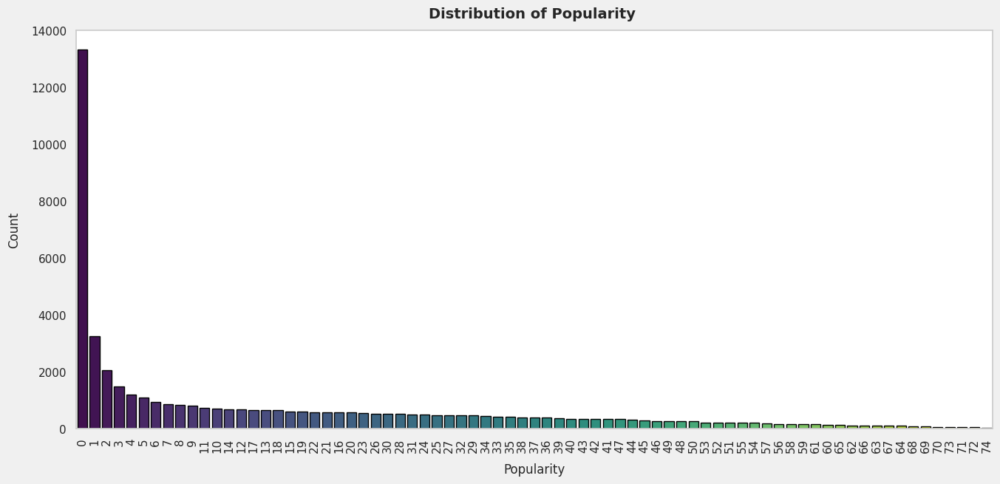

In [ ]:
# Visualizing the Popularity distribution
top = spotify['popularity'].value_counts().head(75).sort_values(ascending=False)  # ensures top 10 by count


plt.figure(figsize=(16,7), facecolor='#f0f0f0')
sns.barplot(x=top.index, y=top.values, palette='viridis', edgecolor='black', order=top.index)

plt.title('Distribution of Popularity ', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Popularity', fontsize=12, labelpad=10)
plt.ylabel('Count', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

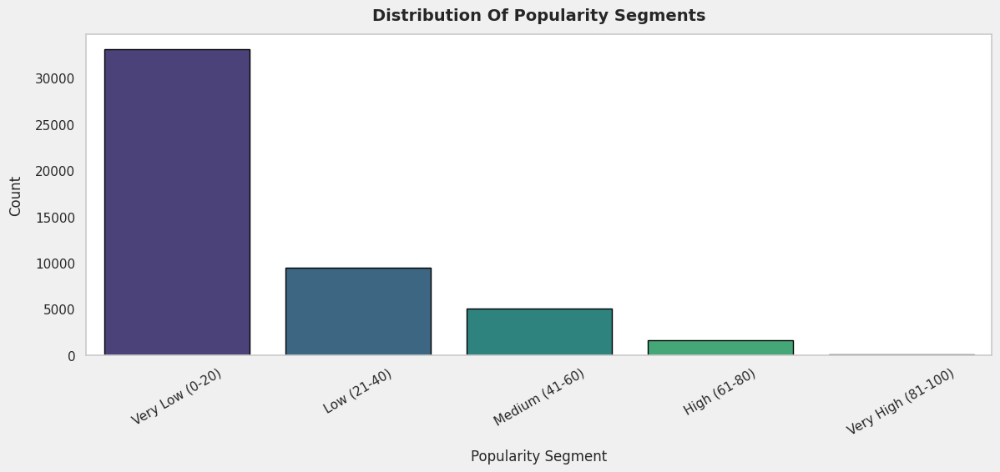

In [ ]:
# Visualizing the Popularity Segment distribution
plt.figure(figsize=(14,5), facecolor='#f0f0f0')

sns.barplot(x=spotify['popularity_segment'].value_counts().index, y=spotify['popularity_segment'].value_counts().values, palette='viridis', edgecolor='black')

plt.title('Distribution Of Popularity Segments', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Popularity Segment', fontsize=12, labelpad=10)
plt.ylabel('Count', fontsize=12, labelpad=10)
plt.xticks(rotation=30)
plt.grid(False)
plt.show()

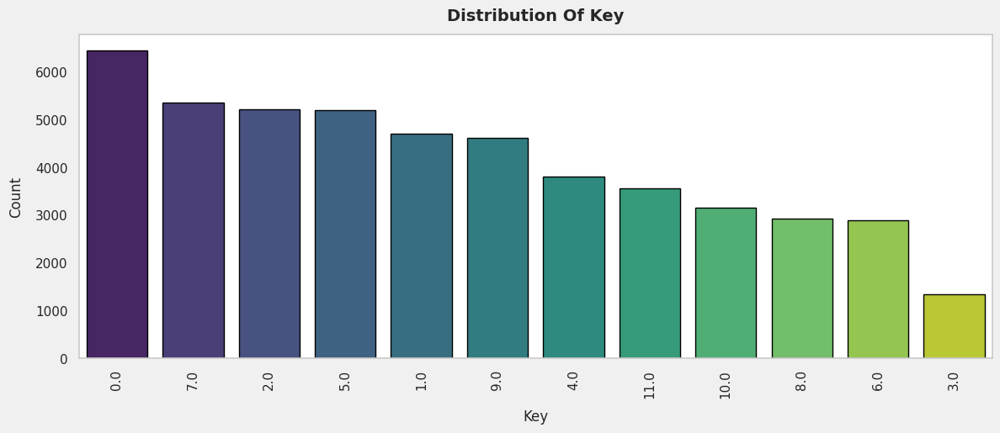

In [ ]:
# Visualizing the Key distribution

plt.figure(figsize = (14,5), facecolor='#f0f0f0')
sns.barplot(spotify['key'].value_counts() , palette = 'viridis' , edgecolor = 'black' , order = spotify['key'].value_counts().index)

plt.title('Distribution Of Key', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Key', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

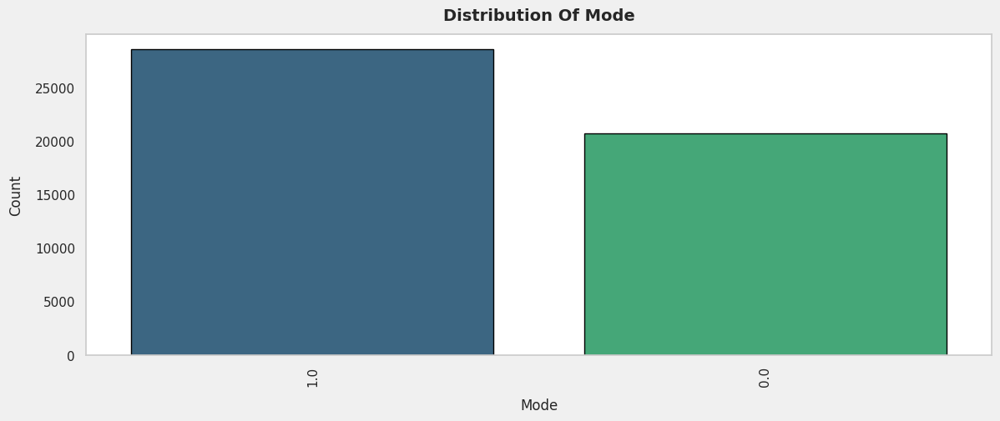

In [ ]:
# Visualizing the Mode distribution

plt.figure(figsize = (14,5), facecolor='#f0f0f0')
sns.barplot(spotify['mode'].value_counts() , palette = 'viridis' , edgecolor = 'black' , order = spotify['mode'].value_counts().index)

plt.title('Distribution Of Mode', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Mode', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

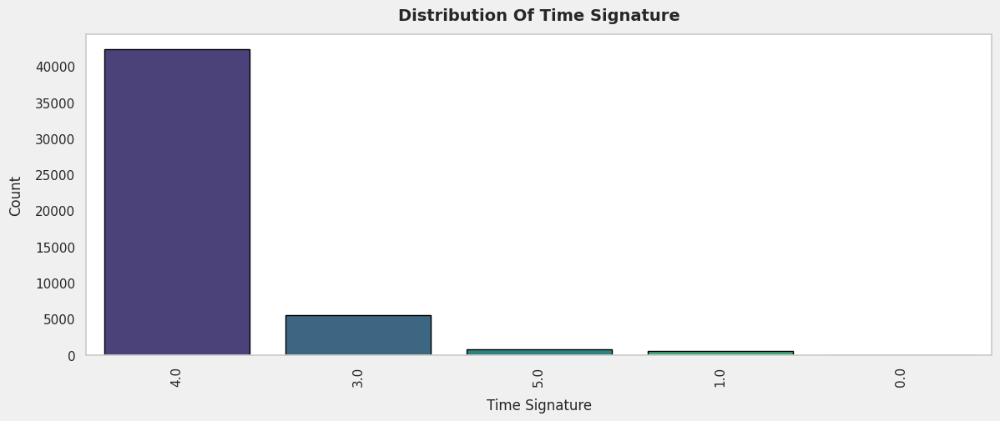

In [ ]:
# Visualizing the Time Signature distribution

plt.figure(figsize = (14,5), facecolor='#f0f0f0')
sns.barplot(spotify['time_signature'].value_counts() , palette = 'viridis' , edgecolor = 'black' , order = spotify['time_signature'].value_counts().index)

plt.title('Distribution Of Time Signature', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Time Signature', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

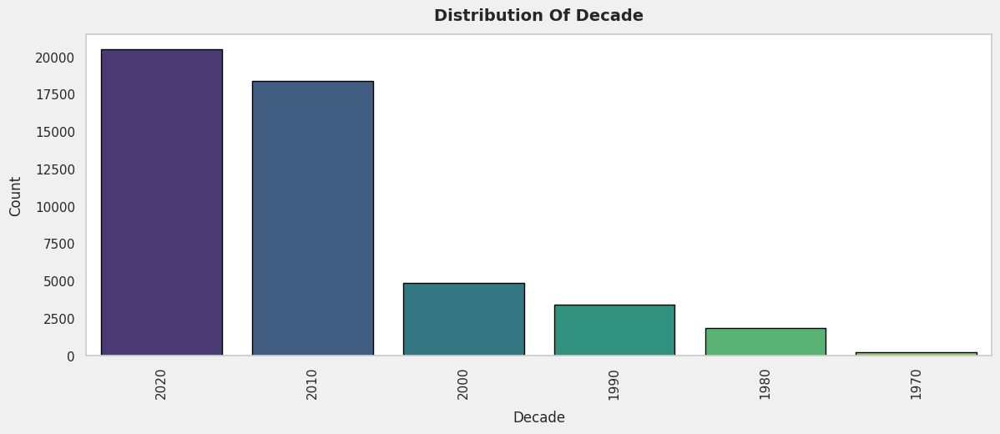

In [ ]:
# Visualizing the Decade distribution

plt.figure(figsize = (14,5), facecolor='#f0f0f0')
sns.barplot(spotify['decade'].value_counts() , palette = 'viridis' , edgecolor = 'black' , order = spotify['decade'].value_counts().index)

plt.title('Distribution Of Decade', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Decade', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

###**III. Insights**

**Popularity Segments :** The catalog is dominated by the “Very Low” bucket, with a steep drop as popularity rises—prioritize a two-tier strategy: growth hacks (collabs, playlist pitching, TikTok snippets) for the long tail, and concentrated ad spend on the small “High” segment to push proven tracks into “Very High” for outsized ROI.

**Key :** Key “0” i.e. "C" leads by a wide margin, with keys 7("G"), 2("D"), and 5("F") also strong, suggesting playlists and releases skew toward a few musical keys—target these keys for covers, remixes, or catalog expansion to align with listener comfort zones and maximize completion rates.

**Time Signature :** 4/4 overwhelmingly dominates, with small niches in 3/4 and 5/4—focus production and A&R on 4/4 for scale while using 3/4 selectively to differentiate ballads and sync pitches without sacrificing mass appeal.

**Mode (Major vs Minor) :** Major mode slightly outweighs minor—maintain a core release mix that leans major for radio and playlist friendliness, while reserving minor-mode tracks for mood/genre verticals (e.g., alt, trap, cinematic) where engagement is deeper even if audience is narrower.

**Decade :** Recent music dominates the catalog, with the 2020s and 2010s contributing the bulk of tracks and sharp falloff before 2000—focus marketing, playlisting, and licensing on modern catalogs for scale, while packaging pre-2000 content as niche “throwback” products to capture nostalgia without over-investing inventory.

#**7. Exploratory Data Analysis - Univariate Analysis of Categorical Variables**

*   Quantitative Analysis.
*   Visualization using Bar Plots & Pie Charts.
*   Overall Insights.

In [ ]:
# Categorical Variables to be Analyzed : artist_name, language, mood

##**A. Quantitative Analysis**

*   Which languages should get priority budget based on current share and growth potential?

*   Which moods dominate demand, and which playlists should be scaled vs maintained?

*   How concentrated is output among top artists?

*   Which regional niches merit low-cost experiments while major languages scale?

**As multiple artists are present in single song, we need to split them to individual one for the song for artist level analysis.**

In [ ]:
# Make a copy for artist-level analysis
spotify_artists = spotify.copy()

# Split artist_name into list (assuming they are separated by commas)
spotify_artists['artist_name'] = spotify_artists['artist_name'].str.split(',')

# Explode the list so each artist gets its own row
spotify_artists = spotify_artists.explode('artist_name')

# Remove extra spaces around artist names
spotify_artists['artist_name'] = spotify_artists['artist_name'].str.strip()

# Now spotify_artists is ready for artist-level analysis


In [ ]:
# Number of unique Artist, Language, Mood.

print("\n--- Number of Unique Values ---\n")
print(f"   Number of unique Artists: {spotify_artists['artist_name'].nunique()}")
print(f"   Number of unique Languages: {spotify['language'].nunique()}")
print(f"   Number of unique Moods: {spotify['mood'].nunique()}")
print("\n" + "="*50)

# Most frequent Artists (count/percentage).

print("\n--- Distribution of Artists ---\n")
print("\nA. Frequency:\n")
print(spotify_artists['artist_name'].value_counts())
# print("\n" + "="*50)
print("\nB. Percentage(%):\n")
print(spotify_artists['artist_name'].value_counts(normalize=True) * 100) # Multiply by 100 for percentage
print("\n" + "="*50)

# Most frequent Languages (count/percentage).

print("\n--- Distribution of Languages ---\n")
print("\nA. Frequency:\n")
print(spotify['language'].value_counts())
# print("\n" + "="*50)
print("\nB. Percentage(%):\n")
print(spotify['language'].value_counts(normalize=True) * 100) # Multiply by 100 for percentage
print("\n" + "="*50)

# Most frequent Moods (count/percentage).

print("\n--- Frequency of Moods ---\n")
print("\nA. Frequency:\n")
print(spotify['mood'].value_counts())
# print("\n" + "="*50)
print("\nB. Percentage(%)\n")
print(spotify['mood'].value_counts(normalize=True) * 100) # Multiply by 100 for percentage


--- Number of Unique Values ---

   Number of unique Artists: 6413
   Number of unique Languages: 6
   Number of unique Moods: 4


--- Distribution of Artists ---


A. Frequency:

artist_name
Ilaiyaraaja             3945
Yuvan Shankar Raja      1994
Arijit Singh            1893
Anirudh Ravichander     1714
Madonna                 1542
                        ... 
Kavin                      1
ImpressNo1                 1
Sukanya Varadharajan       1
honeymoonhenny             1
Keya Pothen                1
Name: count, Length: 6413, dtype: int64

B. Percentage(%):

artist_name
Ilaiyaraaja             4.422894
Yuvan Shankar Raja      2.235551
Arijit Singh            2.122316
Anirudh Ravichander     1.921632
Madonna                 1.728796
                          ...   
Kavin                   0.001121
ImpressNo1              0.001121
Sukanya Varadharajan    0.001121
honeymoonhenny          0.001121
Keya Pothen             0.001121
Name: proportion, Length: 6413, dtype: float64


--- 

##**B. Visualizations**

*   **Variables :** Artist_name, Language, Mood
*   **Objective :** For the frequency distribution and proportional representation of top categories.

###**I. Visualization using Bar Plots (Count Plots)**

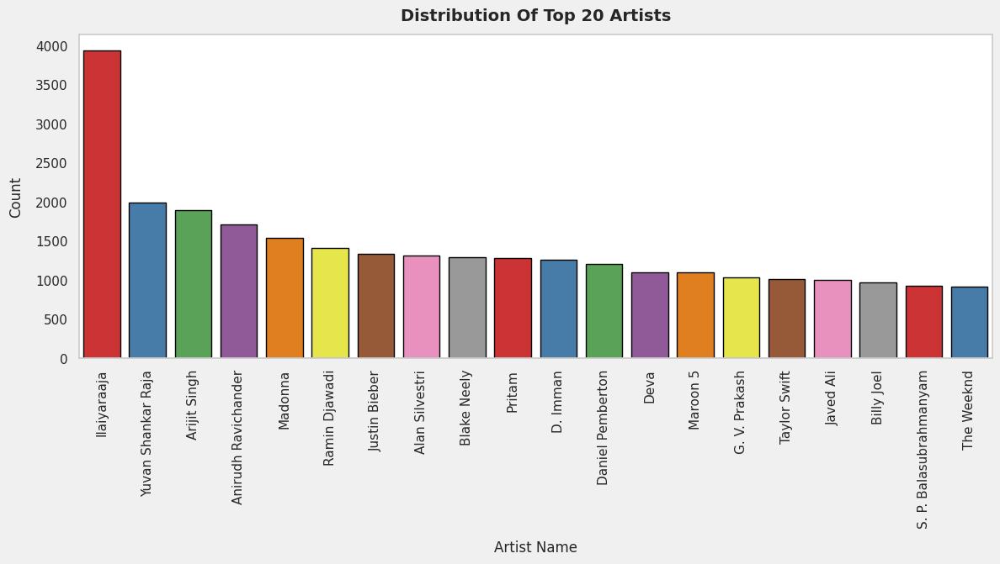

In [ ]:
# Visualizing the distribution of Artists

top_artists = spotify_artists['artist_name'].value_counts().head(20)

# Plot
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top_artists.index, y=top_artists.values, palette='Set1', edgecolor='black')

plt.title('Distribution Of Top 20 Artists', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Artist Name', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

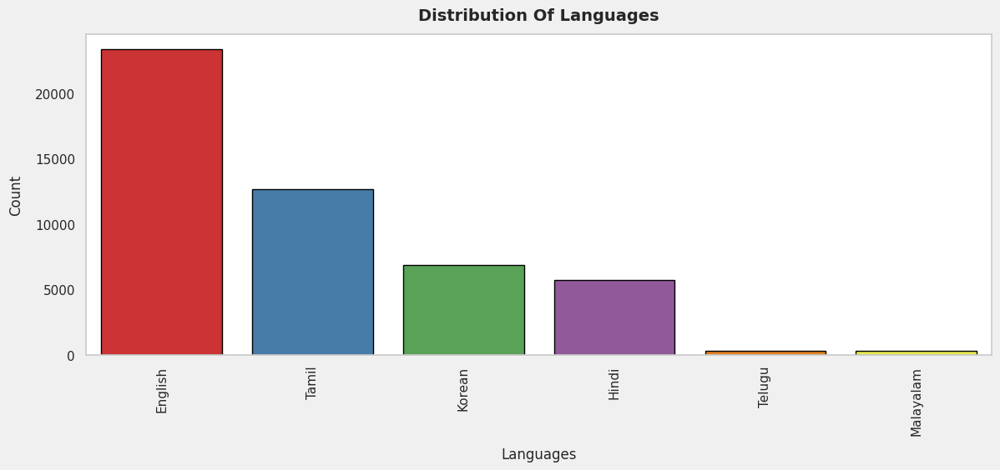

In [ ]:
# Visualizing the distribution of Languages

plt.figure(figsize = (14,5), facecolor='#f0f0f0')
sns.barplot(spotify['language'].value_counts() , palette = 'Set1' , edgecolor = 'black' , order = spotify['language'].value_counts().index)

plt.title('Distribution Of Languages', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

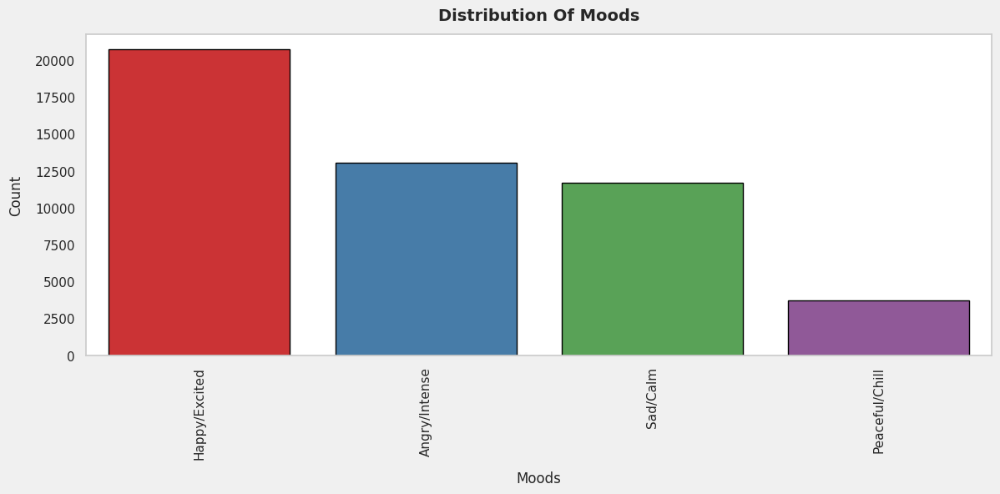

In [ ]:
# Visualizing the distribution Moods

plt.figure(figsize = (14,5), facecolor='#f0f0f0')
sns.barplot(spotify['mood'].value_counts() , palette = 'Set1' , edgecolor = 'black' , order = spotify['mood'].value_counts().index)

plt.title('Distribution Of Moods', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

###**II. Visualization using Pie chart**

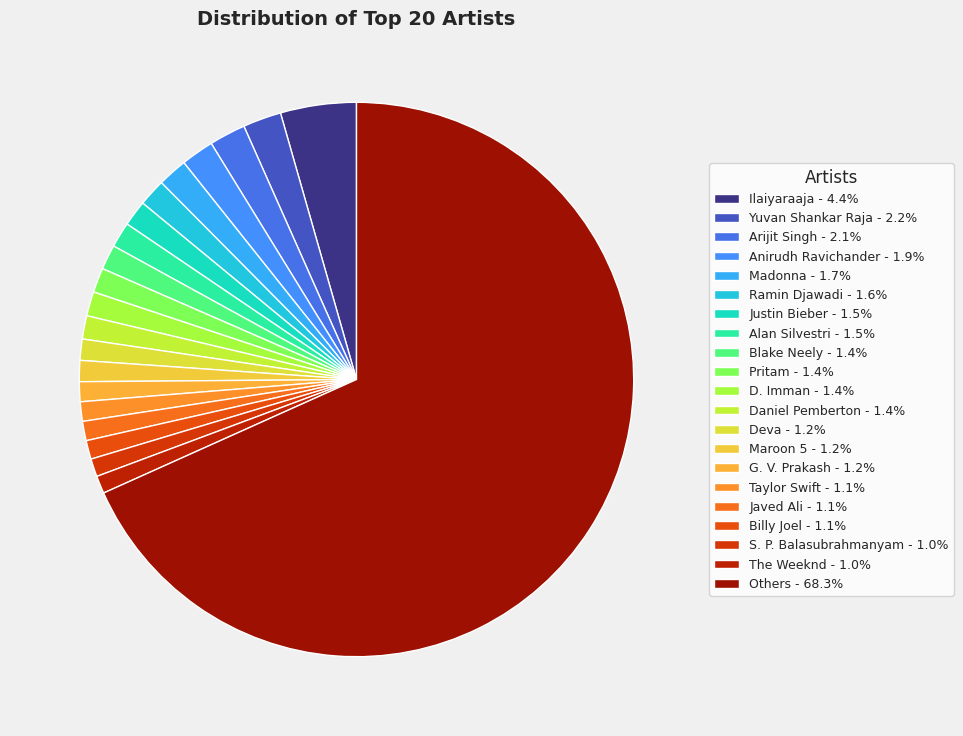

In [ ]:
# Pie chart for Top 20 Artists + Others
count_artist_name = spotify_artists['artist_name'].value_counts()

# Keep top 20, rest as 'Others'
top20 = count_artist_name.head(20)
others = pd.Series(count_artist_name.iloc[20:].sum(), index=["Others"])
count_artist_name_final = pd.concat([top20, others])

# Plot
plt.figure(figsize=(14,9), facecolor='#f0f0f0')
wedges, texts = plt.pie(count_artist_name_final, startangle=90, colors=sns.color_palette("turbo", len(count_artist_name_final)))

# Prepare labels with percentage values
labels = [f"{artist} - {val:.1f}%" for artist, val in zip(count_artist_name_final.index, count_artist_name_final / count_artist_name_final.sum() * 100)]

# Add legend
plt.legend(wedges, labels, title="Artists", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=9)

plt.title("Distribution of Top 20 Artists", fontsize=14, fontweight="bold")
plt.show()

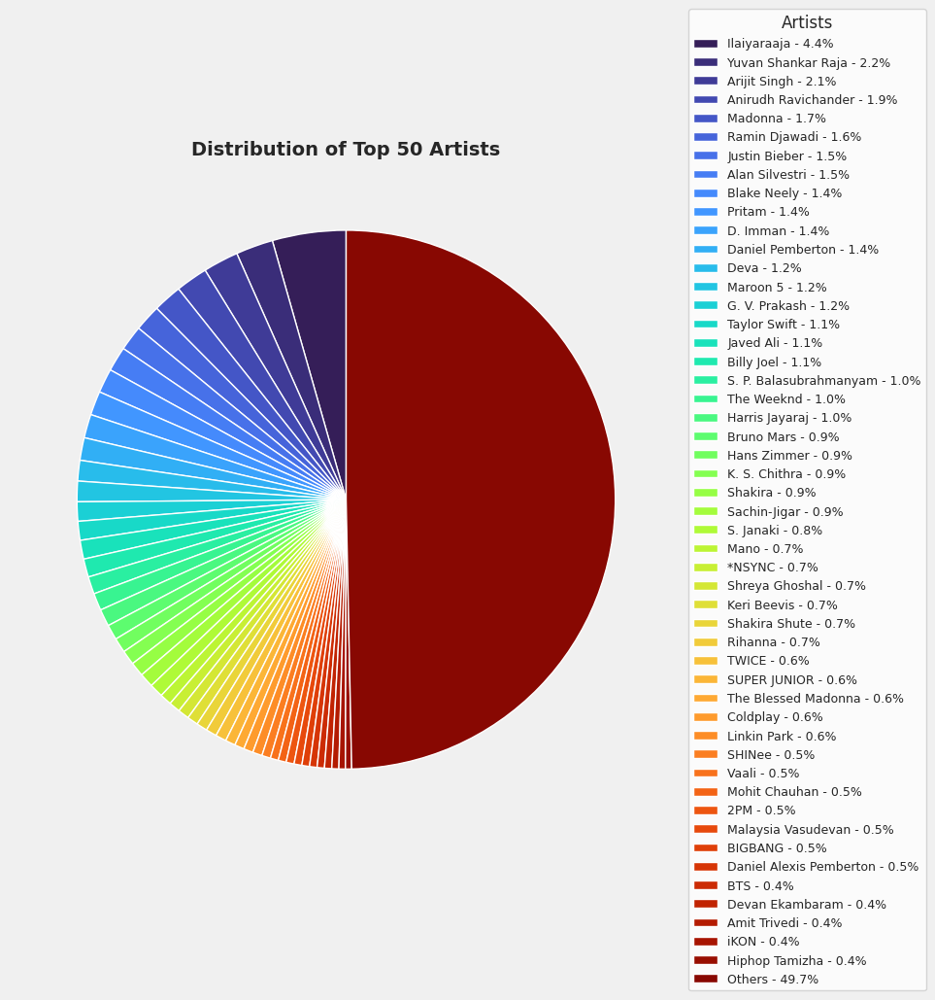

In [ ]:
# Pie chart for Top 50 Artists + Others
count_artist_name = spotify_artists['artist_name'].value_counts()

# Keep top 50, rest as 'Others'
top50 = count_artist_name.head(50)
others = pd.Series(count_artist_name.iloc[50:].sum(), index=["Others"])
count_artist_name_final = pd.concat([top50, others])

# Plot
plt.figure(figsize=(9,9), facecolor='#f0f0f0')
wedges, texts = plt.pie(count_artist_name_final, startangle=90, colors=sns.color_palette("turbo", len(count_artist_name_final)))

# Prepare labels with percentage values
labels = [f"{artist} - {val:.1f}%" for artist, val in zip(count_artist_name_final.index, count_artist_name_final / count_artist_name_final.sum() * 100)]

# Add legend
plt.legend(wedges, labels, title="Artists", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=9)

plt.title("Distribution of Top 50 Artists", fontsize=14, fontweight="bold")
plt.show()

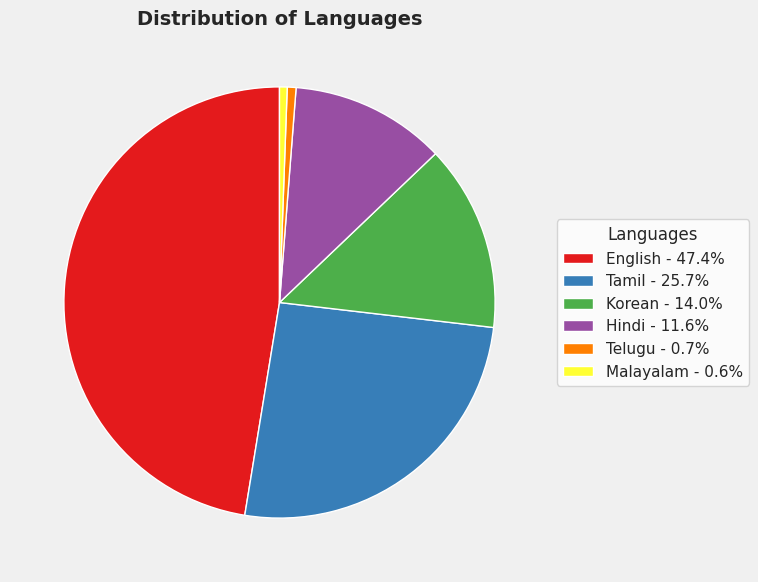

In [ ]:
# Pie chart for Languages

plt.figure(figsize=(7,7), facecolor='#f0f0f0')
wedges, texts = plt.pie(spotify['language'].value_counts(), startangle=90, colors=sns.color_palette("Set1", len(spotify['language'].value_counts())))

# Prepare labels with percentage values
labels = [f"{lang} - {val:.1f}%" for lang, val in zip(spotify['language'].value_counts().index, spotify['language'].value_counts()/spotify['language'].value_counts().sum()*100)]

# Add legend with labels + percentages
plt.legend(wedges, labels, title="Languages", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.title("Distribution of Languages", fontsize=14, fontweight="bold")
plt.show()

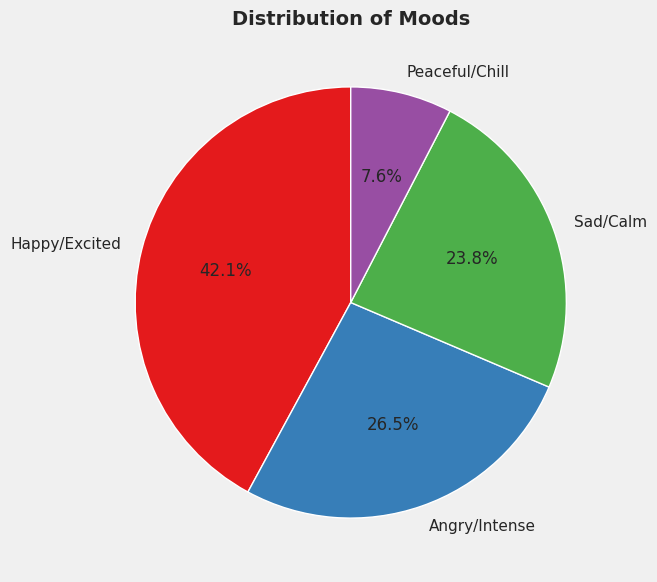

In [ ]:
# Example: Pie chart for Moods

plt.figure(figsize=(7,7), facecolor='#f0f0f0')
plt.pie(spotify['mood'].value_counts(), labels=spotify['mood'].value_counts().index, autopct='%1.1f%%', startangle=90, colors=sns.color_palette("Set1", len(spotify['mood'].value_counts())))
plt.title("Distribution of Moods", fontsize=14, fontweight="bold")
plt.show()

##**C. Insights**

**Top Artists**

*   Heavy long tail : “Others” make up ~68%, showing a highly fragmented catalog—use algorithmic discovery playlists and UGC to surface niche artists efficiently. 50% of all songs come from just the top 50 artists, meaning only ~0.78% of singers account for half the catalog—build discovery products for the long tail while concentrating marketing on this elite cohort for efficient scale.

*   Clear tier-1 leaders : Ilaiyaraaja (around 4.4%) is the single largest draw, followed by Yuvan Shankar Raja (around 2.2%), Arijit Singh (around 2.1%), and Anirudh Ravichander (around 1.9%)—anchor marquee campaigns and catalog remasters around these names for maximum uplift.

*   Mixed global-regional appeal : Presence of Madonna, Justin Bieber, Taylor Swift, The Weeknd alongside South Asian leaders suggests dual-track programming—global pop for scale, regional icons for depth and loyalty.

*   Catalog leverage : Top-20 artists each contribute ~1–4%—bundle greatest-hits, mood-based compilations, and era boxes to drive replays with minimal new production cost.

*   Growth play in mid-tiers : Artists ranked 5–20 have similar counts—target them with incremental promo (playlist top slots, short ads) where marginal spend can push tracks into breakout territory.

*   Creator partnerships : The long-tail volume is ideal for influencer packs and editorial “discovery” lanes, converting small fan pockets into steady stream growth.

**Languages**

*   English is the anchor market : Nearly half of the catalog is in English (47.4%), making it the natural priority for mainstream playlisting, global ad targeting, and partnerships; optimize SEO, metadata, and release calendars with English-first campaigns to drive scale.

*   Strong South Indian footprint : Tamil accounts for a quarter of the library (25.7%), indicating a sizable regional opportunity—curate Tamil-first editorial shelves, creator collabs, and festival-timed drops to deepen engagement and subscription conversion in TN diaspora clusters.

*   Rising K-wave potential : Korean content at ~14.0% is substantial enough to justify dedicated K-pop/K-indie lanes—bundle fan-centric features (fancams, lyrics, photocards) and sync with comeback calendars to boost repeat listens and merch tie-ins.

*   Hindi is underweighted vs market size : At 11.6%, Hindi share is smaller than general audience demand in India—expand acquisition of Hindi catalog and label deals, and repurpose high-performing English/Tamil formats into Hindi to lift reach.

*   Niche tail (Telugu, Malayalam) is small but strategic : Each is below 1%, ideal for high-ROI micro-verticals—launch city-level playlists, hyperlocal influencer series, and vernacular podcast crossovers to grow cheaply while improving regional retention.

*   Portfolio balance for growth : Current mix supports a dual strategy—use English and Tamil for scale, while Korean and Hindi drive growth spikes through event-led campaigns; allocate experimental budget to Telugu/Malayalam to discover breakout regional hits.

**Moods**


*   Happy/Excited (42.1%) : Core demand center—prioritize upbeat release calendars, workout/party playlists, and short-form promo to maximize streams and ad yield.

*   Angry/Intense (26.5%) : Strong secondary lane—lean into gym/gaming niches and brand collabs needing high-energy soundtracks for reliable engagement.

*   Sad/Calm (23.8%) : Stable long-play category—optimize for late-night, study, and focus playlists to drive session length and retention.

*   Peaceful/Chill (7.6%): Small but high-stickiness—build lo-fi/ambient products and wellness bundles where time spent per user is high despite lower volume.

*   Portfolio strategy : Keep majority investment in Happy/Excited; use Angry/Intense for growth spikes; expand evergreen Sad/Calm and Peaceful/Chill to lift average listening time.

#**8. Exploratory Data Analysis - Bivariate Analysis**

*   Quantitative analysis, insights and visualization of Numerical variables along with NUmerical ones.
*   Artist, Album, Mood and Language level analysis with other Numerical and Categorical KPI's.

##**Numerical Vs Numerical variable**

###**A. Quantitative Analysis with visualization & Insights**

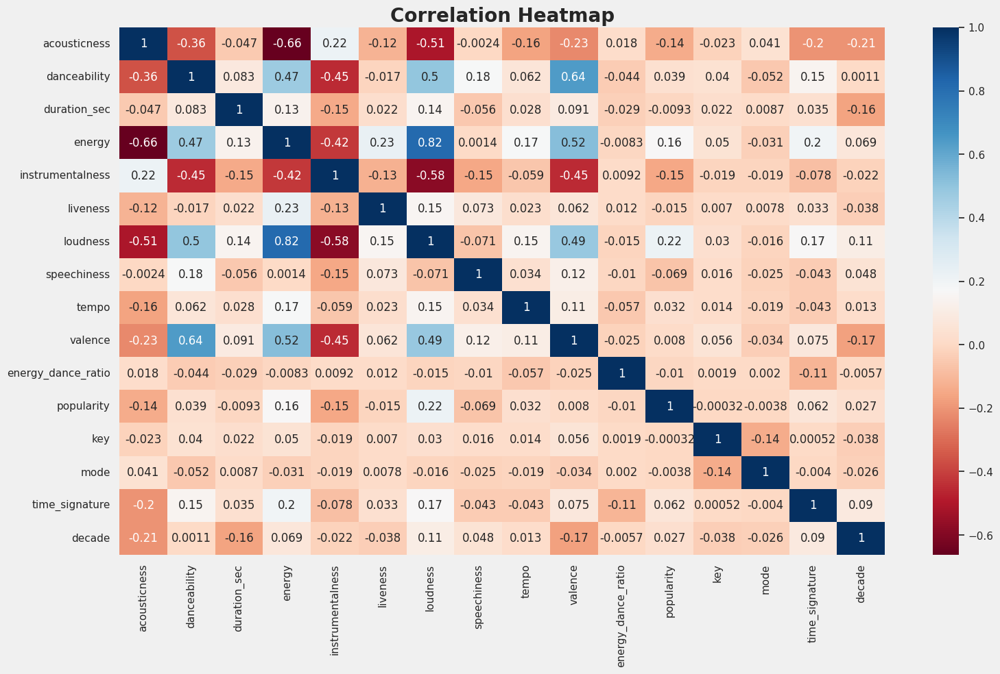

In [ ]:
columns = [ 'acousticness', 'danceability', 'duration_sec', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'energy_dance_ratio', 'popularity', 'key', 'mode', 'time_signature', 'decade']


plt.figure(figsize=(18, 10), facecolor='#f0f0f0')
sns.heatmap(spotify[columns].corr(method='pearson') , annot = True , cmap = 'RdBu')

plt.title('Correlation Heatmap', fontsize=20, fontweight='bold')
plt.show()

**INSIGHTS**

*   Energy vs loudness is strongly positive (≈0.82), so boosting production loudness reliably correlates with perceived energy; high-energy playlist candidates will also test loud in mixes.

*   The correlation between duration and popularity is essentially zero, so neither shorter nor longer songs are inherently more popular in this dataset.

*   Acousticness is strongly negative with energy (≈−0.66) and loudness (≈−0.51), indicating acoustic tracks skew softer/less energetic—position them for calm/focus products, not hype lists.

*   Danceability and popularity are nearly uncorrelated, indicating higher danceability does not systematically translate to higher popularity here.

*   Danceability links positively with energy (≈0.47) and valence (≈0.64), suggesting upbeat, danceable tracks also feel happier; use this triad to brand “feel‑good” playlists.

*   Energy shows a very weak positive correlation with popularity, meaning high‑energy tracks are only marginally more popular on average.

*   Instrumentalness is negatively correlated with energy (≈−0.42), danceability (≈−0.45), loudness (≈−0.58), and valence (≈−0.45), implying instrumentals are quieter, calmer, and less “happy”; prioritize them for study, ambient, and sync beds.

*   Loudness has a weak positive correlation with popularity, suggesting slightly louder mixes tend to perform a bit better, though the effect is small.

*   Valence has moderate positive ties with loudness (≈0.49) and energy (≈0.52), reinforcing that happier songs sound louder and more energetic; applicable for party/workout curation.

*   Acousticness has a weak negative correlation with popularity, implying more “organic/acoustic” tracks are modestly less popular than less acoustic/electronic ones on average.

*   Popularity shows weak correlations across features (highest ~0.22 with loudness), meaning hits are not driven by any single audio trait; promotion, timing, and artist brand likely dominate outcomes.

*   Tempo relationships are mild overall, with small positives to energy (≈0.17) and valence (≈0.11); tempo alone is a weak predictor—pair with danceability/energy for targeting.

*   Energy_dance_ratio correlations are near zero, signaling instability; treat this derived metric cautiously in modeling and consider winsorizing or alternative normalizations.

*   Structural tags (key, mode, time_signature, decade) have minimal correlation with popularity or mood proxies, so they are better for A&R guidance than hit prediction.

*   Feature collinearity to note for modeling: energy with loudness (high), acousticness with energy/loudness (high negatives), danceability with valence (moderate‑high); avoid redundant inputs or apply regularization.

###**B. Visualizations & Insights**

####**I. Popularity wise analysis**

*   Do more danceable tracks tend to be more popular?
*   Are energetic tracks more successful?
*   Do shorter or standard-length songs get more popularity?
*   Are songs recorded in a live setting generally more or less popular
than studio recordings?
*   How does popularity differ across
various musical keys (key) and modes (mode)?
*   Do specific time_signature values
correspond to a higher or lower average popularity?

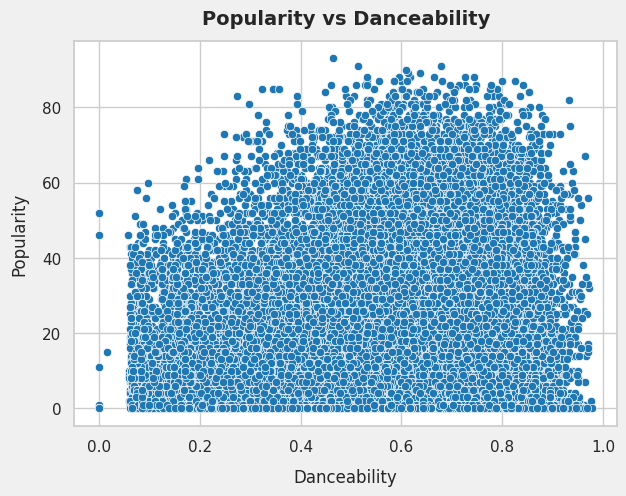

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="danceability", y="popularity", color = '#1f77b4')
plt.title("Popularity vs Danceability", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Danceability', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

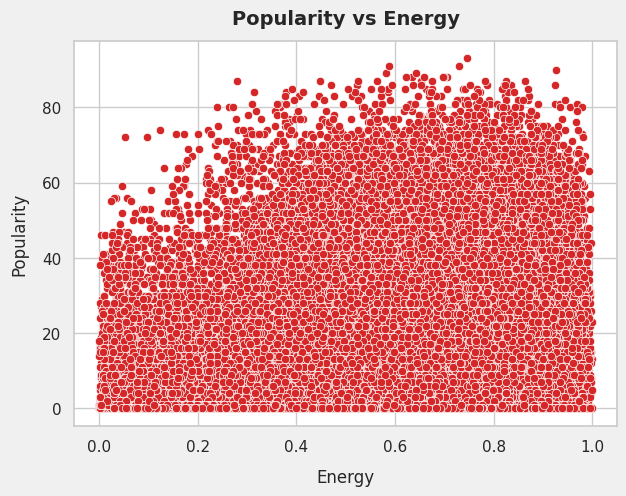

In [ ]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="energy", y="popularity", color = '#d62728')
plt.title("Popularity vs Energy", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Energy', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

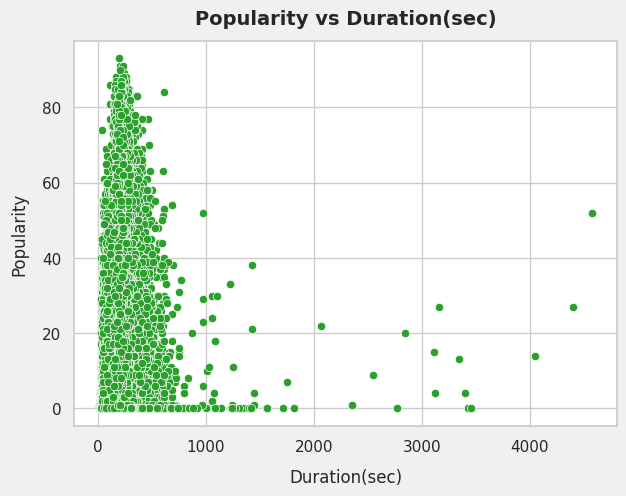

In [ ]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="duration_sec", y="popularity", color = '#2ca02c')
plt.title("Popularity vs Duration(sec)", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Duration(sec)', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

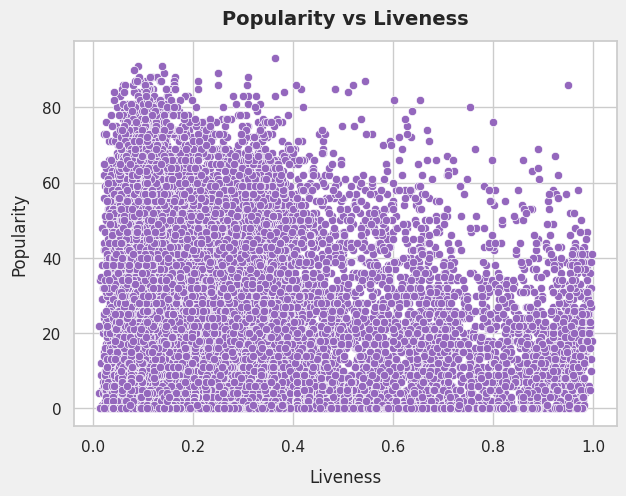

In [ ]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="liveness", y="popularity", color = '#9467bd')
plt.title("Popularity vs Liveness", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Liveness', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

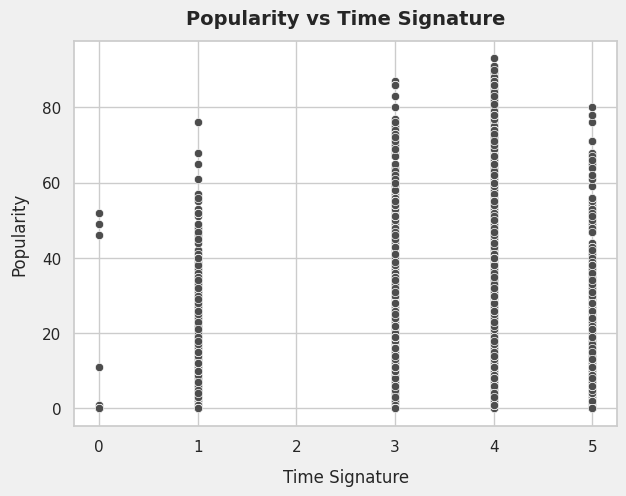

In [ ]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="time_signature", y="popularity", color = '#4d4d4d')
plt.title("Popularity vs Time Signature", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Time Signature', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

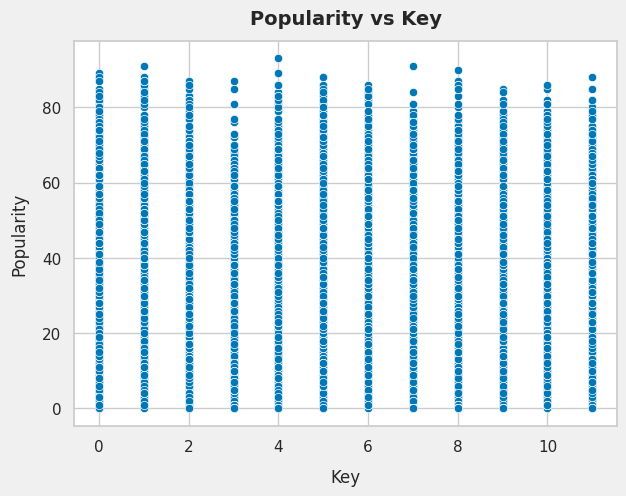

In [ ]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="key", y="popularity", color = '#0077b6')
plt.title("Popularity vs Key", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Key', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

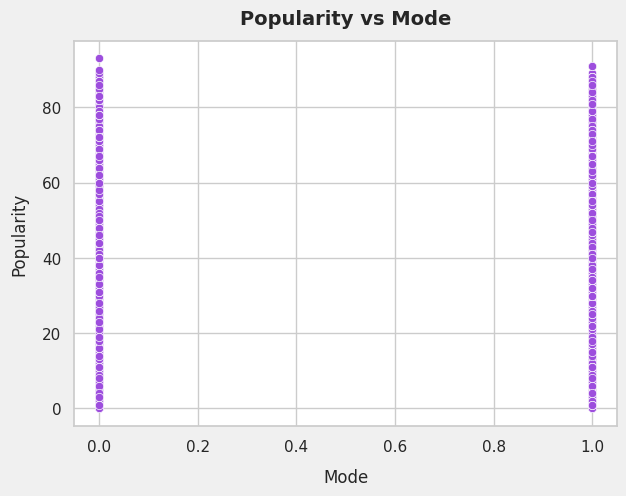

In [ ]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="mode", y="popularity", color = '#9d4edd')
plt.title("Popularity vs Mode", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Mode', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

**Insights**

*   **Popularity vs Energy :** The upper envelope slopes upward—higher energy levels host more of the top popularity points—yet the spread is wide at all energies, confirming only a weak positive relationship; energy helps but doesn’t determine hits.

*   **Popularity vs Duration :** High-popularity songs cluster around standard lengths (~2–4 minutes), while very long tracks rarely reach high popularity, indicating practical listening limits; duration beyond ~6–7 minutes correlates with lower hit likelihood.

*   **Popularity vs Danceability :** The densest high-popularity points sit in the mid‑to‑high danceability band (~0.4–0.8), but strong variance persists across the range, implying danceability is a supportive—but not decisive—factor.

*   **Liveness vs popularity :** Popular songs cluster at low-to-moderate liveness, and the density thins out as liveness increases—live‑leaning tracks tend to be less popular than studio‑style recordings on average.

*   **Time signature vs popularity :** 4/4 contains the largest band of higher‑popularity points, while other signatures (3, 5, etc.) also host successes but with thinner density—mainstream gains are most common in 4/4, though non‑4/4 can still produce hits.

*   **Key vs popularity :** Popularity is broadly spread across all keys with no clear winner, indicating musical key does not materially drive hit potential in this dataset.

*   **Mode vs popularity :** Both minor (0) and major (1) show similar popularity spreads, suggesting mode has negligible effect on average popularity.

####**II. Danceability wise analysis**

*   Are danceable songs also high in energy, or can they be chill but danceable?
*   Do danceable songs lean happier or darker moods?
*   At what tempos are songs most danceable (e.g., 120 BPM sweet spot)?

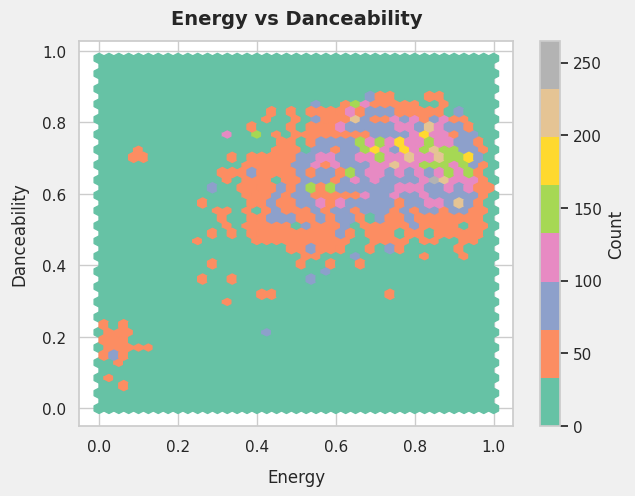

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["energy"], spotify["danceability"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Energy", fontsize = 12, labelpad = 10)
plt.ylabel("Danceability", fontsize = 12, labelpad = 10)
plt.title("Energy vs Danceability", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

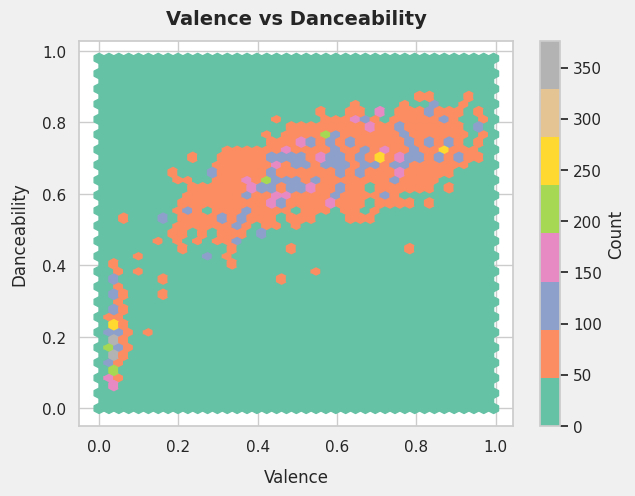

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["valence"], spotify["danceability"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Valence", fontsize = 12, labelpad = 10)
plt.ylabel("Danceability", fontsize = 12, labelpad = 10)
plt.title("Valence vs Danceability", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

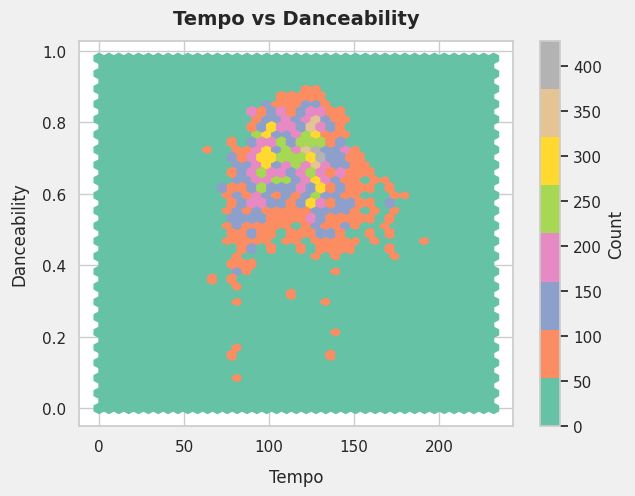

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["tempo"], spotify["danceability"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Tempo", fontsize = 12, labelpad = 10)
plt.ylabel("Danceability", fontsize = 12, labelpad = 10)
plt.title("Tempo vs Danceability", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

**Insights**


*   **Tempo vs danceability :** The densest cluster of highly danceable tracks sits around 100–130 BPM, with the hottest spot near roughly 110–125 BPM; outside this band, danceability is less concentrated, implying mid‑tempo grooves are the sweet spot for movement.

*   **Valence vs danceability :** Danceability rises with valence, forming an upward trend from low valence/low danceability to high valence/high danceability; happier songs tend to be easier to dance to, which is ideal for feel‑good playlist branding.

*   **Energy vs danceability :** The tightest concentration appears at mid‑to‑high energy (≈0.6–0.85) paired with mid‑to‑high danceability (≈0.55–0.8); extremely low energy underperforms on danceability, and ultra‑high energy doesn’t guarantee higher danceability, suggesting a balanced “energetic but not maximal” profile works best.

####**III. Energy wise analysis**

*   Loudness usually correlates with energy; check the strength of this relation.
*   Do spoken-word/high speechiness songs have lower energy?
*   Are live performances more energetic than studio versions?
*   Are acoustic songs less energetic by design?

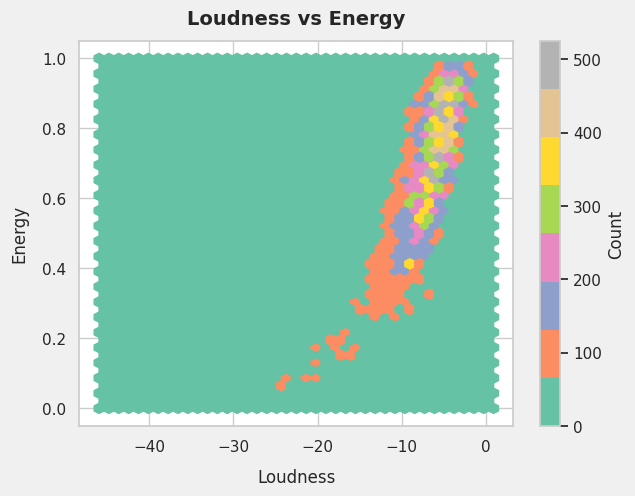

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["loudness"], spotify["energy"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Loudness", fontsize = 12, labelpad = 10)
plt.ylabel("Energy", fontsize = 12, labelpad = 10)
plt.title("Loudness vs Energy", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

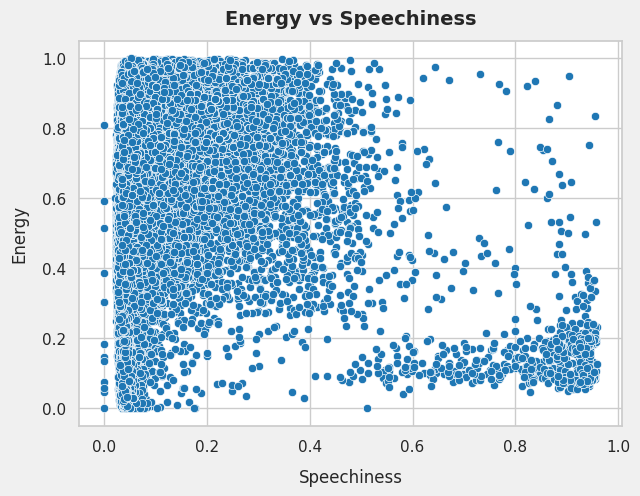

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="speechiness", y="energy", color = '#1f77b4')
plt.title("Energy vs Speechiness", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Speechiness', fontsize = 12, labelpad = 10)
plt.ylabel('Energy', fontsize = 12, labelpad = 10)
plt.show()

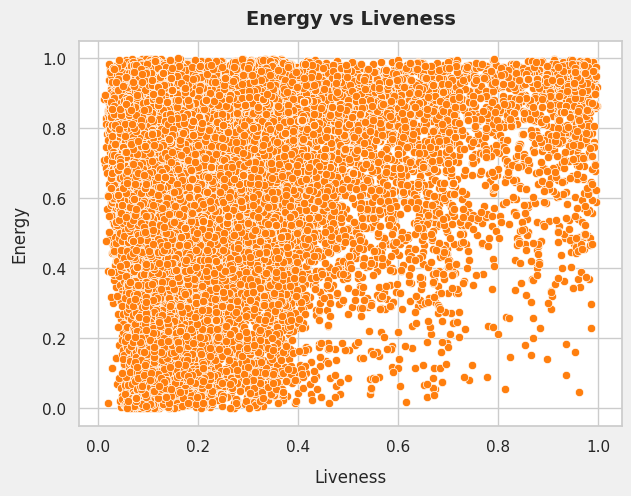

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="liveness", y="energy", color = '#ff7f0e')
plt.title("Energy vs Liveness", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Liveness', fontsize = 12, labelpad = 10)
plt.ylabel('Energy', fontsize = 12, labelpad = 10)
plt.show()

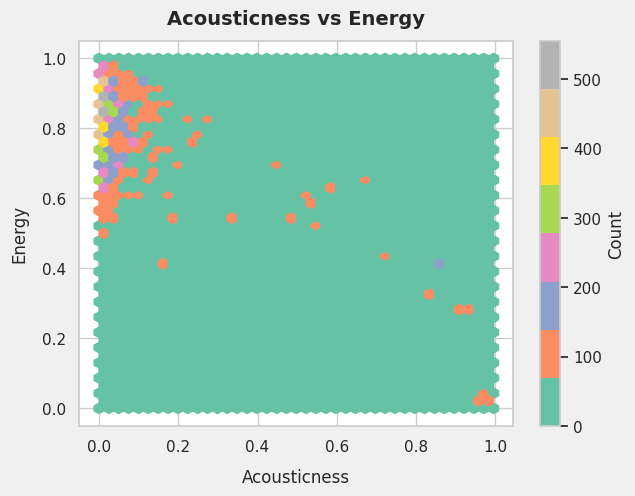

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["acousticness"], spotify["energy"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Acousticness", fontsize = 12, labelpad = 10)
plt.ylabel("Energy", fontsize = 12, labelpad = 10)
plt.title("Acousticness vs Energy", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

**Insights**

*   **Energy vs liveness :** High‑energy tracks cluster at low‑to‑mid liveness, and as liveness rises the density of energetic songs thins, indicating studio‑style production better sustains perceived energy than live‑leaning recordings.

*   **Energy vs speechiness :** Most high‑energy cuts sit at low speechiness, while higher speechiness bands are dominated by mid‑to‑low energy, suggesting spoken‑word/rap‑like segments generally reduce perceived energy except for niche outliers.

*   **Loudness vs energy :** There is a tight, upward diagonal—louder mixes map to higher energy almost linearly—reinforcing that mastering levels are a strong proxy for energy perception.

*   **Acousticness vs energy :** As acousticness increases, energy drops sharply, with the highest acoustic tracks clustering at very low energy; acoustic/organic recordings trend calm rather than intense.

####**IV. Valence wise analysis**

*    Are happy songs also high-energy, or can they be calm & positive?
*   Mood trends over decades?
*   How does a song's valence (its musical
positivity/mood) relate to its popularity? Do more cheerful or more
somber tracks tend to be more popular?

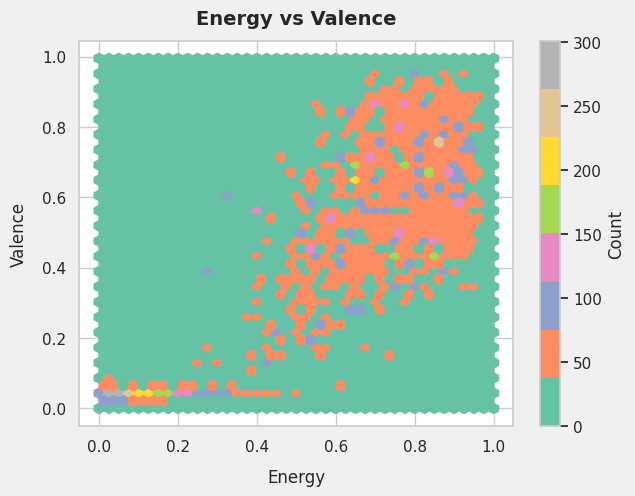

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["energy"], spotify["valence"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Energy", fontsize = 12, labelpad = 10)
plt.ylabel("Valence", fontsize = 12, labelpad = 10)
plt.title("Energy vs Valence", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

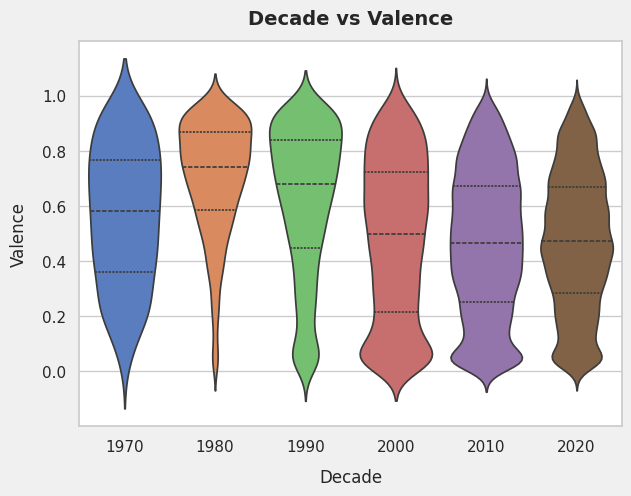

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.violinplot(data=spotify, x="decade", y="valence", palette="muted", inner="quartile")
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Valence", fontsize = 12, labelpad = 10)
plt.title("Decade vs Valence", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

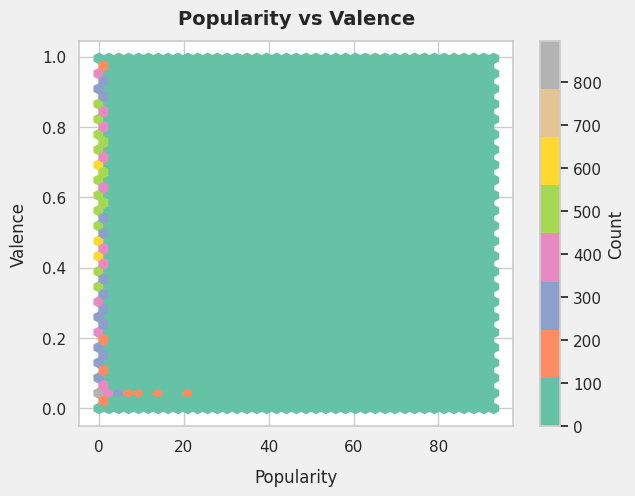

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["popularity"], spotify["valence"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Popularity", fontsize = 12, labelpad = 10)
plt.ylabel("Valence", fontsize = 12, labelpad = 10)
plt.title("Popularity vs Valence", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

**Insights**

*   **Energy vs valence :** There is a clear upward trend—higher energy aligns with higher valence—so energetic tracks tend to feel more positive, reinforcing the “feel‑good equals energetic” programming logic.

*   **Decade vs valence :** Earlier decades show wider mood spread, while recent decades center around mid valence with fewer extremes, indicating modern releases cluster toward balanced, neither-too-happy-nor-too-somber palettes for broader appeal.

*   **Popularity vs valence :** Popularity points are broadly distributed across the full valence range with no strong tilt toward very happy or very somber; at most, there is a slight concentration around mid‑to‑high valence, meaning cheerful songs may have a small edge, but mood alone does not determine hits.

####**V. Acousticness wise analysis**

*    Do acoustic songs overlap with instrumental tracks?
*    Has acoustic music declined in mainstream charts?
*   Are popular songs more electronic or acoustic?

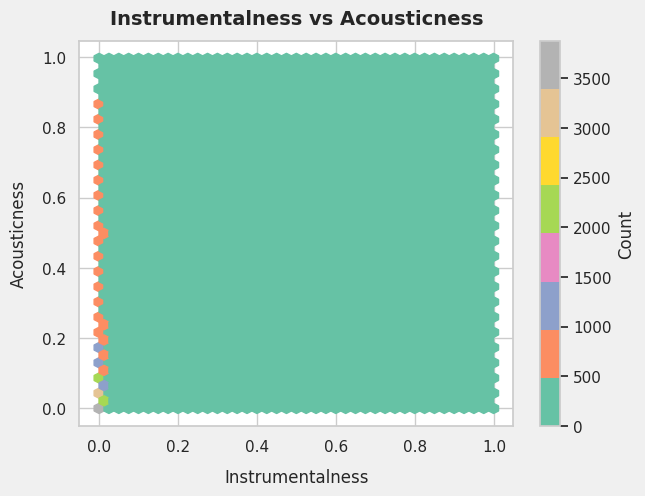

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["instrumentalness"], spotify["acousticness"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.ylabel("Acousticness", fontsize = 12, labelpad = 10)
plt.title("Instrumentalness vs Acousticness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

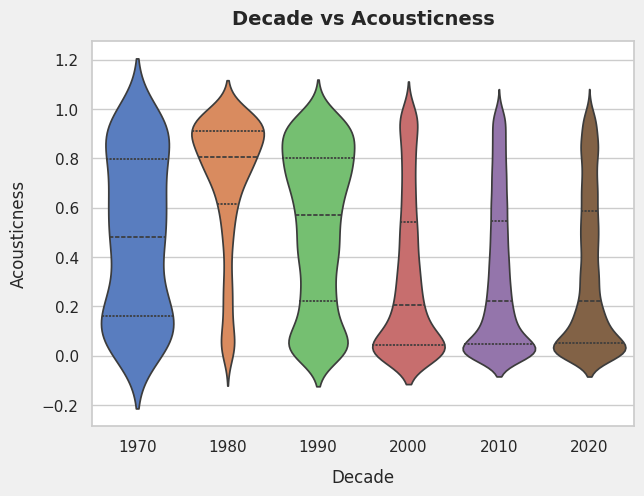

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.violinplot(data=spotify, x="decade", y="acousticness", palette="muted", inner="quartile")
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Acousticness", fontsize = 12, labelpad = 10)
plt.title("Decade vs Acousticness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

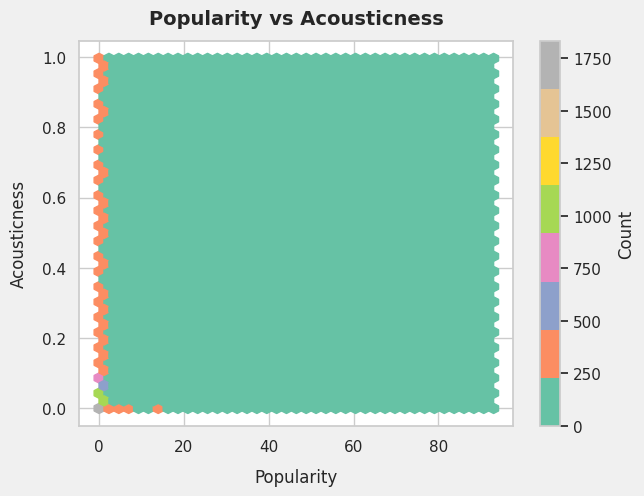

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["popularity"], spotify["acousticness"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Popularity", fontsize = 12, labelpad = 10)
plt.ylabel("Acousticness", fontsize = 12, labelpad = 10)
plt.title("Popularity vs Acousticness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

**Insights**

*   **Instrumentalness vs acousticness :** As acousticness increases, points concentrate more toward higher values while instrumentalness remains predominantly low, indicating most acoustic‑leaning tracks still contain vocals and true instrumentals are comparatively rare.

*   **Decade vs acousticness :** Older decades show broader and higher acousticness distributions, while 2000s onward cluster lower, confirming a shift toward more produced, less acoustic sound profiles in modern releases.

*   **Popularity vs acousticness :** Popularity is spread across the full acousticness range, but high counts sit in mid‑to‑low acousticness, supporting a slight preference for produced/electronic textures over purely acoustic ones.

####**VI. Instrumentalness wise analysis**

*    Is there a relationship between a track's instrumentalness and its popularity? (Does a lack of vocals impact a song's popularity?)
*   Are instrumentals happier or moodier on average?
*   Do instrumental tracks make good dance music?

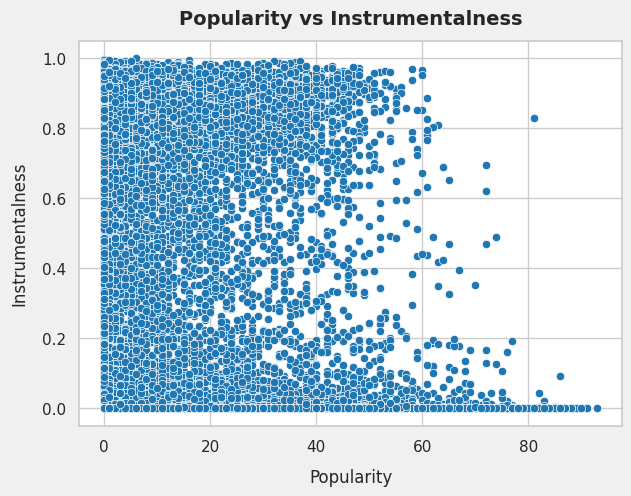

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="instrumentalness", color = '#1f77b4')
plt.xlabel("Popularity", fontsize = 12, labelpad = 10)
plt.ylabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.title("Popularity vs Instrumentalness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

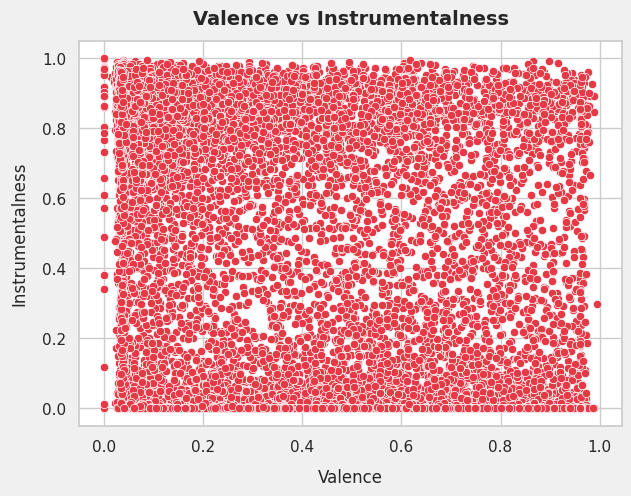

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="valence", y="instrumentalness", color = '#e63946')
plt.xlabel("Valence", fontsize = 12, labelpad = 10)
plt.ylabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.title("Valence vs Instrumentalness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

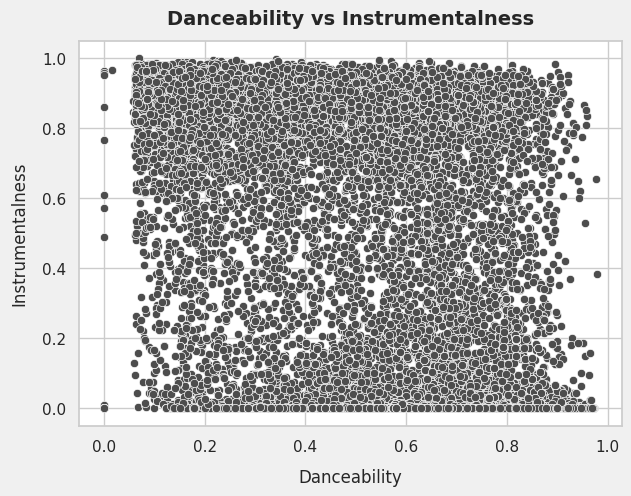

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="danceability", y="instrumentalness", color = '#4d4d4d')
plt.xlabel("Danceability", fontsize = 12, labelpad = 10)
plt.ylabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.title("Danceability vs Instrumentalness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

**Insights**

*   **Popularity vs instrumentalness :** Higher popularity clusters appear toward lower instrumentalness, and the density of very popular points thins as instrumentalness rises—tracks without vocals are generally less likely to be highly popular.

*   **Valence vs instrumentalness :** No strong directional pattern; instrumental pieces span the full mood spectrum, but mood alone doesn’t offset the popularity gap created by the absence of vocals.

*   **Danceability vs instrumentalness :** Danceability is spread across the instrumentalness range but with stronger concentration at lower instrumentalness, implying vocals/cohesive toplines aid movement cues and mainstream dance appeal.

####**VII. Tempo wise analysis**

*   What is the relationship between a song's
tempo and its popularity? (Are faster or slower songs typically
more popular?)
*   Does higher tempo always mean higher energy?

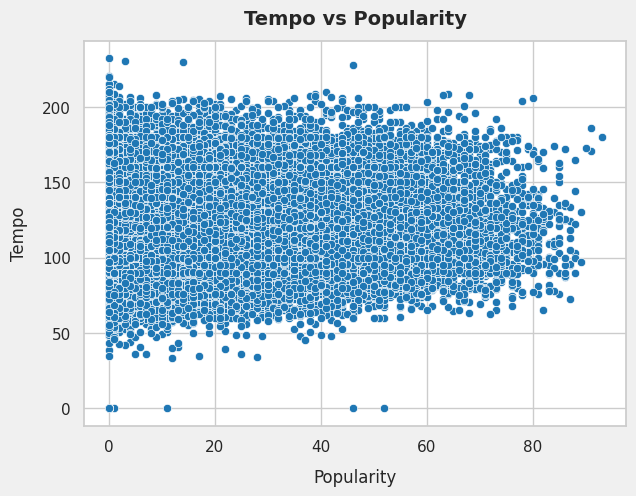

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="tempo", color = '#1f77b4')
plt.title("Tempo vs Popularity", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Popularity', fontsize = 12, labelpad = 10)
plt.ylabel('Tempo', fontsize = 12, labelpad = 10)
plt.show()

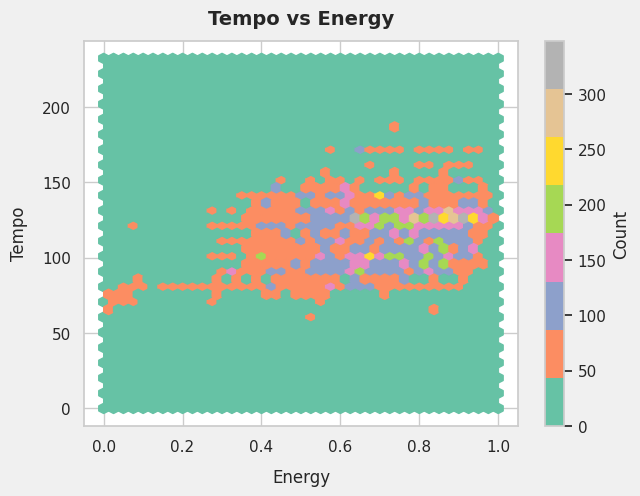

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["energy"], spotify["tempo"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.title("Tempo vs Energy", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Energy', fontsize = 12, labelpad = 10)
plt.ylabel('Tempo', fontsize = 12, labelpad = 10)
plt.show()

**Insights**

*   **Tempo vs Popularity :** Popular tracks occur across the full tempo range with no clear tilt toward faster or slower songs; popularity clusters where the catalog density is highest (roughly 90–140 BPM), indicating tempo alone doesn’t drive hits.
*   **Tempo vs Energy :** Energy rises with tempo up to a broad mid band; the densest, most energetic region sits around 90–140 BPM paired with mid‑to‑high energy, showing that pairing a moderate–fast tempo with solid intensity is the most common high‑energy recipe.

####**VIII. Loudness wise analysis**

*   Are louder songs more popular (loudness wars)?
*   Loudness evolution across decades (modern mastering = louder).

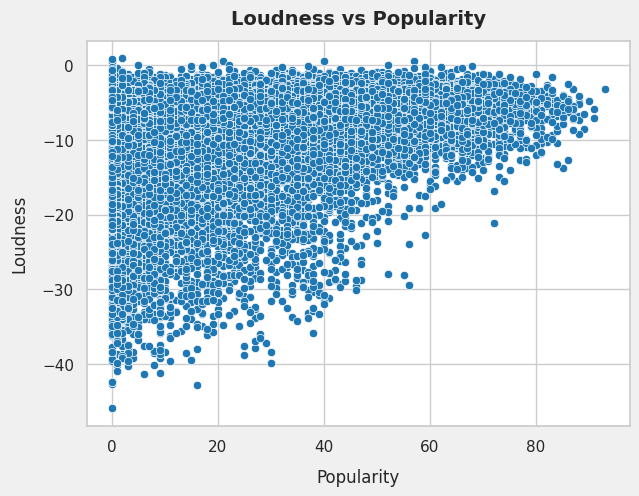

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="loudness", color = '#1f77b4')
plt.title("Loudness vs Popularity", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Popularity', fontsize = 12, labelpad = 10)
plt.ylabel('Loudness', fontsize = 12, labelpad = 10)
plt.show()

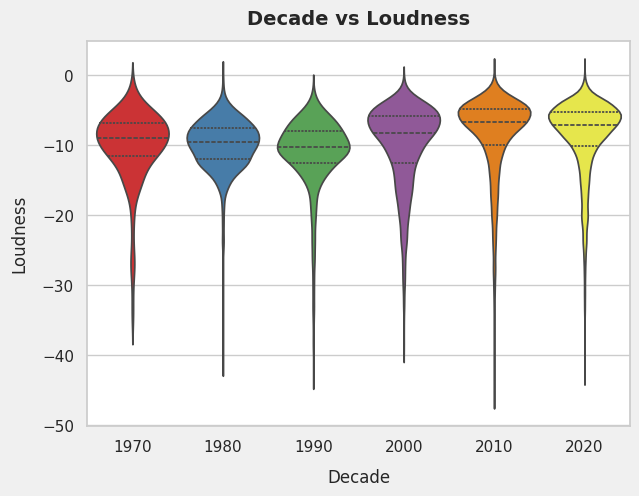

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.violinplot(data=spotify, x="decade", y="loudness", palette="Set1", inner="quartile")
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Loudness", fontsize = 12, labelpad = 10)
plt.title("Decade vs Loudness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

**Insights**

*   **Loudness vs popularity :** The upper boundary trends toward louder mixes as popularity increases—hits skew slightly less negative in LUFS—but the scatter remains broad, so loudness helps marginally without guaranteeing success.

*   **Decade vs loudness :** Median loudness steadily rises from earlier decades to 2020s (less negative dBFS), confirming the modern “loudness war” trend where contemporary masters are consistently louder than historical releases.

####**IX. Speechiness wise analysis**

*   Do rap/hip-hop (high speechiness) dominate charts vs lyrical/melodic tracks?
*    Rap vs dance songs — are spoken-word tracks danceable?

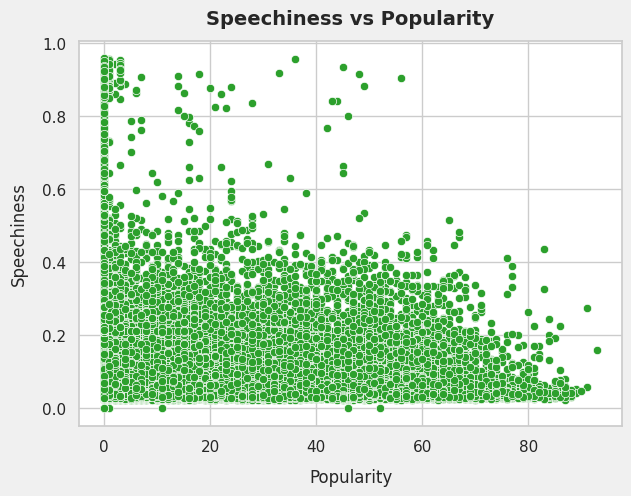

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="speechiness", color = '#2ca02c')
plt.title("Speechiness vs Popularity", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Popularity', fontsize = 12, labelpad = 10)
plt.ylabel('Speechiness', fontsize = 12, labelpad = 10)
plt.show()


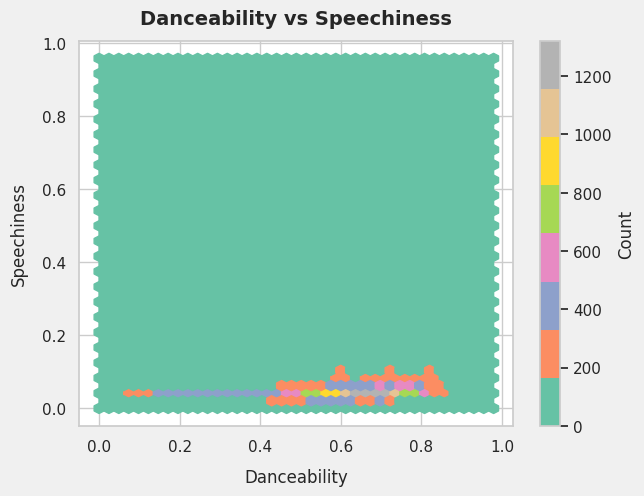

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["danceability"], spotify["speechiness"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Danceability", fontsize = 12, labelpad = 10)
plt.ylabel("Speechiness", fontsize = 12, labelpad = 10)
plt.title("Danceability vs Speechiness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

**Insights**

*   **Speechiness vs popularity :** As popularity increases, speechiness values compress toward very low levels, indicating mainstream hits tend to contain minimal spoken‑word content; high‑speechiness outliers exist but are uncommon among top tracks.

*   **Danceability vs speechiness :** The densest region of danceable songs aligns with very low speechiness, suggesting vocals structured for melody—not spoken delivery—better support movement and radio/club appeal.

####**X. Decade wise analysis**

*   How track length has evolved across decades.
*   Evolution of BPM trends.
*   Has the trend of what’s popular changed over decades?

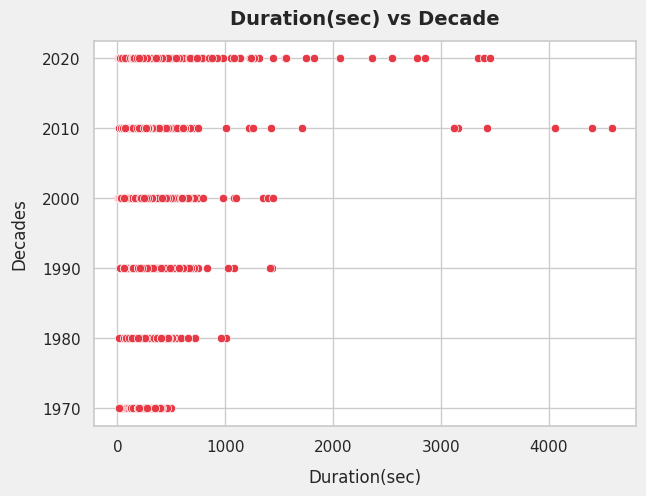

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="duration_sec", y="decade", color = '#e63946')
plt.xlabel("Duration(sec)", fontsize = 12, labelpad = 10)
plt.ylabel("Decades", fontsize = 12, labelpad = 10)
plt.title("Duration(sec) vs Decade", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

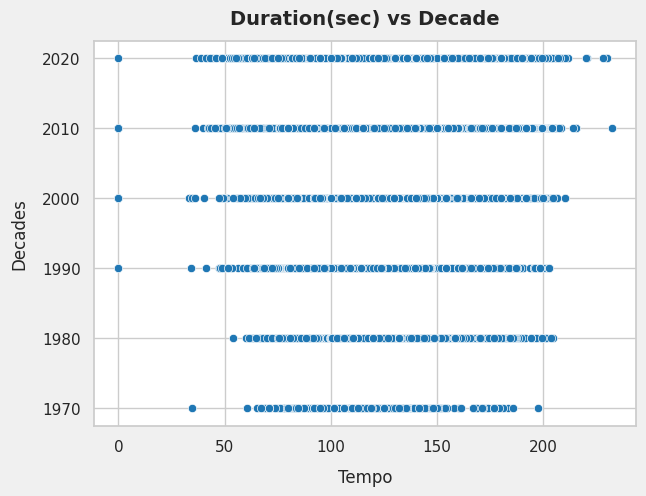

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="tempo", y="decade", color = '#1f77b4')
plt.xlabel("Tempo", fontsize = 12, labelpad = 10)
plt.ylabel("Decades", fontsize = 12, labelpad = 10)
plt.title("Duration(sec) vs Decade", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

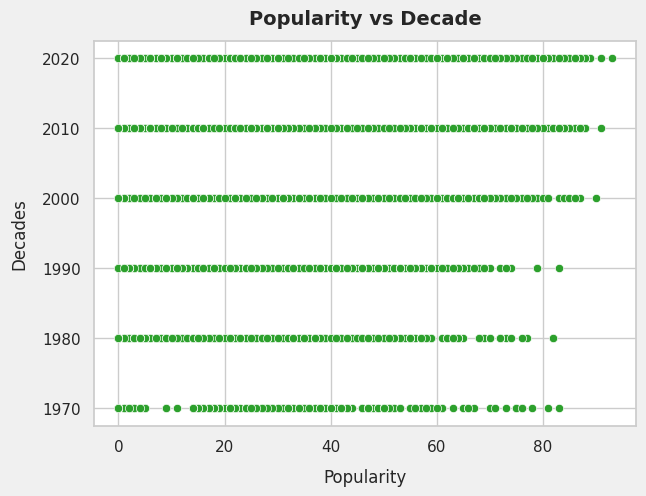

In [ ]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="decade", color = '#2ca02c')
plt.xlabel("Popularity", fontsize = 12, labelpad = 10)
plt.ylabel("Decades", fontsize = 12, labelpad = 10)
plt.title("Popularity vs Decade", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

**Insights**

*   **Duration vs decade :** Typical song lengths cluster around 2–4 minutes in every decade, with occasional long-form outliers more visible in recent years, indicating the standard radio-friendly duration persists over time.

*   **Tempo vs decade :** Common tempos sit in the ~90–140 BPM band across decades, with only sparse extremes, showing rhythmic norms are remarkably stable historically.

*   **Popularity vs decade :** High‑popularity points appear in every decade, but density is greatest in recent decades due to larger catalog volume, implying discovery advantage rather than an inherent recency popularity boost.

##**Numerical Vs Categorical variable**

###**I. Artist level analysis**

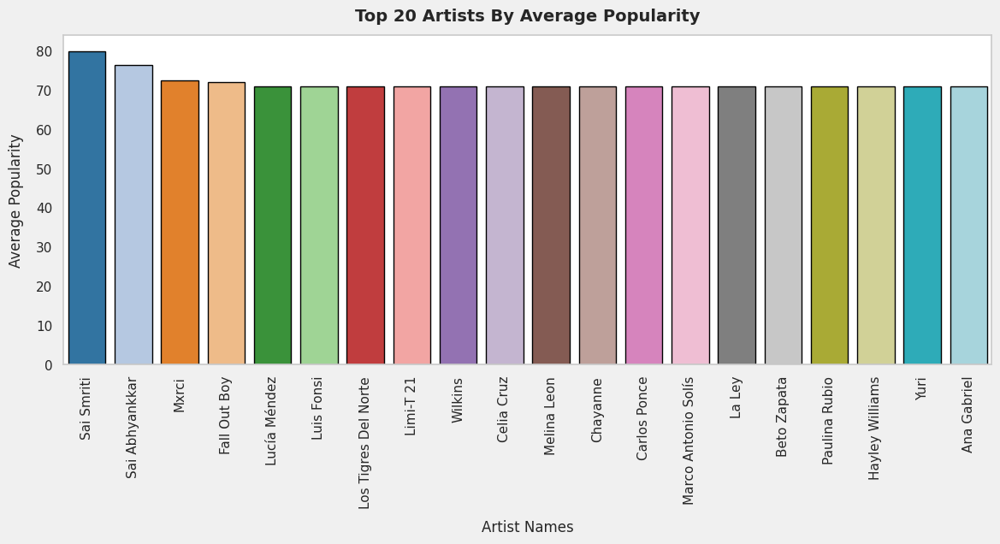

In [ ]:
top20_artists = spotify_artists.groupby('artist_name')['popularity'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Popularity',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Popularity', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

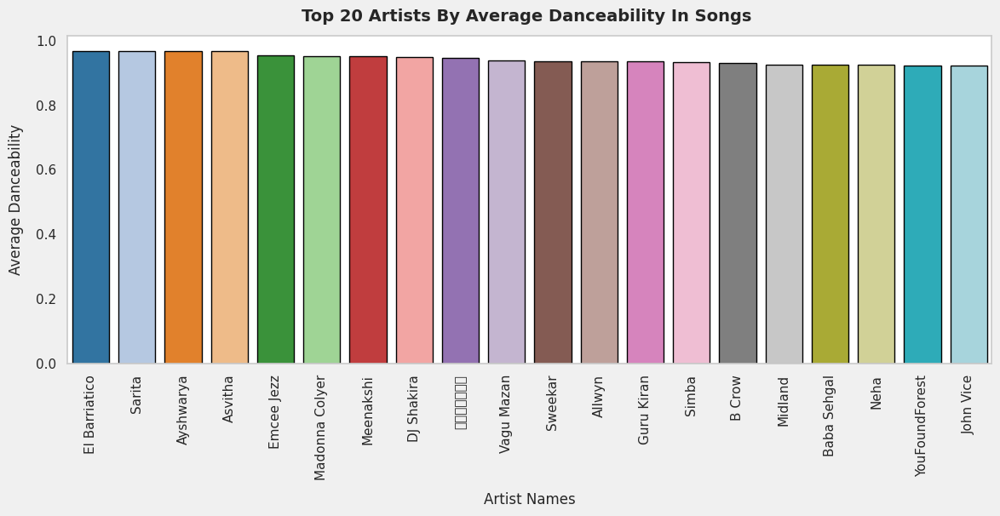

In [ ]:
top20_artists = spotify_artists.groupby('artist_name')['danceability'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Danceability In Songs ',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Danceability', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

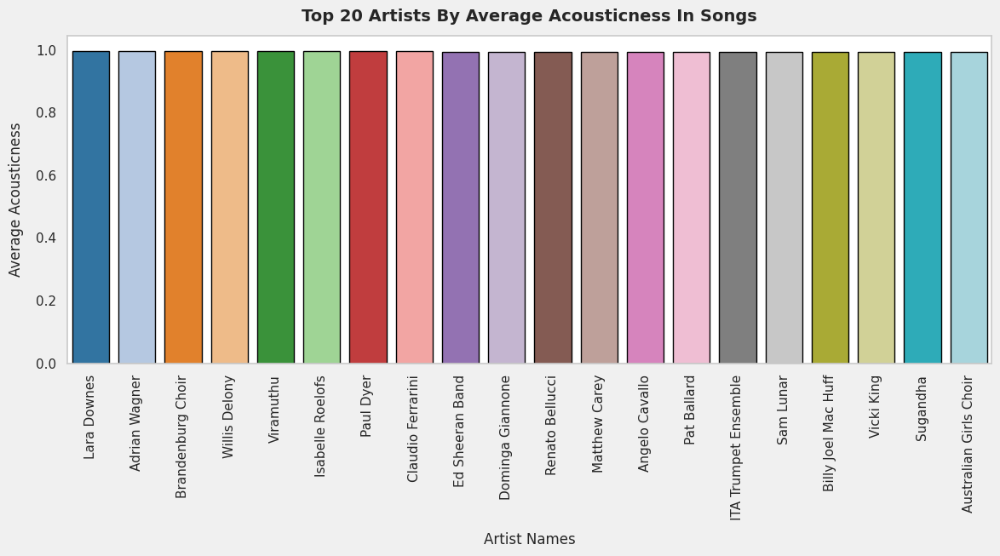

In [ ]:
top20_artists = spotify_artists.groupby('artist_name')['acousticness'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Acousticness In Songs',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Acousticness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

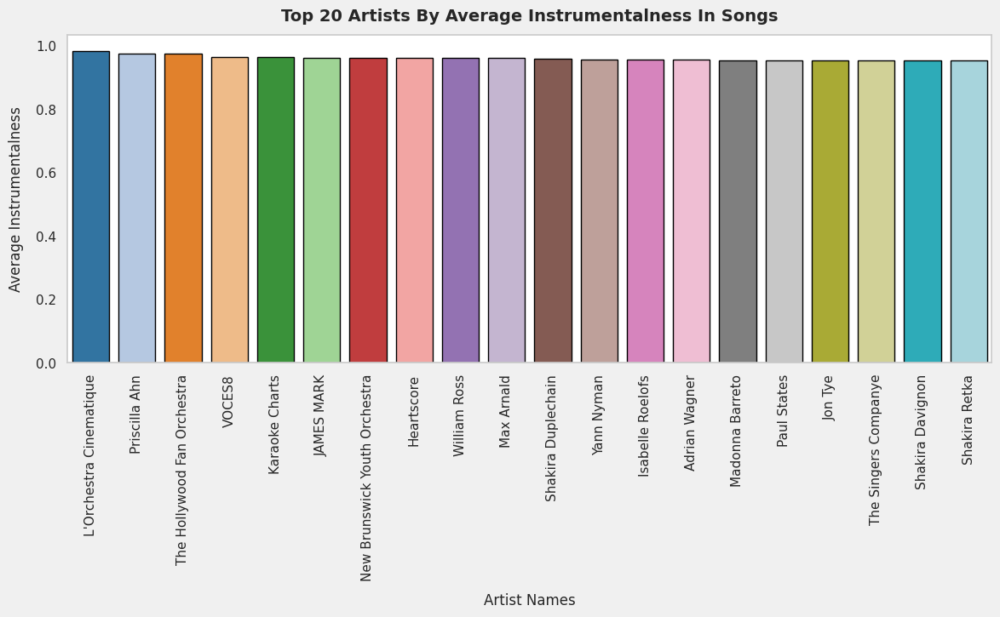

In [ ]:
top20_artists = spotify_artists.groupby('artist_name')['instrumentalness'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Instrumentalness In Songs',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Instrumentalness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

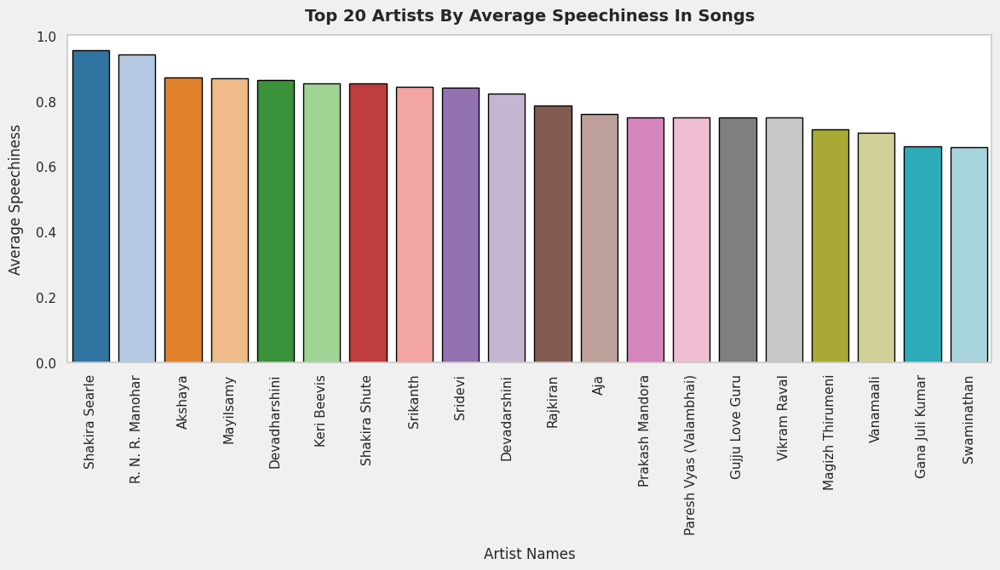

In [ ]:
top20_artists = spotify_artists.groupby('artist_name')['speechiness'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Speechiness In Songs',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Speechiness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

**Insights**


*   **Top 20 by average popularity :** The leaders cluster tightly in the low‑70s to ~80 range, indicating consistent audience pull rather than one‑off spikes; prioritize these artists for headline placements, re‑releases, and cross‑promos to compound dependable engagement.

*   **Top 20 by average danceability :** Nearly all sit above 0.92, making them plug‑and‑play for party/workout/club playlists; pair with mid‑to‑high energy tracks and mid‑tempo grooves to create reliable high‑movement sets and ad-friendly formats.

*   **Top 20 by average acousticness :** Values ≈0.98–1.00 show strongly organic recordings; package for unplugged/coffeehouse/editorial storytelling lanes and live‑session content where authenticity sells over loudness.

*   **Top 20 by average instrumentalness :** Scores near 0.95–0.99 confirm these catalogs are overwhelmingly instrumental; position them for focus, ambient, and sync products where vocals are not required, and bundle into long‑play experiences to maximize time‑spent.


*   **The top 20 by average speechiness :** Here artists have extremely high speechiness (≈0.7–1.0), indicating rap/spoken‑word–heavy catalogs that are ideal for hip‑hop and lyrical storytelling playlists, brand cyphers, and rhythm‑driven campaigns.

###**II. Album level analysis**

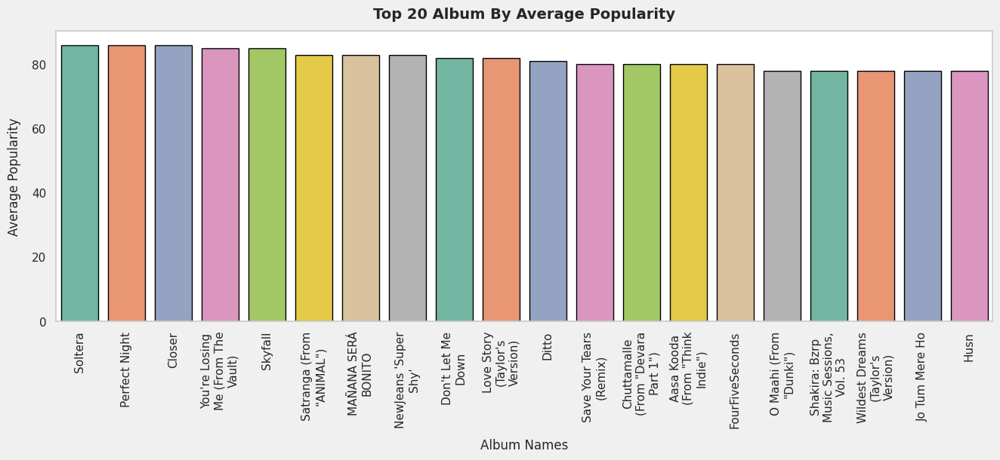

In [ ]:
import textwrap

top20_albums = (spotify.groupby('album_name')['popularity'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=15)) for x in top20_albums.index]

plt.figure(figsize=(16,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Album By Average Popularity', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Popularity', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

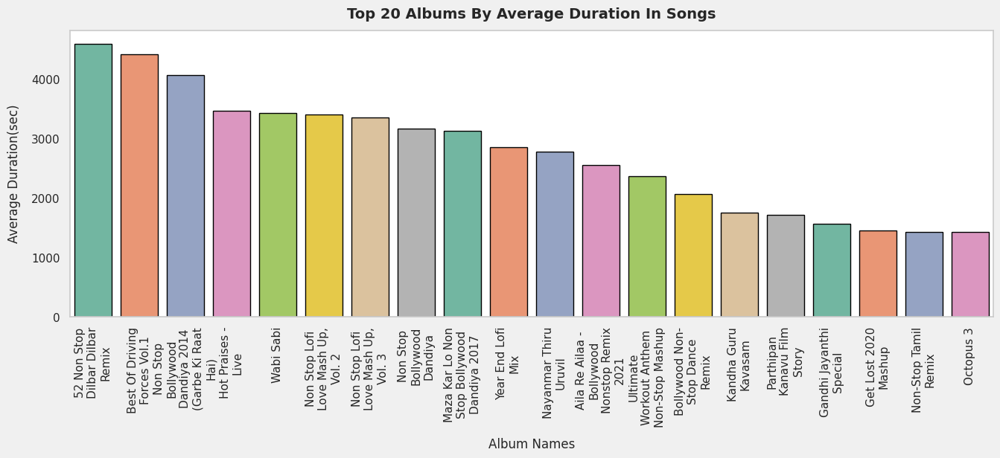

In [ ]:
top20_albums = (spotify.groupby('album_name')['duration_sec'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=15)) for x in top20_albums.index]

plt.figure(figsize=(16,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Duration In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Duration(sec)', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()


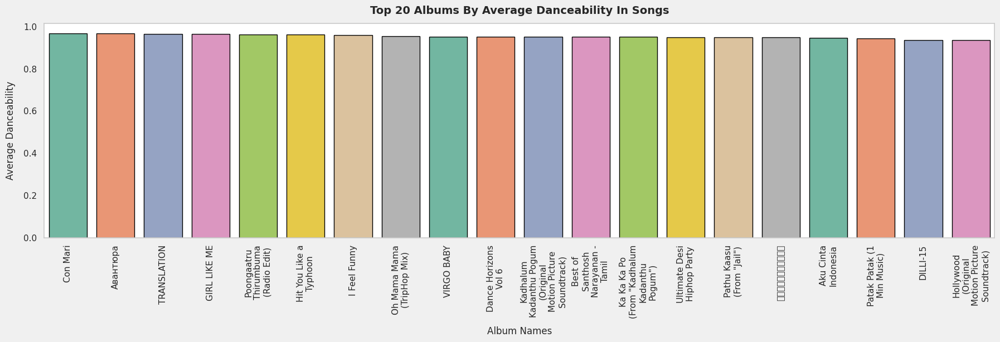

In [ ]:
top20_albums = (spotify.groupby('album_name')['danceability'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=15)) for x in top20_albums.index]

plt.figure(figsize=(22,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Danceability In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Danceability', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()


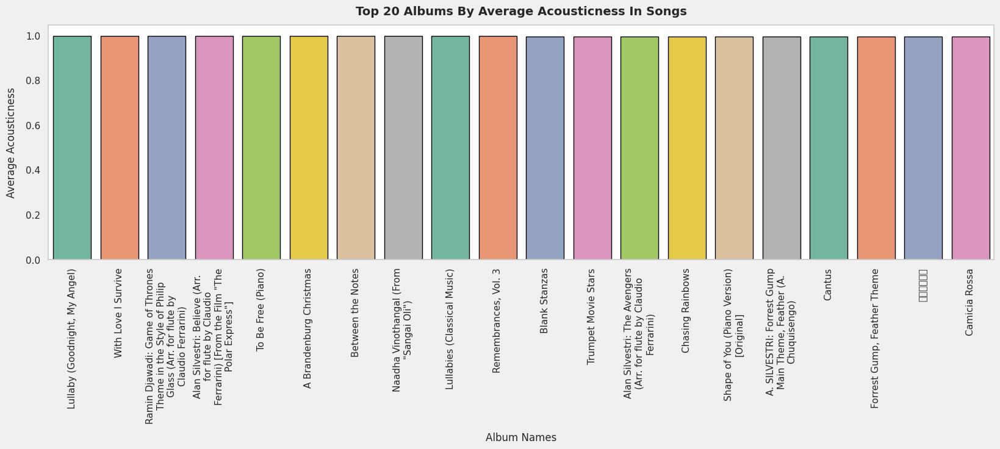

In [ ]:
top20_albums = (spotify.groupby('album_name')['acousticness'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=30)) for x in top20_albums.index]

plt.figure(figsize=(20,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Acousticness In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Acousticness', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

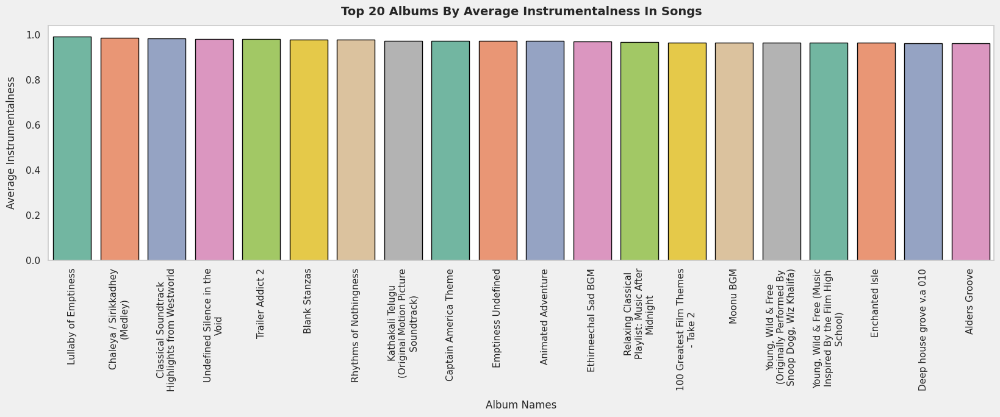

In [ ]:
top20_albums = (spotify.groupby('album_name')['instrumentalness'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=25)) for x in top20_albums.index]

plt.figure(figsize=(20,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Instrumentalness In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Instrumentalness', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

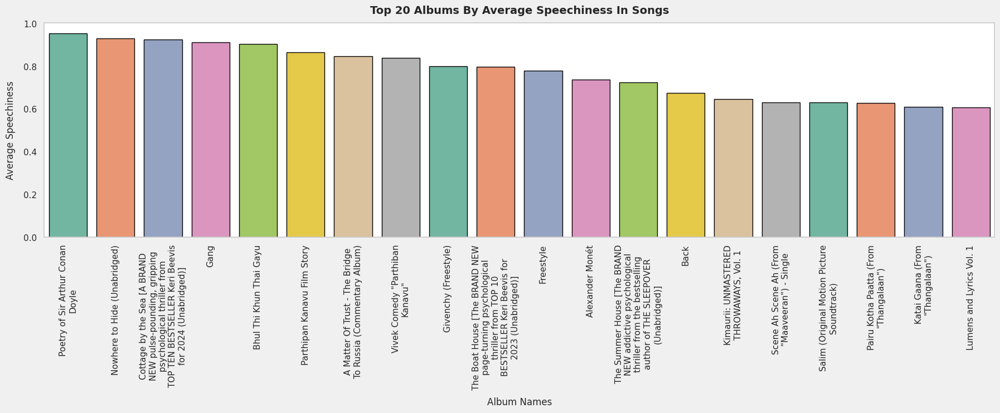

In [ ]:
top20_albums = (spotify.groupby('album_name')['speechiness'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=30)) for x in top20_albums.index]

plt.figure(figsize=(22,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Speechiness In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Speechiness', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

**Insights**

*  **Top albums by average popularity :** Scores concentrate in the low‑80s to high‑80s with a blend of English, Hindi, and K‑pop titles—strong cross-market appeal for featured carousels and new-user onboarding playlists.

*   **Top albums by duration :** The leaders are long, non‑stop mixes and mashups (≈2,400–4,600 seconds), ideal for continuous-play formats that maximize time‑spent and ad inventory.

*   **Top albums by danceability :** Values cluster around 0.94–0.97, mixing global pop, hip‑hop, and Tamil film tracks—ready-made sources for party/workout playlists and short‑form-friendly edits.

*   **Top albums by acousticness :** Nearly all entries sit at ~0.98–1.00 acousticness, dominated by piano, orchestral, lullaby, and film-score arrangements—prime candidates for focus, study, and “unplugged” editorial shelves.

*   **Top albums by instrumentalness :** Values cluster near 0.95–0.99 across film scores, classical sets, and ambient/electronic instrumentals—perfect for focus, cinematic, and sync‑friendly background playlists.

*   **Top albums by speechiness :** This list skews to audiobooks, commentary, and freestyle/rap projects with speechiness ~0.7–0.97, ideal for spoken‑word and lyrical storytelling shelves rather than music‑only playlists.

###**III. Language wise analysis**

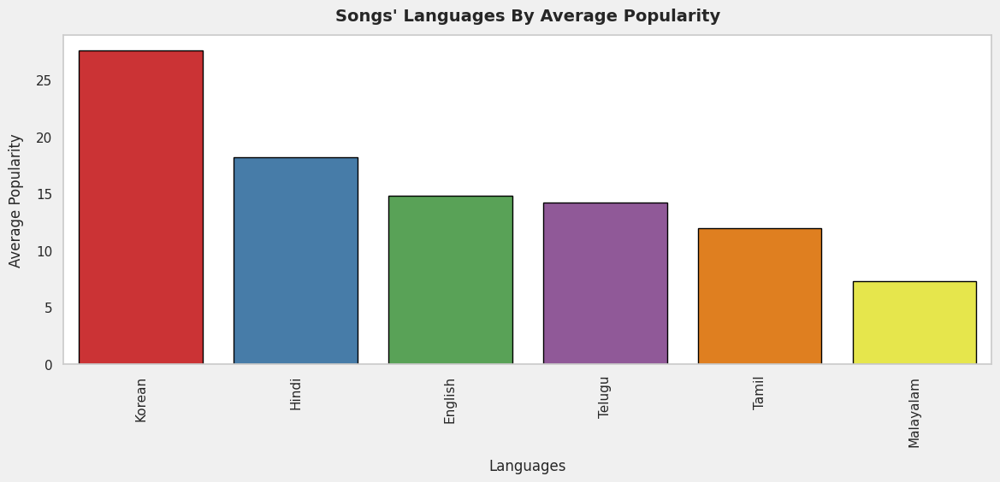

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['popularity'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Popularity',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Popularity', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

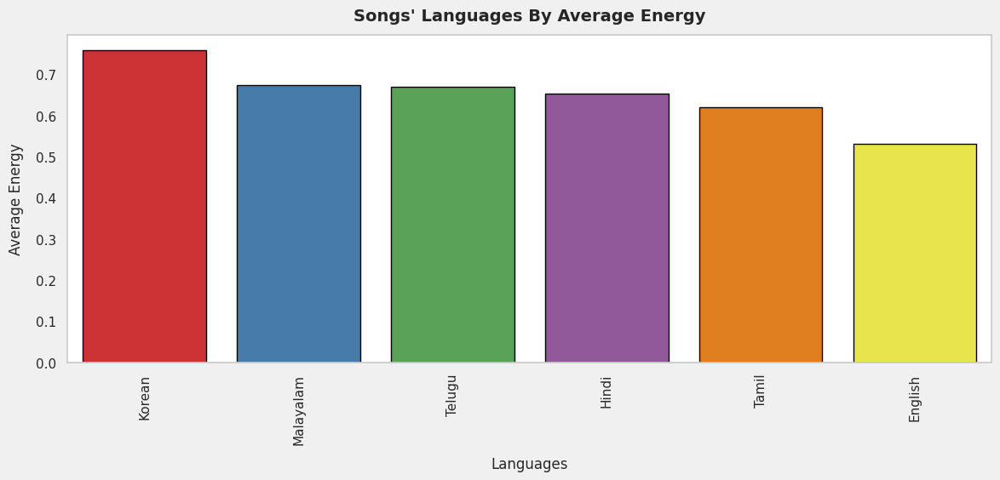

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['energy'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Energy',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Energy', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

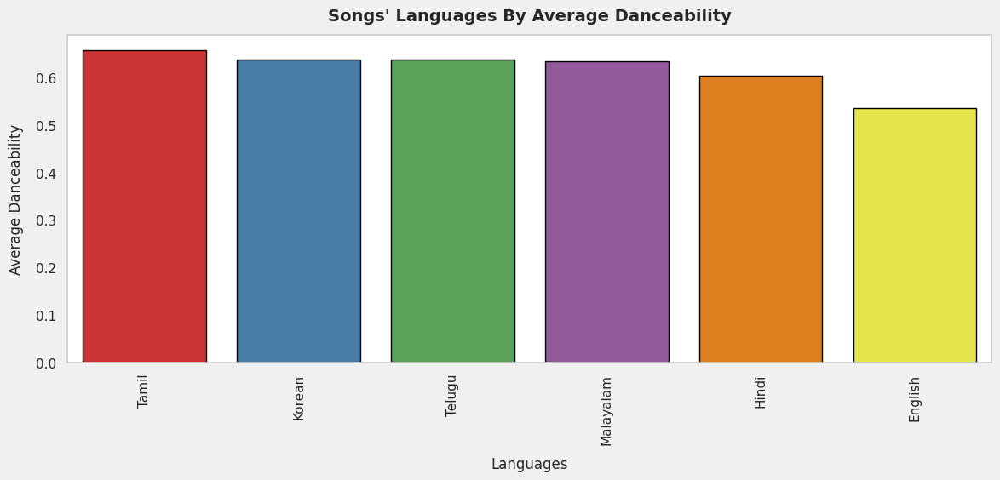

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['danceability'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Danceability',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Danceability', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

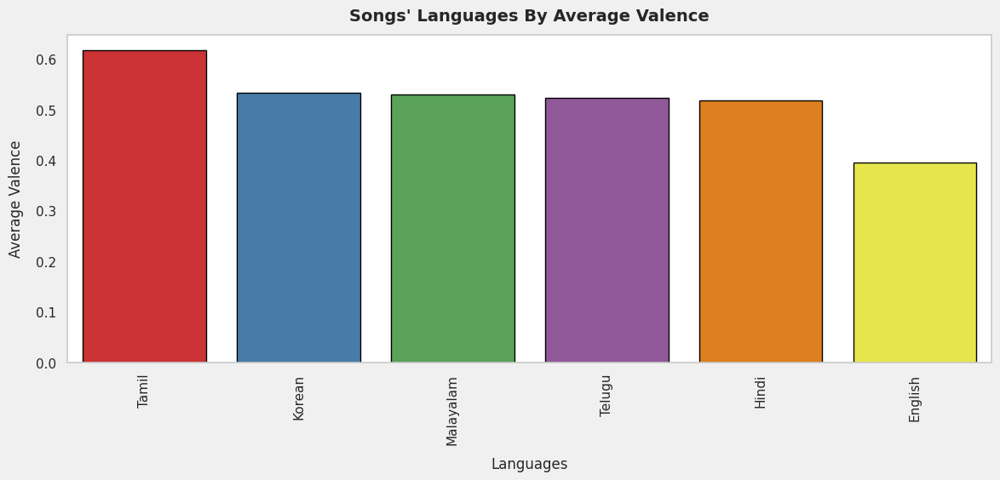

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['valence'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Valence',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Valence', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

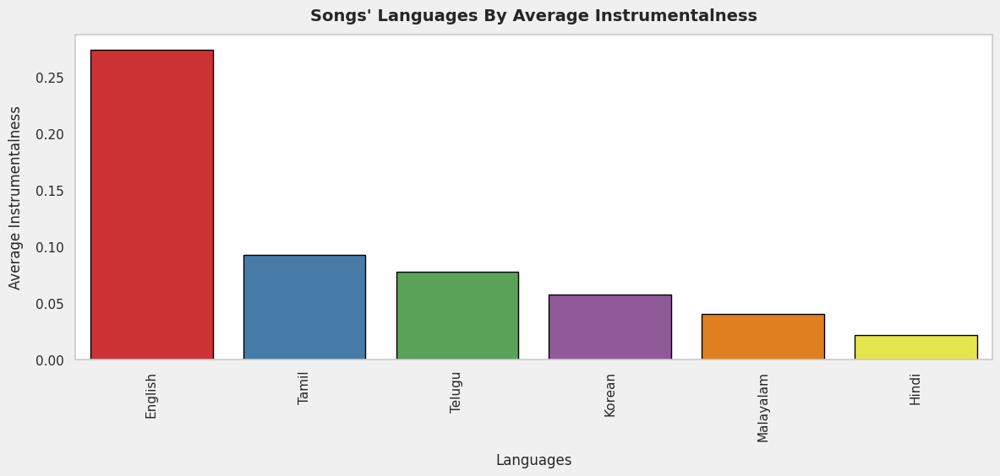

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['instrumentalness'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Instrumentalness',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Instrumentalness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

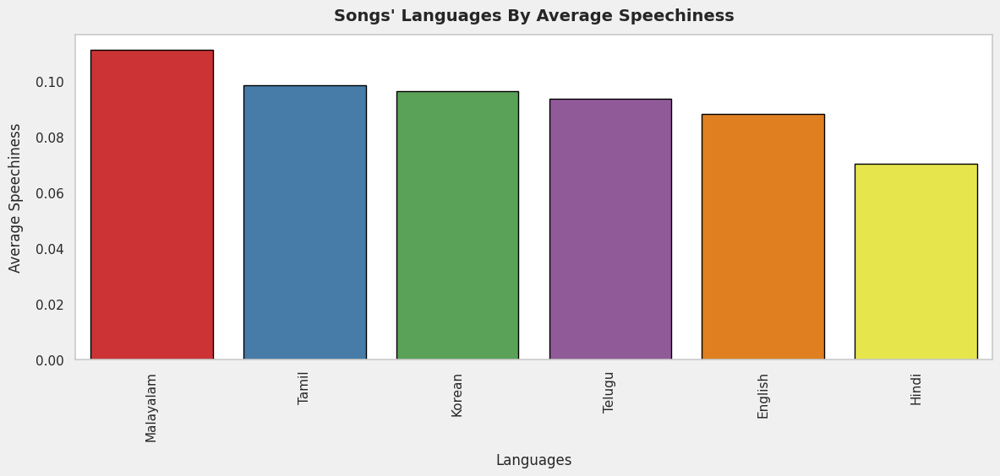

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['speechiness'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Speechiness',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Speechiness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

**Insights**

*   **Popularity by language :** Korean leads by a clear margin, followed by Hindi and English, with Telugu, Tamil, and Malayalam trailing—indicating current audience heat is strongest for Korean releases.

*   **Energy by language :** Korean tracks have the highest average energy, followed by Malayalam and Telugu, then Hindi and Tamil, with English the lowest—so high‑octane, hype‑ready selections are most abundant in Korean catalogs, while English skews comparatively mellow.

*   **Danceability by language :** High danceability maps to “party” songs; Tamil ranks highest, followed closely by Korean, Telugu, and Malayalam, while English is lowest.

*   **Valence by language :** Tamil shows the brightest mood profile, while Korean, Malayalam, Telugu, and Hindi sit mid; English trends lower, suggesting Tamil aligns best with “feel‑good” positioning.

*   **Instrumentalness by language :** English shows the highest average instrumentalness by a wide margin, indicating more instrumental or vocal‑light tracks in English catalogs; Hindi is the lowest, with Tamil/Telugu/Korean/Malayalam clustered at modest levels.

*   **Speechiness by language :** Malayalam tops average speechiness, with Tamil and Korean close behind, then Telugu and English, while Hindi is lowest—suggesting rap/spoken‑word prevalence is highest in Malayalam and Tamil, and least common in Hindi within this dataset.

###**IV. Analysis of Mood**

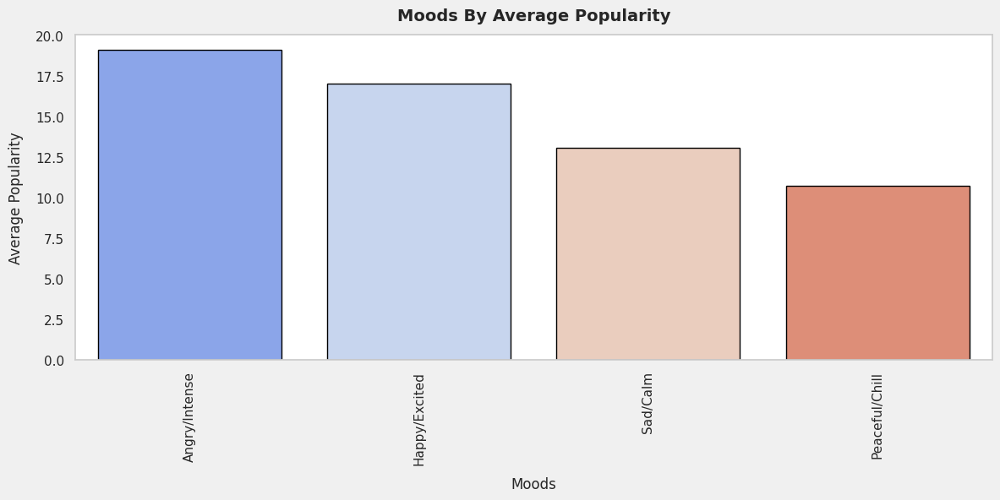

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['popularity'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Popularity',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Popularity', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

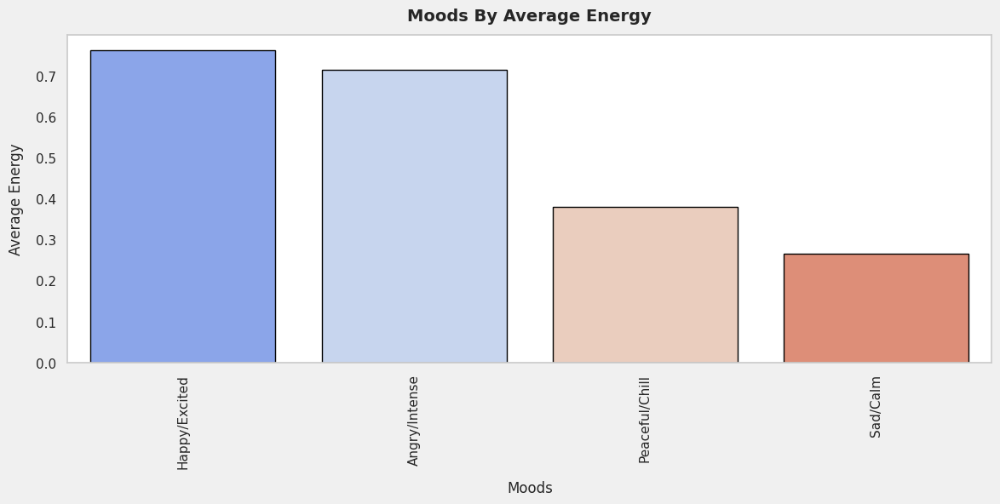

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['energy'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Energy',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Energy', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

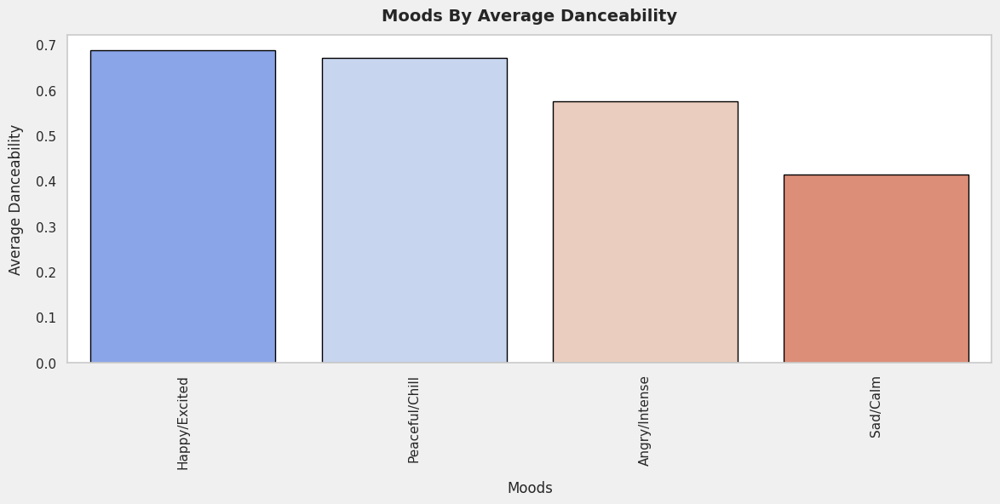

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['danceability'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Danceability',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Danceability', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

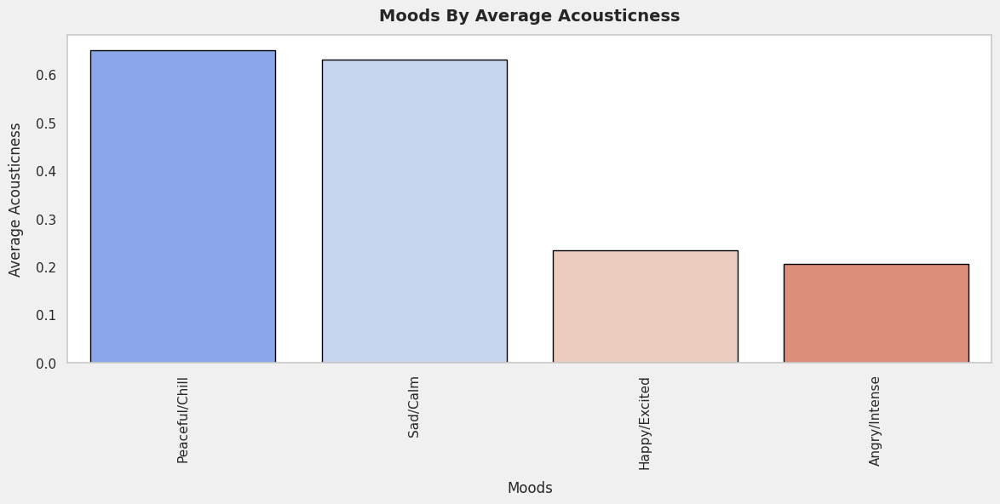

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['acousticness'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Acousticness',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Acousticness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

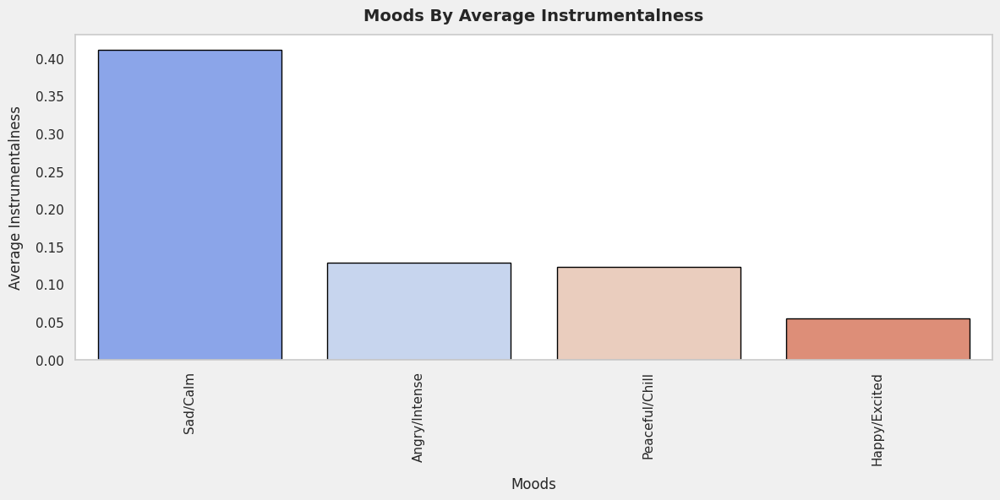

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['instrumentalness'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Instrumentalness',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Instrumentalness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

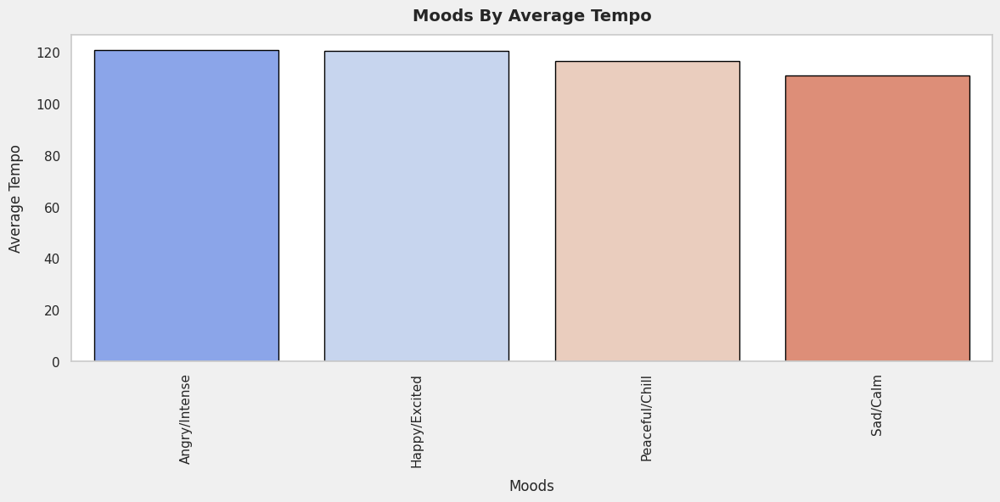

In [ ]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['tempo'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Tempo',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Tempo', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

**Insights**

*   **Popularity by mood :** Angry/Intense leads, then Happy/Excited, with Sad/Calm and Peaceful/Chill trailing—high‑arousal moods attract more average popularity in this dataset.

*   **Energy by mood :** Happy/Excited has the highest energy, Angry/Intense is slightly lower but still high, Peaceful/Chill is mid‑low, and Sad/Calm is lowest—confirming energy is a primary separator across moods.

*   **Danceability by mood :** Happy/Excited is most danceable and Peaceful/Chill is close behind, while Angry/Intense is moderate and Sad/Calm is lowest—party programming aligns best with Happy/Excited.

*   **Acousticness by mood :** Peaceful/Chill and Sad/Calm are highly acoustic, whereas Angry/Intense and Happy/Excited are low on acousticness—organic textures map to calm moods, processed/electric textures to energetic moods.

*   **Instrumentalness by mood :** Sad/Calm is markedly more instrumental than other moods, while Happy/Excited is the least—vocals drive upbeat tracks, whereas calmer pieces lean instrumental.

*  **Tempo by mood :** Angry/Intense and Happy/Excited sit around ~120 BPM, Peaceful/Chill slightly lower, and Sad/Calm the slowest—tempo aligns with arousal but differences are modest versus energy gaps.

##**Categorical Vs Categorical variable**

###**I. Artist level analysis**

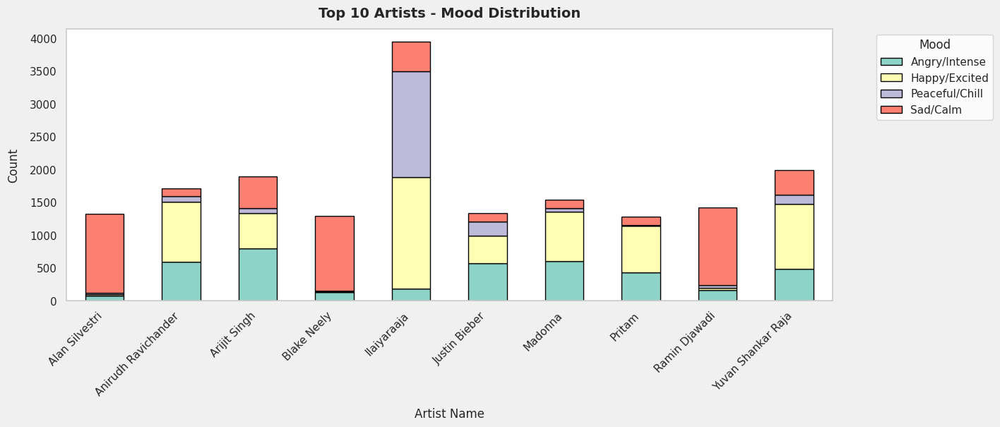

In [ ]:
top_artists = spotify_artists['artist_name'].value_counts().head(10).index
artist_mood = spotify_artists[spotify_artists['artist_name'].isin(top_artists)]

# Create crosstab for stacked bar
artist_mood_ct = pd.crosstab(artist_mood['artist_name'], artist_mood['mood'])

# Plot stacked bar
artist_mood_ct.plot(kind='bar', stacked=True, figsize=(14,5), color=sns.color_palette("Set3", len(artist_mood_ct.columns)), edgecolor='black')

plt.title("Top 10 Artists - Mood Distribution", pad = 12, fontsize=14, fontweight='bold')
plt.xlabel("Artist Name", fontsize=12, labelpad = 10)
plt.ylabel("Count", fontsize=12, labelpad = 10)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Mood", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.gcf().set_facecolor('#f0f0f0')
plt.grid(False)
plt.show()

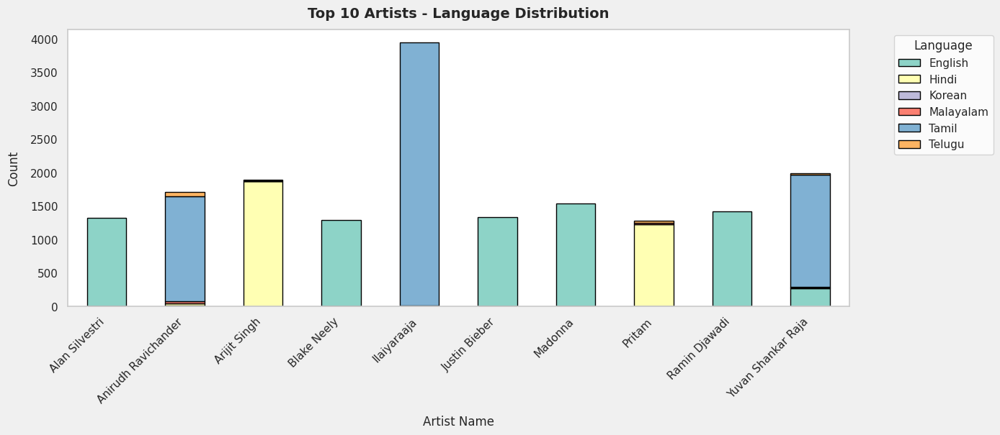

In [ ]:
top_artists = spotify_artists['artist_name'].value_counts().head(10).index
artist_mood = spotify_artists[spotify_artists['artist_name'].isin(top_artists)]

# Create crosstab for stacked bar
artist_mood_ct = pd.crosstab(artist_mood['artist_name'], artist_mood['language'])

# Plot stacked bar
artist_mood_ct.plot(kind='bar', stacked=True, figsize=(14,5), color=sns.color_palette("Set3", len(artist_mood_ct.columns)), edgecolor='black')

plt.title("Top 10 Artists - Language Distribution", pad = 12, fontsize=14, fontweight='bold')
plt.xlabel("Artist Name", fontsize=12, labelpad = 10)
plt.ylabel("Count", fontsize=12, labelpad = 10)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Language", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.gcf().set_facecolor('#f0f0f0')
plt.grid(False)
plt.show()

**Insights**

*   **Mood mix across top artists :** Film composers like Ilaiyaraaja and Ramin Djawadi show large Peaceful/Chill and Sad/Calm shares alongside Happy/Excited, reflecting score diversity, while pop acts (Justin Bieber, Madonna) lean Happy/Excited and Angry/Intense; Arijit and Pritam balance Angry/Intense with Happy/Excited for mainstream Bollywood curation.

*   **Language mix across top artists :** The distribution is highly segmented by market—Ilaiyaraaja and Yuvan Shankar Raja skew heavily Tamil, Arijit Singh and Pritam are predominantly Hindi, and Alan Silvestri, Blake Neely, Justin Bieber, Madonna, and Ramin Djawadi are English-led—so editorial should localize by artist rather than assuming cross-language breadth.

###**II. Album level analysis**

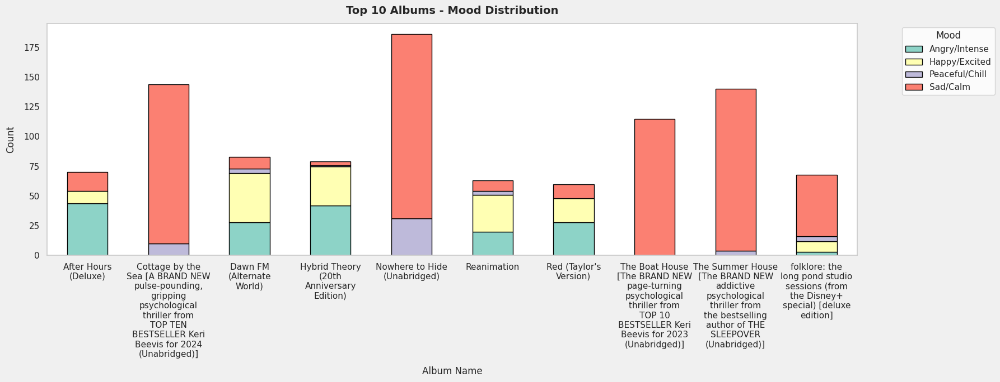

In [ ]:
top_artists = spotify['album_name'].value_counts().head(10).index
artist_mood = spotify[spotify['album_name'].isin(top_artists)]
artist_mood_ct = pd.crosstab(artist_mood['album_name'], artist_mood['mood'])

# Wrap album names in the index (same style as the reference barplot)
wrap_width = 16.5
wrapped_idx = ["\n".join(textwrap.wrap(str(x), width=wrap_width)) for x in artist_mood_ct.index]

# Reindex with wrapped labels for plotting only
plot_df = artist_mood_ct.copy()
plot_df.index = wrapped_idx

# Plot stacked bar with wrapped labels
ax = plot_df.plot(
    kind='bar', stacked=True, figsize=(18,7),
    color=sns.color_palette("Set3", len(plot_df.columns)),
    edgecolor='black'
)

plt.title("Top 10 Albums - Mood Distribution", pad=12, fontsize=14, fontweight='bold')
plt.xlabel("Album Name", fontsize=12, labelpad=10)
plt.ylabel("Count", fontsize=12, labelpad=10)
plt.xticks(rotation=0, ha="center")
plt.legend(title="Mood", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.gcf().set_facecolor('#f0f0f0')
plt.grid(False)
plt.tight_layout()
plt.show()


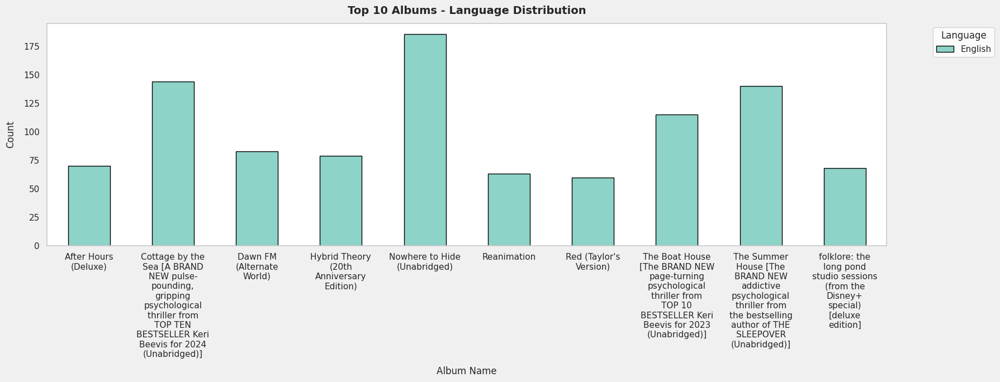

In [ ]:
# Compute top 10 albums and crosstab
top_artists = spotify['album_name'].value_counts().head(10).index
artist_mood = spotify[spotify['album_name'].isin(top_artists)]
artist_mood_ct = pd.crosstab(artist_mood['album_name'], artist_mood['language'])

# Wrap album names in the index (same approach as the reference example)
wrap_width = 15
wrapped_idx = ["\n".join(textwrap.wrap(str(x), width=wrap_width)) for x in artist_mood_ct.index]

# Use a copy with wrapped index for plotting
plot_df = artist_mood_ct.copy()
plot_df.index = wrapped_idx

# Plot stacked bar with wrapped labels
ax = plot_df.plot(
    kind='bar', stacked=True, figsize=(18,7),
    color=sns.color_palette("Set3", len(plot_df.columns)),
    edgecolor='black'
)

plt.title("Top 10 Albums - Language Distribution", pad=12, fontsize=14, fontweight='bold')
plt.xlabel("Album Name", fontsize=12, labelpad=10)
plt.ylabel("Count", fontsize=12, labelpad=10)
plt.xticks(rotation=0, ha="center")
plt.legend(title="Language", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.gcf().set_facecolor('#f0f0f0')
plt.grid(False)
plt.tight_layout()
plt.show()


**Insights**

*   **Mood distribution across top albums :** Several titles are dominated by Sad/Calm cuts, especially audiobook-style entries and reflective sessions, while pop/alt albums mix Happy/Excited with some Angry/Intense; only a few show meaningful Peaceful/Chill segments, so mood targeting should differ by album intent.

*   **Language distribution across top albums :** The set is entirely English, indicating that this “top albums” slice is English-led; localization needs will center on mood/context rather than language switching for these specific albums.

###**III. Language wise analysis**

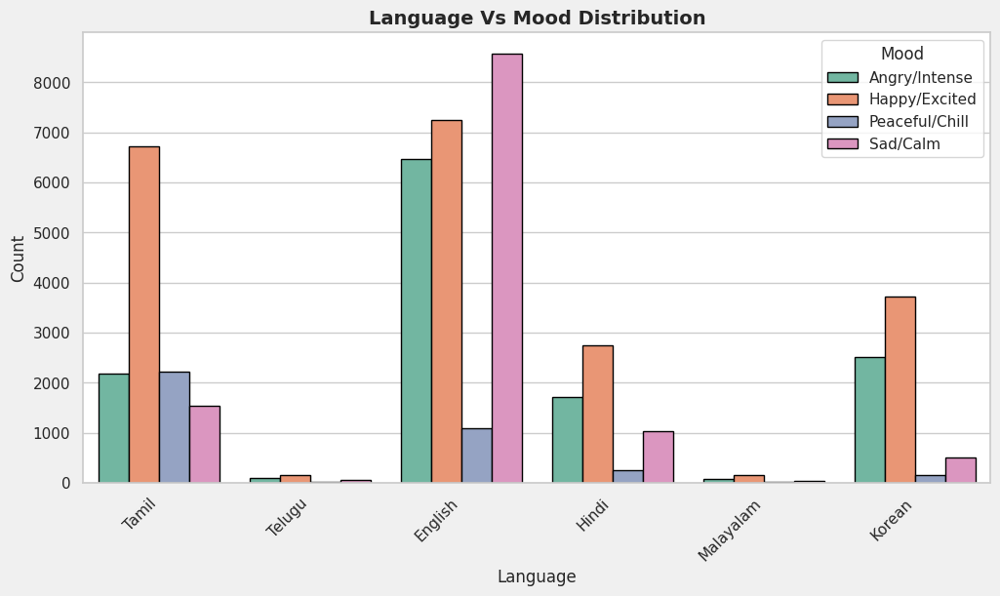

In [ ]:
# Grouped bar: count of moods per artist
plt.figure(figsize=(12,6), facecolor='#f0f0f0')
sns.countplot(data=spotify, x='language', hue='mood', palette='Set2', edgecolor='black')

plt.title("Language Vs Mood Distribution", fontsize=14, fontweight='bold')
plt.xlabel("Language", fontsize=12)
plt.ylabel("Count", fontsize=12)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Mood")
plt.show()


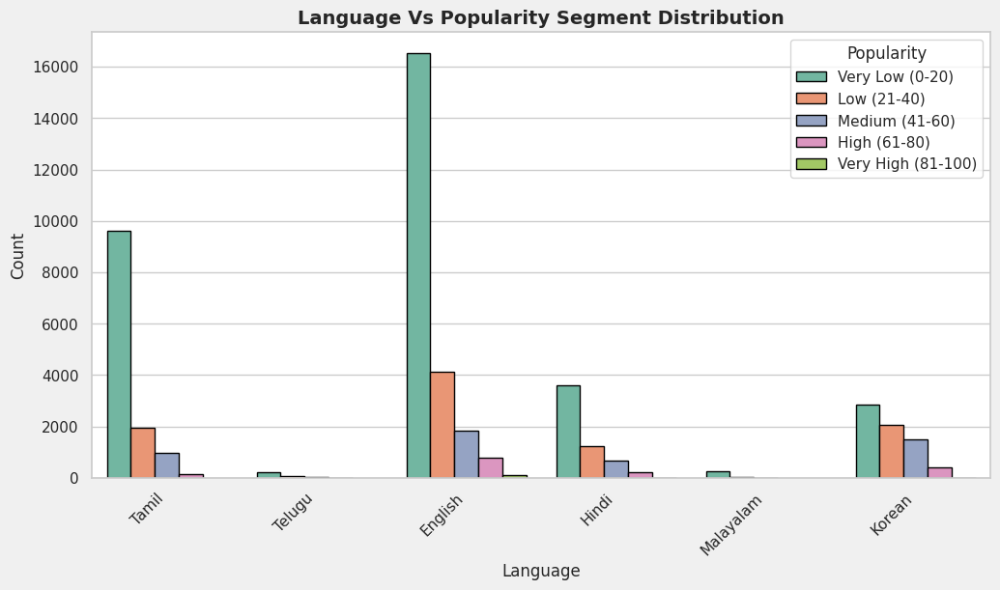

In [ ]:
plt.figure(figsize=(12,6), facecolor='#f0f0f0')
sns.countplot(data=spotify, x='language', hue='popularity_segment', palette='Set2', edgecolor='black')

plt.title("Language Vs Popularity Segment Distribution", fontsize=14, fontweight='bold')
plt.xlabel("Language", fontsize=12)
plt.ylabel("Count", fontsize=12)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Popularity")
plt.show()


**Insights**

*   Across languages and moods, English dominates overall volume with especially large Happy/Excited and Sad/Calm catalogs, while Tamil and Korean are the strongest regional drivers for upbeat, high‑energy programming—Tamil excels in party‑leaning Happy/Excited, Korean balances big Angry/Intense and Happy/Excited segments, Hindi mixes energetic and romantic moods, and Telugu/Malayalam contribute smaller but focused pockets—so for scale use English, for party target Tamil, for hype target Korean, and for mainstream film/romance lean on Hindi.

*   English and Korean have the broadest share of higher-popularity segments, with English leading total volume and showing the largest Medium–High bins, while Korean over-indexes in Medium and retains a meaningful High slice; Tamil and Hindi are sizable but skew toward Very Low/Low, Telugu and Malayalam are smallest overall.

#**9. Exploratory Data Analysis - Multivariate Analysis**

*   Analysis of Numerical KPI's along with Popuarity and Lnguage.
*   Trend of Numerical KPI's in Decades.

##**A. Popularity wise analysis**

###**I. Danceability, Energy & Valence**

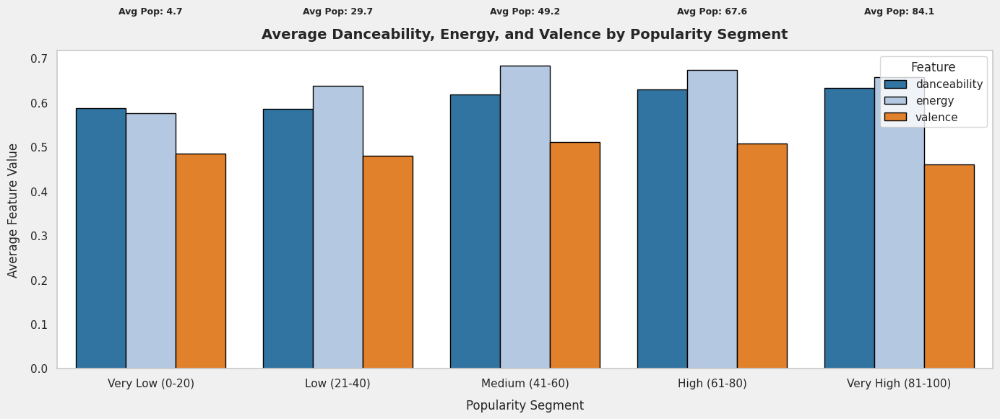

In [ ]:
# Group by popularity segment and compute averages
avg_features = spotify.groupby("popularity_segment")[["danceability", "energy", "valence", "popularity"]].mean().reset_index()

# Melt for grouped bar plotting
avg_melted = avg_features.melt(id_vars=["popularity_segment", "popularity"],value_vars=["danceability", "energy", "valence"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted,x="popularity_segment",y="Average Value",hue="Feature",palette="tab20",edgecolor="black")

# Add average popularity annotations
for i, row in avg_features.iterrows():
    plt.text(x=i, y=.80, s=f"Avg Pop: {row['popularity']:.1f}", ha="center", fontsize=9, fontweight="bold")

plt.title("Average Danceability, Energy, and Valence by Popularity Segment", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Popularity Segment", fontsize = 12, labelpad =10)
plt.ylabel("Average Feature Value", fontsize = 12, labelpad = 10)
plt.legend(title="Feature")
plt.tight_layout()
plt.grid(False)
plt.show()


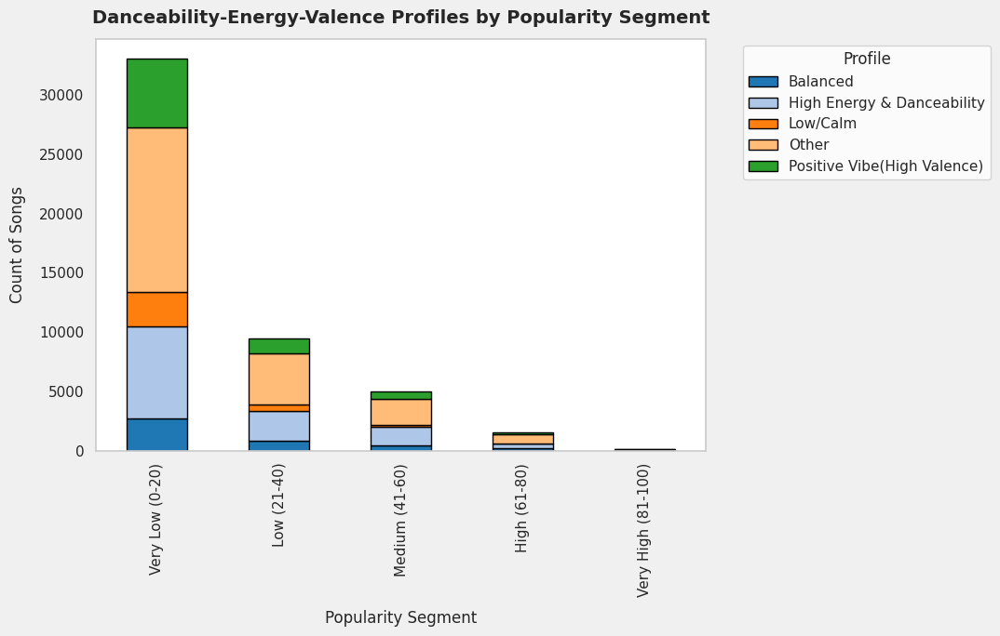

In [ ]:
# Bin each variable into Low/Medium/High
spotify['danceability_bin'] = pd.cut(spotify['danceability'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['energy_bin']       = pd.cut(spotify['energy'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['valence_bin']      = pd.cut(spotify['valence'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def get_profile(row):
    if row['danceability_bin']=='Medium' and row['energy_bin']=='Medium' and row['valence_bin']=='Medium':
        return 'Balanced'
    elif row['energy_bin']=='High' and row['danceability_bin']=='High':
        return 'High Energy & Danceability'
    elif row['valence_bin']=='High':
        return 'Positive Vibe(High Valence)'
    elif row['danceability_bin']=='Low' and row['energy_bin']=='Low' and row['valence_bin']=='Low':
        return 'Low/Calm'
    else:
        return 'Other'

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("tab20", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Danceability-Energy-Valence Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()


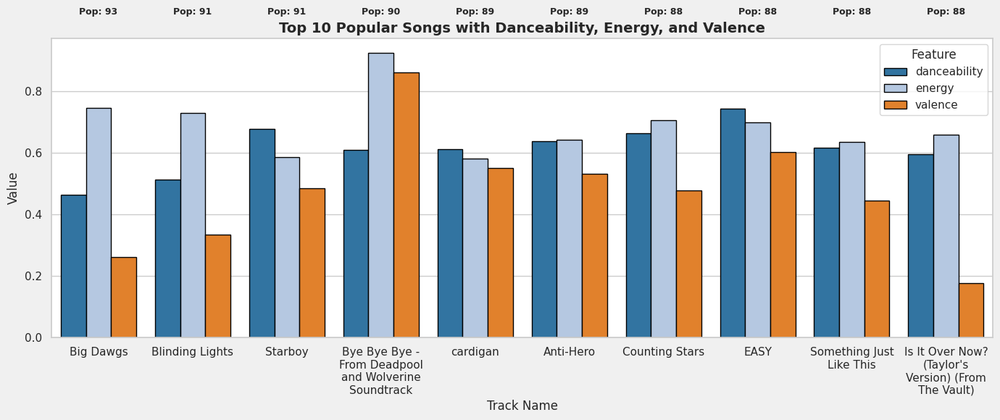

In [ ]:
# Get top 10 popular songs
top10 = spotify.sort_values(by="popularity", ascending=False).head(10)

# Wrap long track names
top10["track_name_wrapped"] = top10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=15)))

# Select relevant columns for plotting
features = ["danceability", "energy", "valence"]
top10_melted = top10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=top10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="tab20",edgecolor="black")

# Rotate x labels (kept slight tilt for readability)
plt.xticks(rotation=0, ha="center")

# Add popularity annotations
for i, row in top10.iterrows():
    plt.text(x=top10.index.get_loc(i), y=1.05, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Top 10 Popular Songs with Danceability, Energy, and Valence", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()


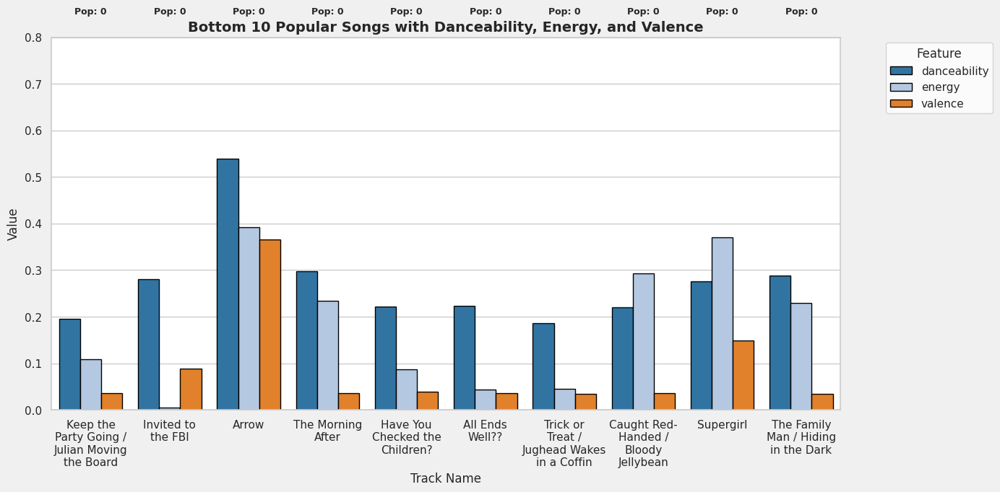

In [ ]:
# Bottom 10 popular songs
bottom10 = spotify.sort_values(by="popularity", ascending=False).tail(10)

# Wrap long track names
bottom10["track_name_wrapped"] = bottom10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=13)))

# Select relevant columns for plotting
features = ["danceability", "energy", "valence"]
bottom10_melted = bottom10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,7), facecolor="#f0f0f0")
sns.barplot(data=bottom10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="tab20",edgecolor="black")

# Rotate x labels slightly for readability
plt.xticks(rotation=0, ha="center")

# Set y-axis limit higher so bars are visible
plt.ylim(0, .8)

# Add popularity annotations
for i, row in bottom10.iterrows():
    plt.text(x=bottom10.index.get_loc(i), y=.85, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Bottom 10 Popular Songs with Danceability, Energy, and Valence", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()


**Insights**

*   **Top vs bottom songs :** The most popular tracks pair mid‑high danceability with high energy and moderate valence, while the least popular skew low on all three or lack consistent energy/danceability, underscoring that punch and movement matter more than pure “happiness.”

*   **Segment profiles :** As popularity rises from very low to very high, average energy and danceability steadily increase, but valence peaks around the middle and softens at the very top—hits are energetic and movable, not necessarily the “happiest.”

*   **Mix archetypes by segment :** High and very‑high segments are enriched for “High Energy & Danceability” profiles and have fewer “Low/Calm” cuts, suggesting curation should bias toward drive and groove for hit‑seeking playlists.

###**II. Acousticness, Instrumentalness & Speechiness**

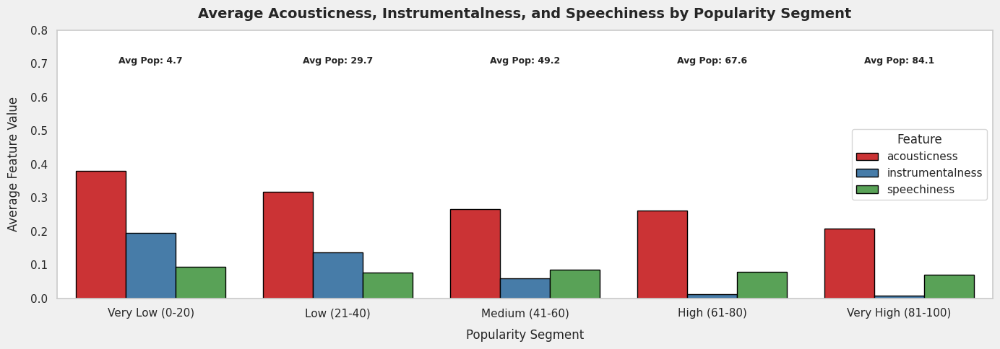

In [ ]:
avg_features = spotify.groupby("popularity_segment")[["acousticness", "instrumentalness", "speechiness", "popularity"]].mean().reset_index()

# Melt for grouped bar plotting
avg_melted = avg_features.melt(id_vars=["popularity_segment", "popularity"],value_vars=["acousticness", "instrumentalness", "speechiness"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(14,5), facecolor="#f0f0f0")
sns.barplot(data=avg_melted,x="popularity_segment",y="Average Value",hue="Feature",palette="Set1",edgecolor="black")
plt.ylim(0, .8)
# Add average popularity annotations
for i, row in avg_features.iterrows():
    plt.text(x=i, y=.7, s=f"Avg Pop: {row['popularity']:.1f}", ha="center", fontsize=9, fontweight="bold")

plt.title("Average Acousticness, Instrumentalness, and Speechiness by Popularity Segment", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Popularity Segment", fontsize = 12, labelpad =10)
plt.ylabel("Average Feature Value", fontsize = 12, labelpad = 10)
plt.legend(title="Feature")
plt.tight_layout()
plt.grid(False)
plt.show()

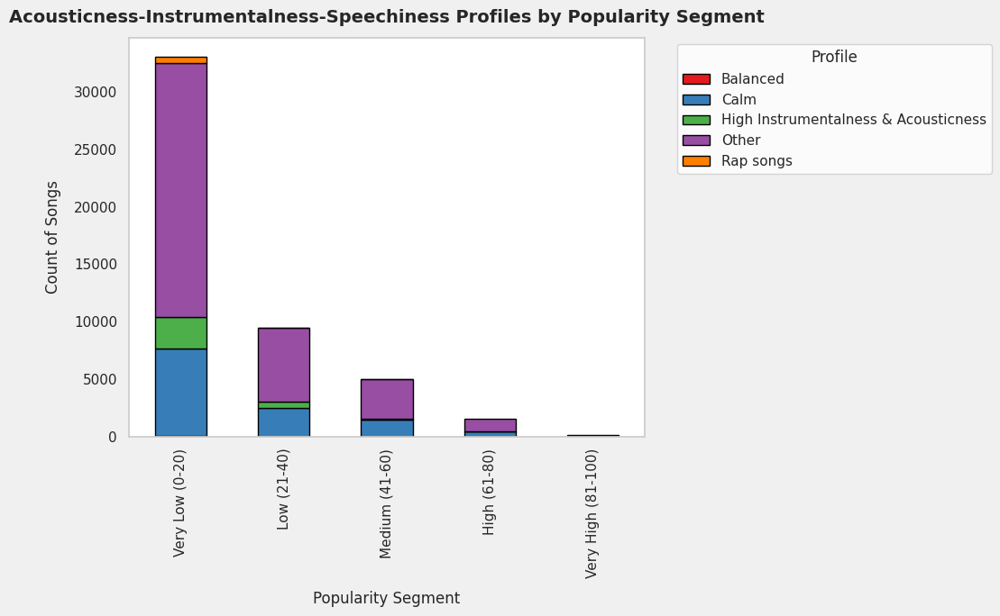

In [ ]:
spotify['acousticness_bin'] = pd.cut(spotify['acousticness'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['instrumentalness_bin']       = pd.cut(spotify['instrumentalness'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['speechiness_bin']      = pd.cut(spotify['speechiness'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def get_profile(row):
    if row['acousticness_bin']=='Medium' and row['instrumentalness_bin']=='Medium' and row['speechiness_bin']=='Medium':
        return 'Balanced'
    elif row['instrumentalness_bin']=='High' and row['acousticness_bin']=='High':
        return 'High Instrumentalness & Acousticness'
    elif row['speechiness_bin']=='High':
        return 'Rap songs'
    elif row['acousticness_bin']=='Low' and row['instrumentalness_bin']=='Low' and row['speechiness_bin']=='Low':
        return 'Calm'
    else:
        return 'Other'

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("Set1", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Acousticness-Instrumentalness-Speechiness Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()


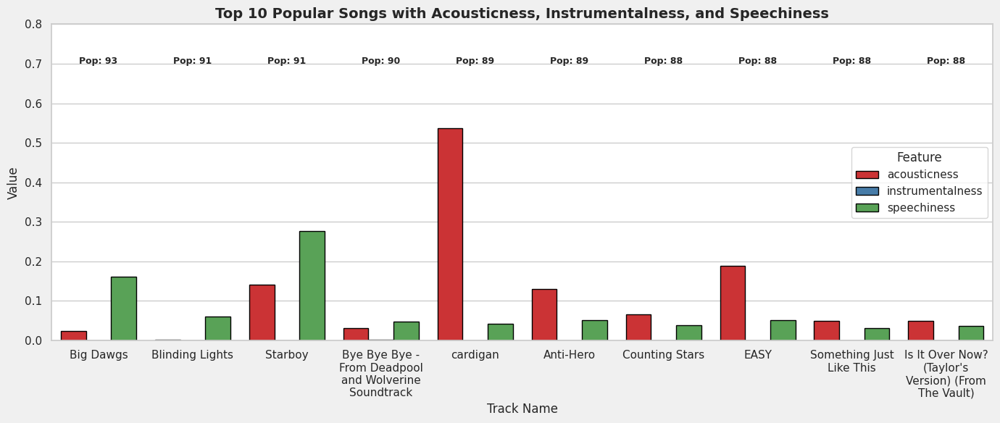

In [ ]:
top10 = spotify.sort_values(by="popularity", ascending=False).head(10)

# Wrap long track names
top10["track_name_wrapped"] = top10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=15)))

# Select relevant columns for plotting
features = ["acousticness", "instrumentalness", "speechiness"]
top10_melted = top10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=top10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="Set1",edgecolor="black")
plt.ylim(0,0.8)
# Rotate x labels (kept slight tilt for readability)
plt.xticks(rotation=0, ha="center")

# Add popularity annotations
for i, row in top10.iterrows():
    plt.text(x=top10.index.get_loc(i), y=.7, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Top 10 Popular Songs with Acousticness, Instrumentalness, and Speechiness", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()


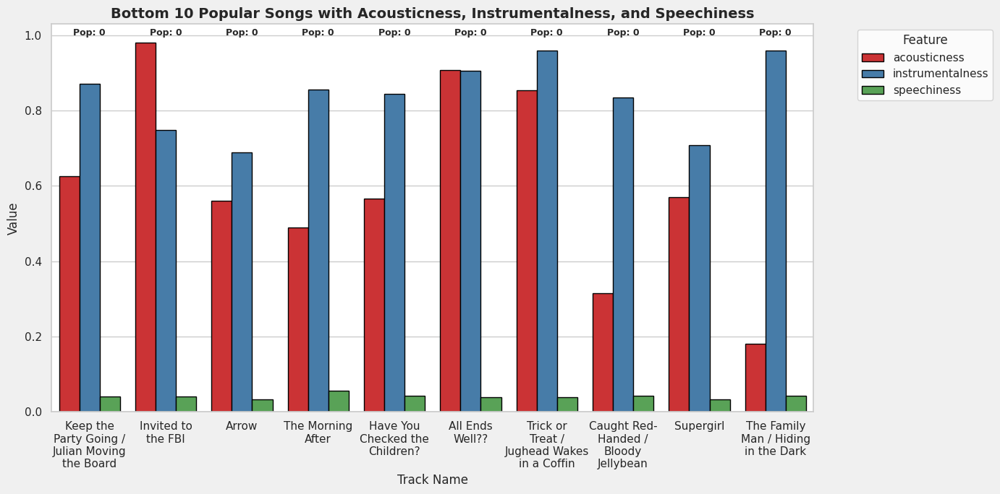

In [ ]:
bottom10 = spotify.sort_values(by="popularity", ascending=False).tail(10)

# Wrap long track names
bottom10["track_name_wrapped"] = bottom10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=13)))

# Select relevant columns for plotting
features = ["acousticness", "instrumentalness", "speechiness"]
bottom10_melted = bottom10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,7), facecolor="#f0f0f0")
sns.barplot(data=bottom10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="Set1",edgecolor="black")

# Rotate x labels slightly for readability
plt.xticks(rotation=0, ha="center")

# Set y-axis limit higher so bars are visible
# plt.ylim(0, .8)

# Add popularity annotations
for i, row in bottom10.iterrows():
    plt.text(x=bottom10.index.get_loc(i), y=1, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Bottom 10 Popular Songs with Acousticness, Instrumentalness, and Speechiness", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()


**Insights**

*   **Bottom vs top songs :** The least popular tracks are very high in instrumentalness and acousticness with low speechiness, while the most popular are low on instrumentalness, moderately acoustic at most, and keep speechiness modest—confirming that vocal‑forward, less‑acoustic mixes fare better.

*   **Profile shift with popularity :** As popularity rises, average instrumentalness drops sharply and acousticness declines, while speechiness edges down—not many rap‑high or instrumental‑only tracks sit in the top tier.

*   **Composition archetypes by segment :** “Calm” and “High Instrumentalness & Acousticness” dominate the very‑low and low segments, whereas higher segments thin out these profiles in favor of more balanced, vocal‑centric productions.

###**III. Loudness, Duration(sec) & Tempo**

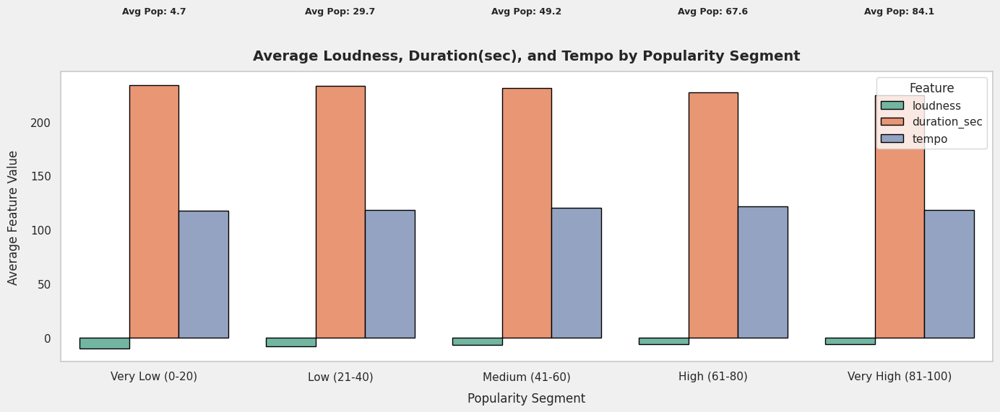

In [ ]:
avg_features = spotify.groupby("popularity_segment")[["loudness", "duration_sec", "tempo", "popularity"]].mean().reset_index()

# Melt for grouped bar plotting
avg_melted = avg_features.melt(id_vars=["popularity_segment", "popularity"],value_vars=["loudness", "duration_sec", "tempo"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted,x="popularity_segment",y="Average Value",hue="Feature",palette="Set2",edgecolor="black")

# Add average popularity annotations
for i, row in avg_features.iterrows():
    plt.text(x=i, y=300, s=f"Avg Pop: {row['popularity']:.1f}", ha="center", fontsize=9, fontweight="bold")

plt.title("Average Loudness, Duration(sec), and Tempo by Popularity Segment", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Popularity Segment", fontsize = 12, labelpad =10)
plt.ylabel("Average Feature Value", fontsize = 12, labelpad = 10)
plt.legend(title="Feature")
plt.tight_layout()
plt.grid(False)
plt.show()


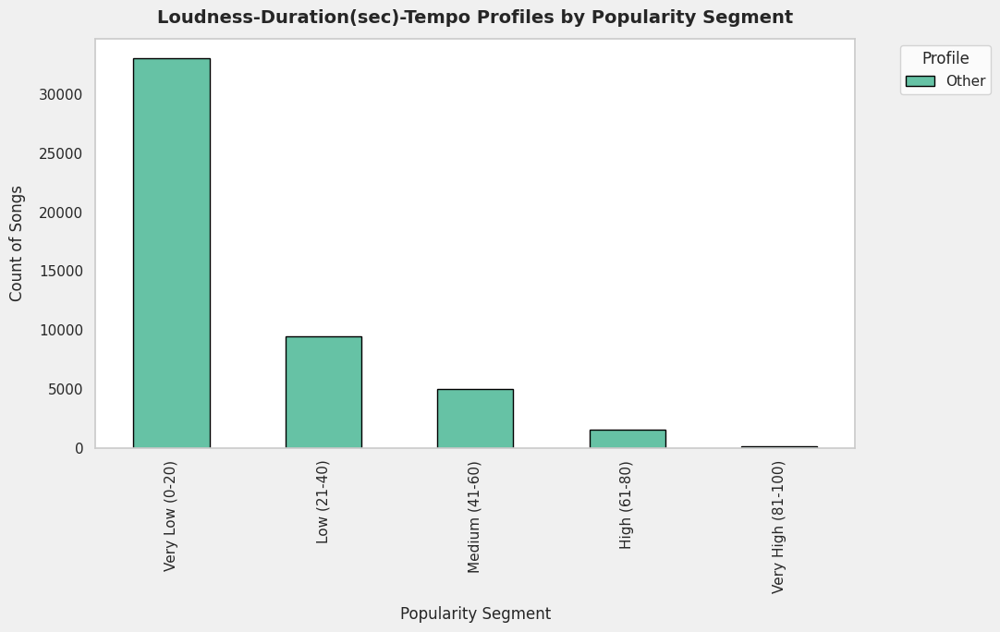

In [ ]:
spotify['loudness_bin'] = pd.cut(spotify['loudness'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['duration_sec_bin']       = pd.cut(spotify['duration_sec'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['tempo_bin']      = pd.cut(spotify['tempo'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def get_profile(row):
    if row['loudness_bin']=='Medium' and row['duration_sec_bin']=='Medium' and row['tempo_bin']=='Medium':
        return 'Balanced'
    elif row['duration_sec_bin']=='High' and row['loudness_bin']=='High':
        return 'High Duration & Loudness'
    elif row['tempo_bin']=='High':
        return 'Fast'
    elif row['loudness_bin']=='Low' and row['duration_sec_bin']=='Low' and row['tempo_bin']=='Low':
        return 'Low/Calm'
    elif row['loudness_bin']=='Low' and row['duration_sec_bin']=='Low' and row['tempo_bin']=='Low':
        return 'Low/Calm'
    else:
        return 'Other'

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("Set2", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Loudness-Duration(sec)-Tempo Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()

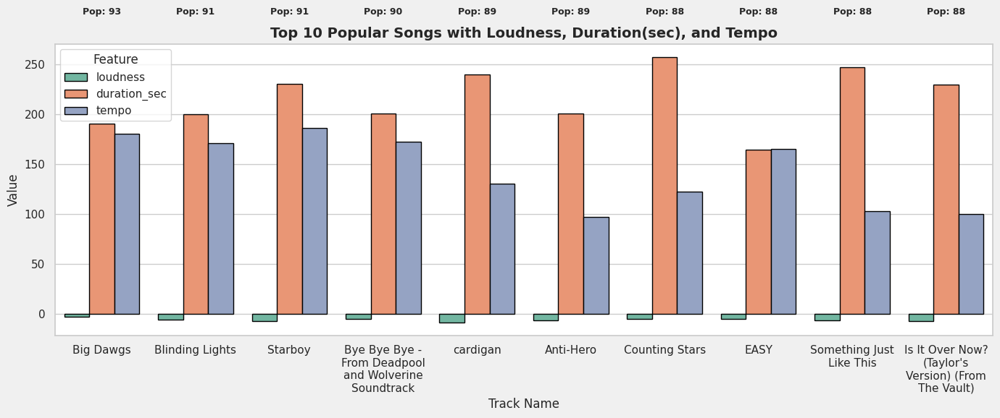

In [ ]:
top10 = spotify.sort_values(by="popularity", ascending=False).head(10)

# Wrap long track names
top10["track_name_wrapped"] = top10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=15)))

# Select relevant columns for plotting
features = ["loudness", "duration_sec", "tempo"]
top10_melted = top10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=top10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="Set2",edgecolor="black")

# Rotate x labels (kept slight tilt for readability)
plt.xticks(rotation=0, ha="center")

# Add popularity annotations
for i, row in top10.iterrows():
    plt.text(x=top10.index.get_loc(i), y=300, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Top 10 Popular Songs with Loudness, Duration(sec), and Tempo", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()

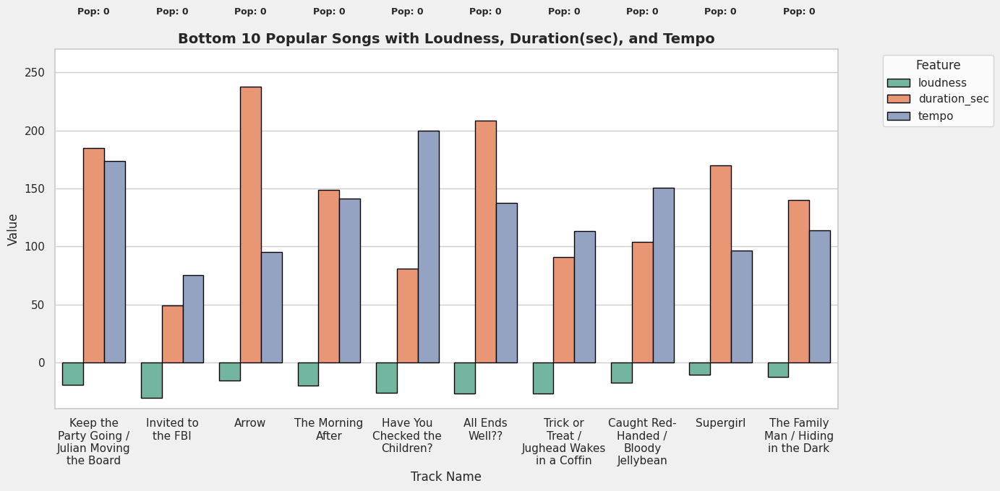

In [ ]:
bottom10 = spotify.sort_values(by="popularity", ascending=False).tail(10)

# Wrap long track names
bottom10["track_name_wrapped"] = bottom10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=13)))

# Select relevant columns for plotting
features = ["loudness", "duration_sec", "tempo"]
bottom10_melted = bottom10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,7), facecolor="#f0f0f0")
sns.barplot(data=bottom10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="Set2",edgecolor="black")

# Rotate x labels slightly for readability
plt.xticks(rotation=0, ha="center")

# Set y-axis limit higher so bars are visible
plt.ylim(-40, 270)

# Add popularity annotations
for i, row in bottom10.iterrows():
    plt.text(x=bottom10.index.get_loc(i), y=300, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Bottom 10 Popular Songs with Loudness, Duration(sec), and Tempo", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()


**Insights**
*   **Top‑hit anatomy :** The most popular tracks cluster around radio‑friendly lengths (2.7–4.3 min), moderately fast tempos (~100–185 BPM), and consistently loud masters (around −6 to −4 dBFS), reinforcing “short, punchy, and loud” as the prevailing hit recipe.

*   **Bottom‑tier contrast :** Least‑popular tracks vary widely in tempo and duration, but are generally quieter (more negative loudness), showing that under‑powered masters correlate with poor traction even when tempo is similar.

*   **Segment trends :** Across popularity segments, tempo stays in a tight mid‑tempo band, duration shortens slightly at the top, and average loudness becomes less negative—suggesting mastering level and tight format fit matter more than raw speed.

*   **Per‑track view (top 10) :** Individual hits mix mid‑to‑high tempos with assertive loudness and concise runtimes; outliers with slower tempos compensate via higher loudness and strong hooks.

*   **Segment mix profile :** The distribution is dominated by a single “other” profile across segments, implying no single L‑D‑T archetype guarantees success; instead, staying within tight professional bounds is necessary but not sufficient.

###**IV. Key, Mode & Time signature**

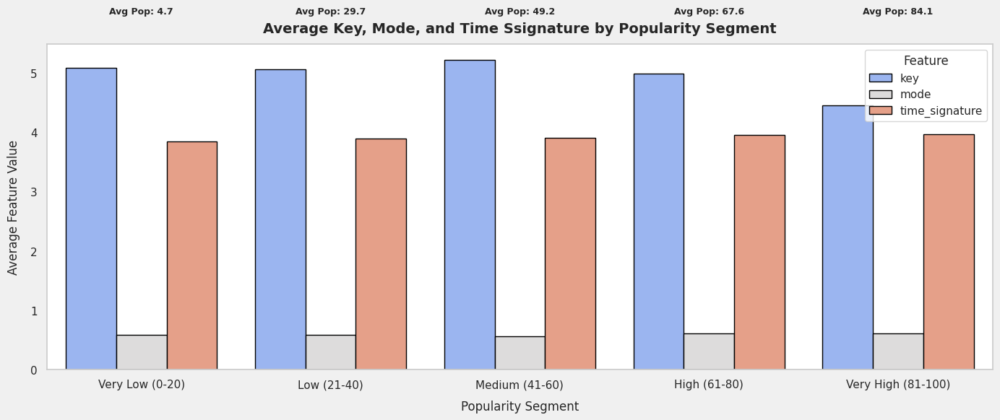

In [ ]:
avg_features = spotify.groupby("popularity_segment")[["key", "mode", "time_signature", "popularity"]].mean().reset_index()

# Melt for grouped bar plotting
avg_melted = avg_features.melt(id_vars=["popularity_segment", "popularity"],value_vars=["key", "mode", "time_signature"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted,x="popularity_segment",y="Average Value",hue="Feature",palette="coolwarm",edgecolor="black")

# Add average popularity annotations
for i, row in avg_features.iterrows():
    plt.text(x=i, y=6, s=f"Avg Pop: {row['popularity']:.1f}", ha="center", fontsize=9, fontweight="bold")

plt.title("Average Key, Mode, and Time Ssignature by Popularity Segment", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Popularity Segment", fontsize = 12, labelpad =10)
plt.ylabel("Average Feature Value", fontsize = 12, labelpad = 10)
plt.legend(title="Feature")
plt.tight_layout()
plt.grid(False)
plt.show()

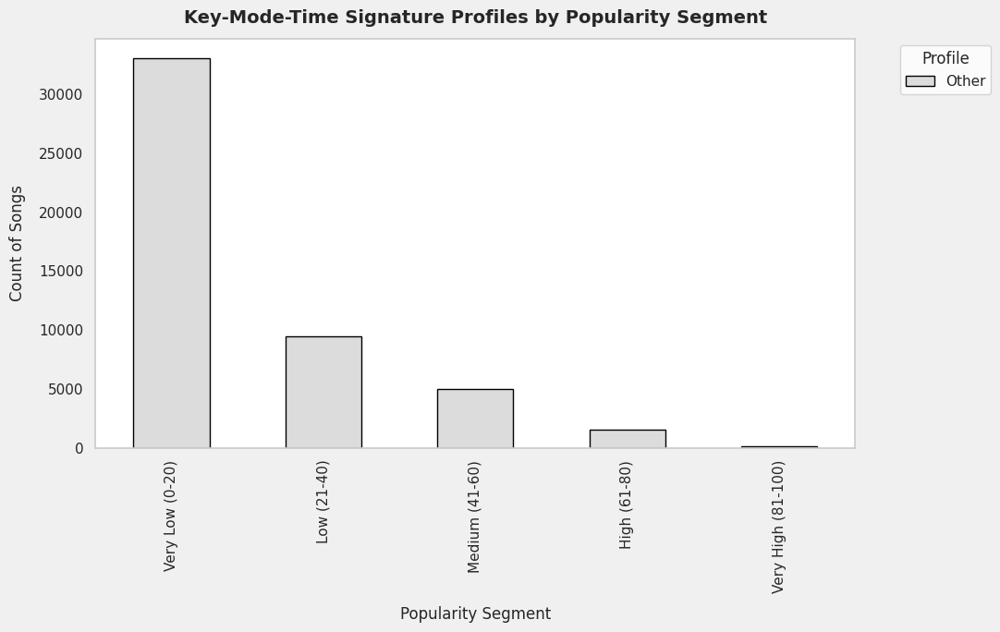

In [ ]:
spotify['key_bin'] = pd.cut(spotify['key'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['mode_bin']       = pd.cut(spotify['mode'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['time_signature_bin']      = pd.cut(spotify['time_signature'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def classify_song(row):
    if row['key_bin'] == 'Medium' and row['mode_bin'] == 'Medium' and row['time_signature_bin'] == 'Medium':
        return f"Balanced ({row['key']}, {row['mode']}, {row['time_signature']})"
    elif row['mode_bin'] == 'High' and row['key_bin'] == 'High':
        return f"High mode & key ({row['key']}, {row['mode']})"
    elif row['time_signature_bin'] == 'High':
        return f"Positive Vibe (High time_signature: {row['time_signature']})"
    elif row['key_bin'] == 'Low' and row['mode_bin'] == 'Low' and row['time_signature_bin'] == 'Low':
        return f"Low/Calm ({row['key']}, {row['mode']}, {row['time_signature']})"
    else:
        return f"Other ({row['key']}, {row['mode']}, {row['time_signature']})"

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("coolwarm", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Key-Mode-Time Signature Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()


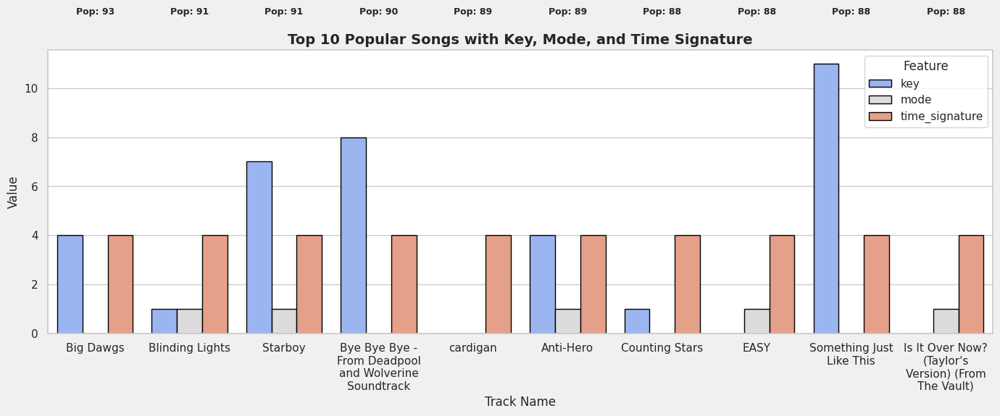

In [ ]:
top10 = spotify.sort_values(by="popularity", ascending=False).head(10)

# Wrap long track names
top10["track_name_wrapped"] = top10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=15)))

# Select relevant columns for plotting
features = ["key", "mode", "time_signature"]
top10_melted = top10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=top10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="coolwarm",edgecolor="black")

# Rotate x labels (kept slight tilt for readability)
plt.xticks(rotation=0, ha="center")

# Add popularity annotations
for i, row in top10.iterrows():
    plt.text(x=top10.index.get_loc(i), y=13, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Top 10 Popular Songs with Key, Mode, and Time Signature", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()


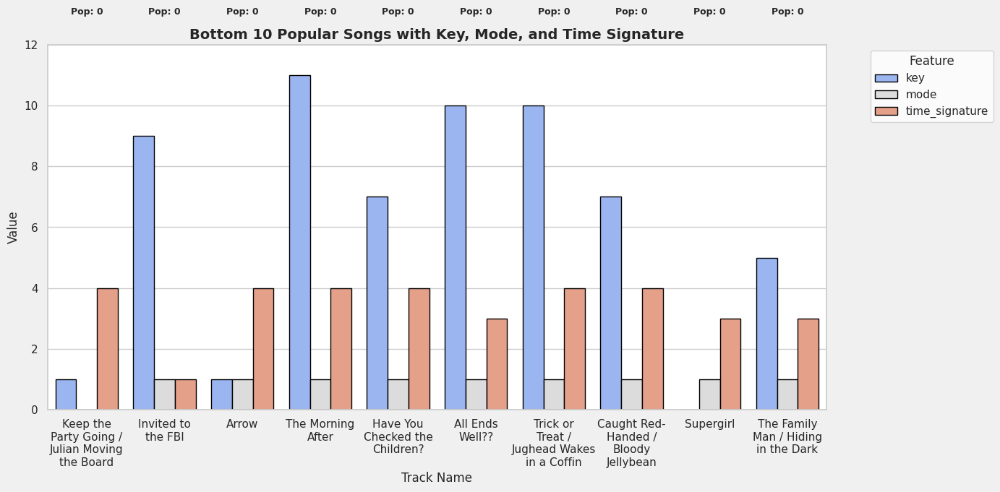

In [ ]:
bottom10 = spotify.sort_values(by="popularity", ascending=False).tail(10)

# Wrap long track names
bottom10["track_name_wrapped"] = bottom10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=13)))

# Select relevant columns for plotting
features = ["key", "mode", "time_signature"]
bottom10_melted = bottom10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,7), facecolor="#f0f0f0")
sns.barplot(data=bottom10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="coolwarm",edgecolor="black")

# Rotate x labels slightly for readability
plt.xticks(rotation=0, ha="center")

# Set y-axis limit higher so bars are visible
plt.ylim(0, 12)

# Add popularity annotations
for i, row in bottom10.iterrows():
    plt.text(x=bottom10.index.get_loc(i), y=13, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Bottom 10 Popular Songs with Key, Mode, and Time Signature", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()


**Insights**

*   **Key and time signature aren’t decisive for hits :** Across popularity bands, average key index hovers mid‑scale and time signature centers on 4/4 with tiny variation, indicating these traits are broadly standardized and weak predictors of success.

*   **Mode skews major for everyone :** The average mode is consistently near 1.0 in all segments, showing a strong bias toward major‑key tracks regardless of popularity—minor isn’t penalized, just less common.

*   **Top vs bottom tracks :** Both top‑10 and bottom‑10 examples overwhelmingly use 4/4 and a mix of keys in major mode, reinforcing that songwriting and production factors matter more than key/meter choices.

*   **Segment distribution :** The stacked profile by popularity shows no distinctive key‑mode‑meter archetype emerging at higher tiers, so optimizing melody, energy, and hook design should take precedence over theoretical key/meter selection.

##**B. Language wise analysis**

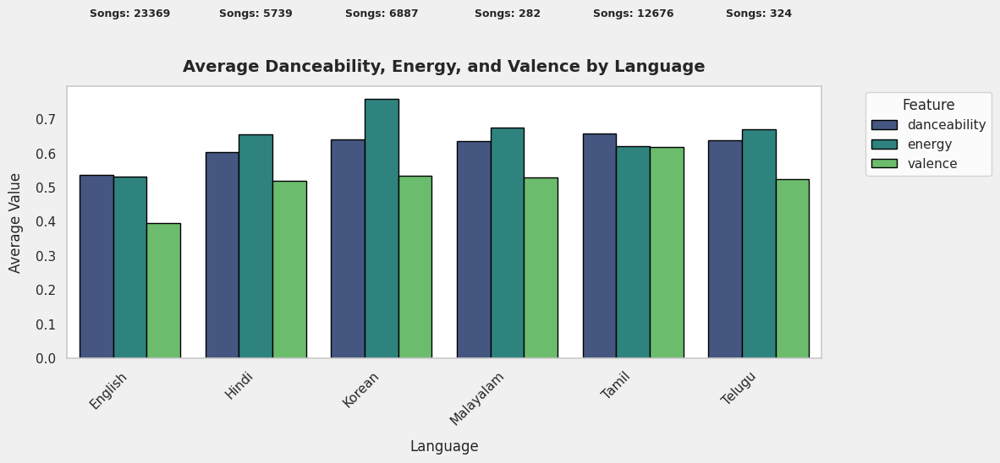

In [ ]:
# Group by language and compute averages
avg_features_lang = spotify.groupby("language")[["danceability", "energy", "valence"]].mean()
song_counts = spotify["language"].value_counts()

# Merge song counts
avg_features_lang["song_count"] = song_counts
avg_features_lang = avg_features_lang.reset_index()

# Melt for grouped bar plotting
avg_melted_lang = avg_features_lang.melt(id_vars=["language", "song_count"],value_vars=["danceability", "energy", "valence"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted_lang,x="language",y="Average Value",hue="Feature",palette="viridis",edgecolor="black")

# Add total song count annotations
for i, row in avg_features_lang.iterrows():
    plt.text(x=i,y=1.00,s=f"Songs: {int(row['song_count'])}",ha="center",fontsize=9,fontweight="bold")

plt.title("Average Danceability, Energy, and Valence by Language", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Language", fontsize = 12, labelpad=10)
plt.ylabel("Average Value", fontsize = 12, labelpad =10)
plt.xticks(rotation=45, ha="right")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.grid(False)
plt.show()

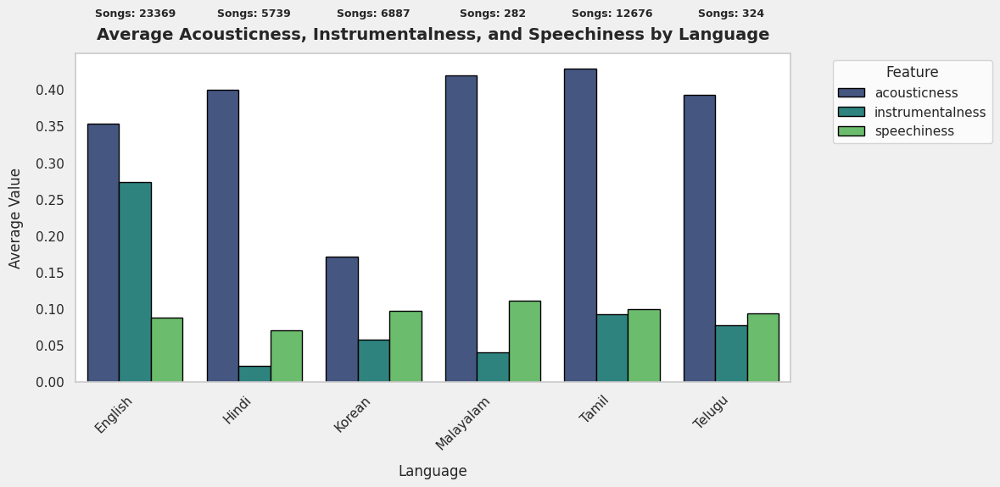

In [ ]:
# Group by language and compute averages
avg_features_lang = spotify.groupby("language")[["acousticness", "instrumentalness", "speechiness"]].mean()
song_counts = spotify["language"].value_counts()

# Merge song counts
avg_features_lang["song_count"] = song_counts
avg_features_lang = avg_features_lang.reset_index()

# Melt for grouped bar plotting
avg_melted_lang = avg_features_lang.melt(id_vars=["language", "song_count"],value_vars=["acousticness", "instrumentalness", "speechiness"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted_lang,x="language",y="Average Value",hue="Feature",palette="viridis",edgecolor="black")

# Add total song count annotations
for i, row in avg_features_lang.iterrows():
    plt.text(x=i,y=.5,s=f"Songs: {int(row['song_count'])}",ha="center",fontsize=9,fontweight="bold")

plt.title("Average Acousticness, Instrumentalness, and Speechiness by Language", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Language", fontsize = 12, labelpad=10)
plt.ylabel("Average Value", fontsize = 12, labelpad =10)
plt.xticks(rotation=45, ha="right")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.grid(False)
plt.show()

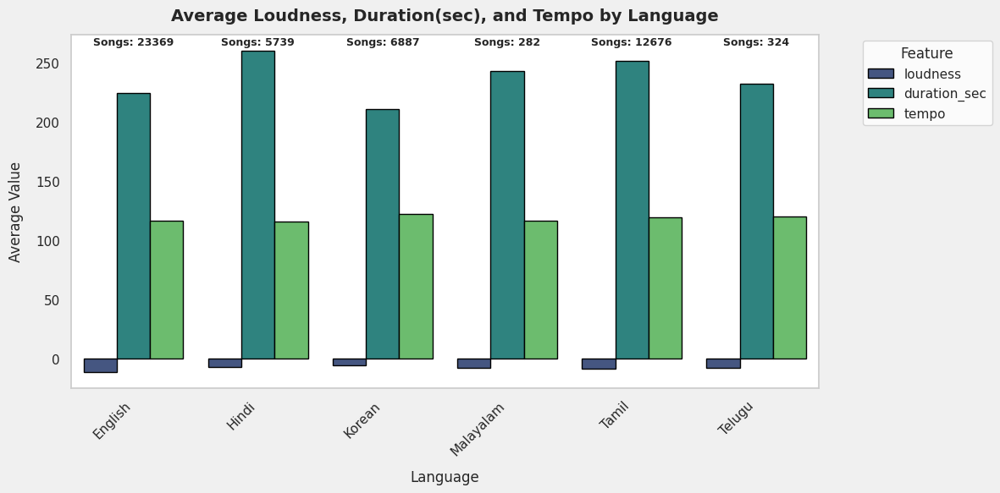

In [ ]:
# Group by language and compute averages
avg_features_lang = spotify.groupby("language")[["loudness", "duration_sec", "tempo"]].mean()
song_counts = spotify["language"].value_counts()

# Merge song counts
avg_features_lang["song_count"] = song_counts
avg_features_lang = avg_features_lang.reset_index()

# Melt for grouped bar plotting
avg_melted_lang = avg_features_lang.melt(id_vars=["language", "song_count"],value_vars=["loudness", "duration_sec", "tempo"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted_lang,x="language",y="Average Value",hue="Feature",palette="viridis",edgecolor="black")

# Add total song count annotations
for i, row in avg_features_lang.iterrows():
    plt.text(x=i,y=265,s=f"Songs: {int(row['song_count'])}",ha="center",fontsize=9,fontweight="bold")

plt.title("Average Loudness, Duration(sec), and Tempo by Language", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Language", fontsize = 12, labelpad=10)
plt.ylabel("Average Value", fontsize = 12, labelpad =10)
plt.xticks(rotation=45, ha="right")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.grid(False)
plt.show()

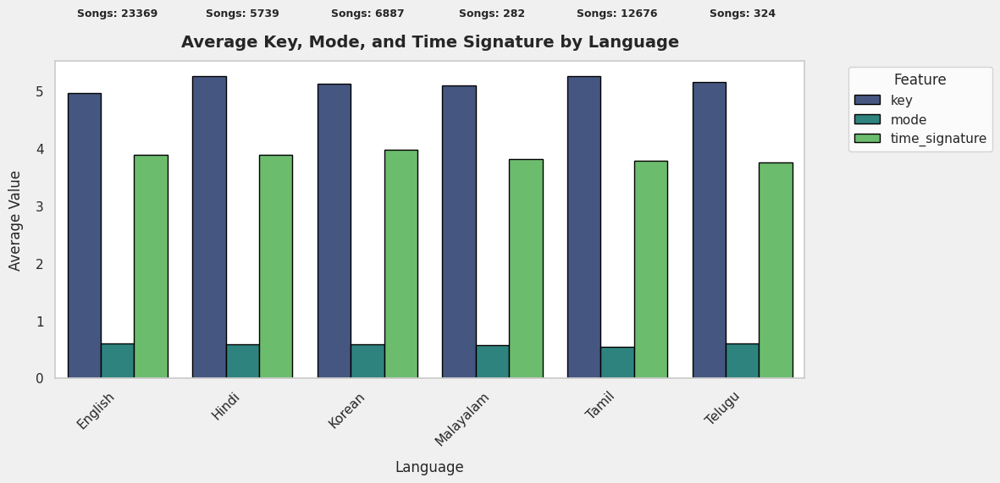

In [ ]:
# Group by language and compute averages
avg_features_lang = spotify.groupby("language")[["key", "mode", "time_signature"]].mean()
song_counts = spotify["language"].value_counts()

# Merge song counts
avg_features_lang["song_count"] = song_counts
avg_features_lang = avg_features_lang.reset_index()

# Melt for grouped bar plotting
avg_melted_lang = avg_features_lang.melt(id_vars=["language", "song_count"],value_vars=["key", "mode", "time_signature"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted_lang,x="language",y="Average Value",hue="Feature",palette="viridis",edgecolor="black")

# Add total song count annotations
for i, row in avg_features_lang.iterrows():
    plt.text(x=i,y=6.3,s=f"Songs: {int(row['song_count'])}",ha="center",fontsize=9,fontweight="bold")

plt.title("Average Key, Mode, and Time Signature by Language", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Language", fontsize = 12, labelpad=10)
plt.ylabel("Average Value", fontsize = 12, labelpad =10)
plt.xticks(rotation=45, ha="right")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.grid(False)
plt.show()

**Insights**

*   **Core structure is uniform across languages :** Keys hover near mid‑index values, major mode dominates, and time signature centers on 4/4 for English, Hindi, Korean, Malayalam, Tamil, and Telugu—song theory choices are broadly standardized.

*   **Movement and punch vary by language :** Danceability rises from English to Tamil/Telugu, energy peaks for Korean, and valence is highest in Tamil, implying Tamil is best for upbeat feel‑good sets while Korean excels at high‑octane curation.

*   **Format differences :** Hindi and Tamil have the longest average durations, Korean the shortest; tempos cluster tightly ~115–122 BPM across all languages, showing speed norms are similar while runtime strategy differs.

*   **Texture and vocals :** English catalogs skew more instrumental than Indian languages; Tamil/Malayalam/Telugu show higher acousticness and moderate speechiness, whereas Korean has lower acousticness but slightly higher speechiness—use English for instrumental/sync beds, Tamil/Malayalam for organic moods, and Korean for modern vocal‑driven energy.

##**C. Decade wise analysis**

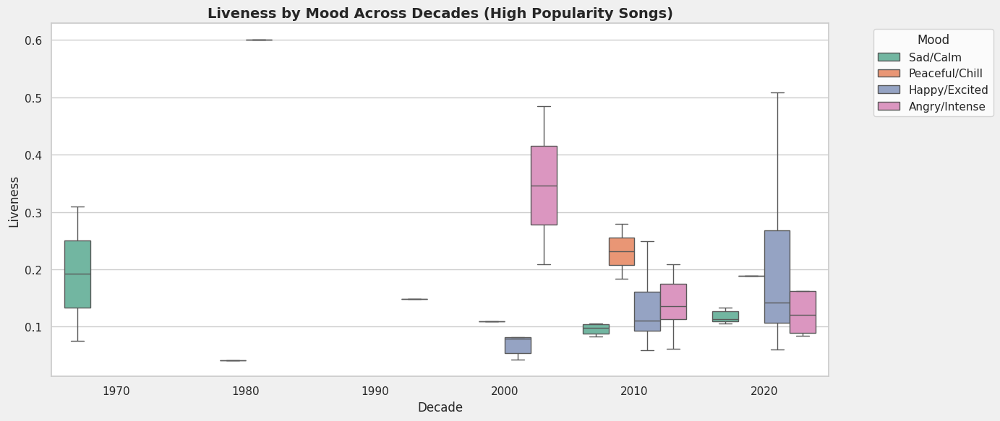

In [ ]:
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.boxplot(
    data= spotify[spotify['popularity_segment'] == 'Very High (81-100)'],x="decade",y="liveness",hue="mood",palette="Set2",showfliers=False)
plt.title("Liveness by Mood Across Decades (High Popularity Songs)", fontsize=14, fontweight="bold")
plt.xlabel("Decade")
plt.ylabel("Liveness")
plt.legend(title="Mood", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()


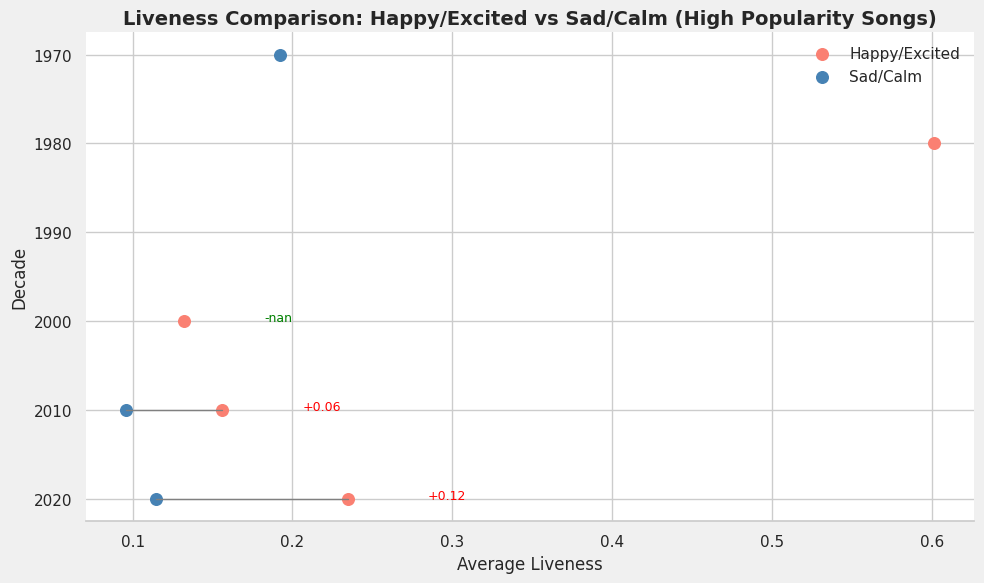

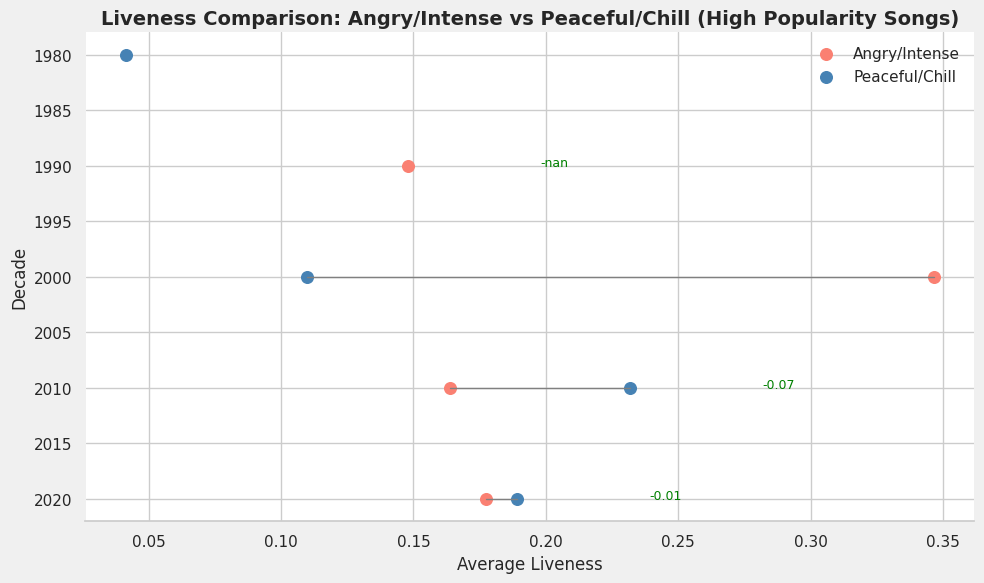

In [ ]:
def plot_mood_comparison(spotify, moods, title_suffix):
    # Filter high popularity + selected moods
    subset = spotify[(spotify["popularity_segment"] == "Very High (81-100)") & (spotify["mood"].isin(moods))]

    # Aggregate average liveness
    agg = subset.groupby(["decade", "mood"])["liveness"].mean().reset_index()

    # Pivot into slope plot format
    df = agg.pivot(index="decade", columns="mood", values="liveness").reset_index()
    df["Difference"] = df[moods[0]] - df[moods[1]]

    # --- Plot ---
    fig, ax = plt.subplots(figsize=(10, 6))
    fig.patch.set_facecolor('#f0f0f0')

    # Scatter points
    ax.scatter(df[moods[0]], df["decade"], color="salmon", label=moods[0], s=70)
    ax.scatter(df[moods[1]], df["decade"], color="steelblue", label=moods[1], s=70)

    # Lines connecting moods
    for _, row in df.iterrows():
        ax.plot([row[moods[0]], row[moods[1]]],
                [row["decade"], row["decade"]],
                color="gray", linestyle="-", linewidth=1)

    # Annotate difference
    for _, row in df.iterrows():
        diff = row["Difference"]
        x_pos = max(row[moods[0]], row[moods[1]]) + 0.05
        color = "red" if diff > 0 else "green"
        sign = "+" if diff > 0 else "-"
        ax.annotate(f"{sign}{abs(diff):.2f}", (x_pos, row["decade"]),
                    color=color, fontsize=9)

    # Labels & styling
    ax.set_xlabel("Average Liveness", fontsize=12)
    ax.set_ylabel("Decade", fontsize=12)
    ax.set_title(f"Liveness Comparison: {moods[0]} vs {moods[1]} ({title_suffix})",
                 fontsize=14, fontweight="bold")

    ax.invert_yaxis()
    ax.legend(loc="upper right", frameon=False)

    # Remove spines
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["left"].set_visible(False)

    plt.tight_layout()
    plt.show()


# --- Run for both cases ---
plot_mood_comparison(spotify, ["Happy/Excited", "Sad/Calm"], "High Popularity Songs")
plot_mood_comparison(spotify, ["Angry/Intense", "Peaceful/Chill"], "High Popularity Songs")


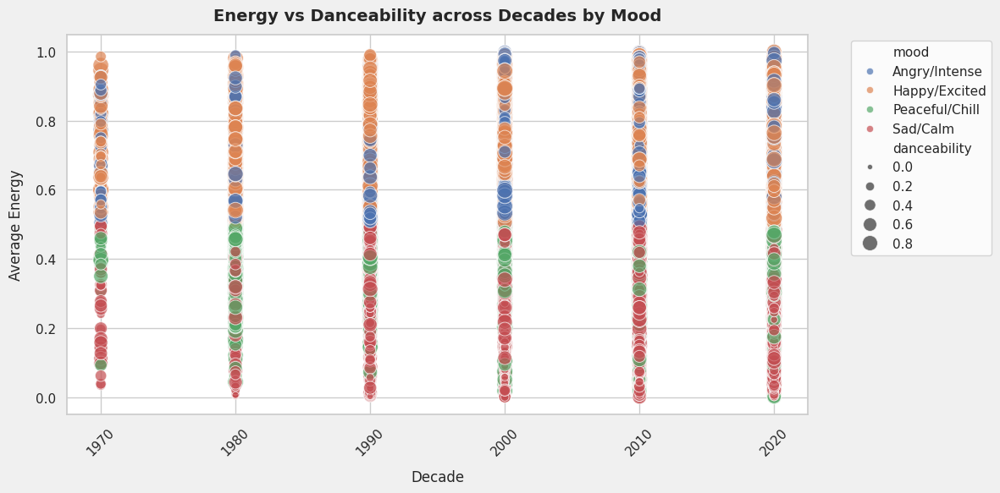

In [ ]:
# Energy vs Danceability across Decades by Mood
plt.figure(figsize=(12, 6), facecolor="#f0f0f0")
sns.scatterplot(data=spotify,x="decade",y="energy",hue="mood",size="danceability",sizes=(20, 200),alpha=0.7)
plt.title("Energy vs Danceability across Decades by Mood", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Average Energy", fontsize = 12, labelpad = 10)
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

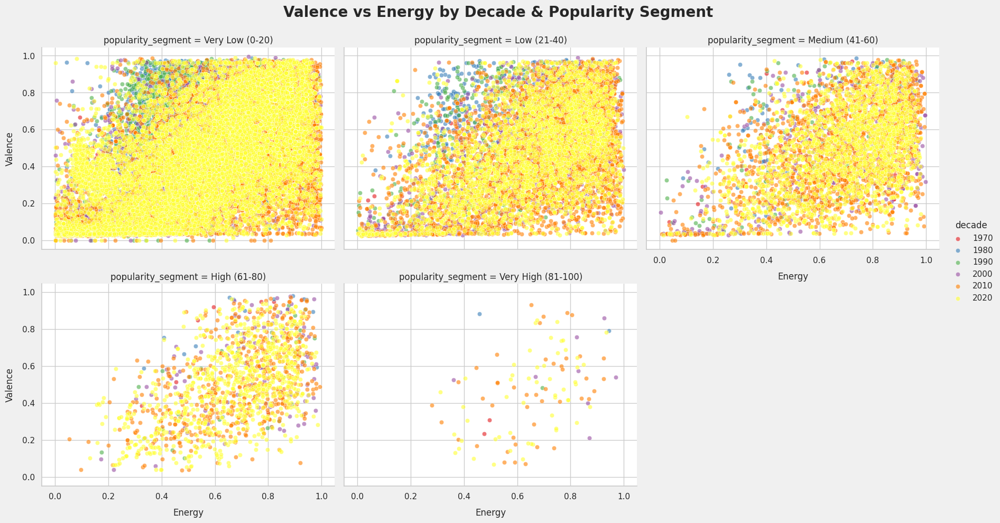

In [ ]:
# Valence vs Energy by Decade & Popularity Segment
g = sns.FacetGrid(spotify, col="popularity_segment", hue="decade", height=5, aspect=1.2, palette= "Set1", col_wrap=3)
g.map(sns.scatterplot, "energy", "valence", alpha=0.6)
g.add_legend()
g.set_axis_labels("Energy", "Valence", fontsize = 12, labelpad = 10)
plt.subplots_adjust(top=0.9)
g.fig.suptitle("Valence vs Energy by Decade & Popularity Segment", fontsize=20, weight="bold")
g.fig.patch.set_facecolor("#f0f0f0")
plt.show()


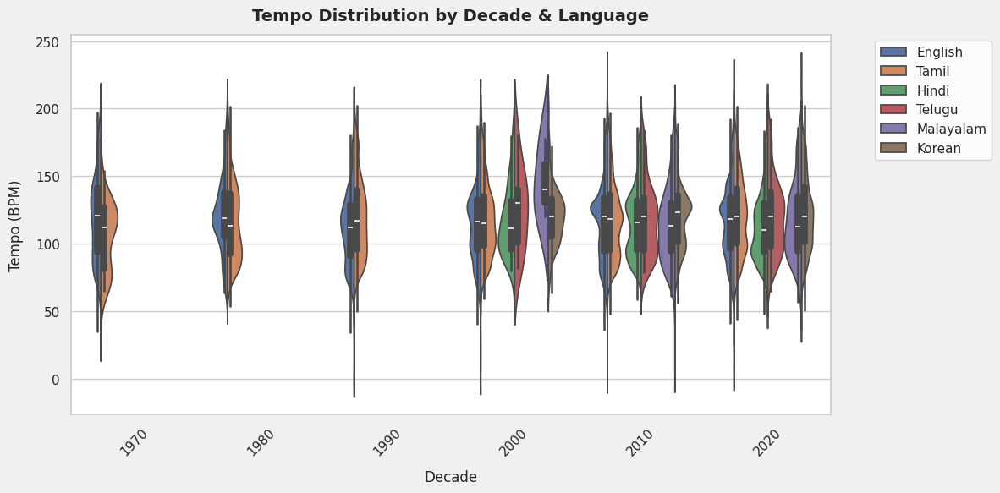

In [ ]:
# Tempo Distribution by Decade & Language
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.violinplot(data=spotify,x="decade",y="tempo",hue="language",split=True)
plt.title("Tempo Distribution by Decade & Language", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Tempo (BPM)", fontsize = 12, labelpad =10)
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

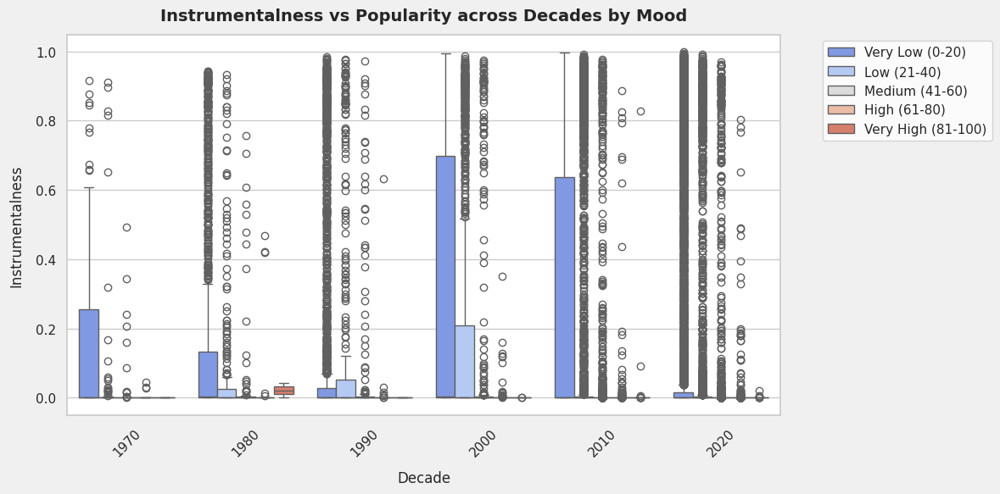

In [ ]:
# Instrumentalness vs Popularity across Decades by Mood
plt.figure(figsize=(12, 6), facecolor = ("#f0f0f0"))
sns.boxplot(data=spotify,x="decade",y="instrumentalness",hue="popularity_segment", palette = "coolwarm")
plt.title("Instrumentalness vs Popularity across Decades by Mood", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

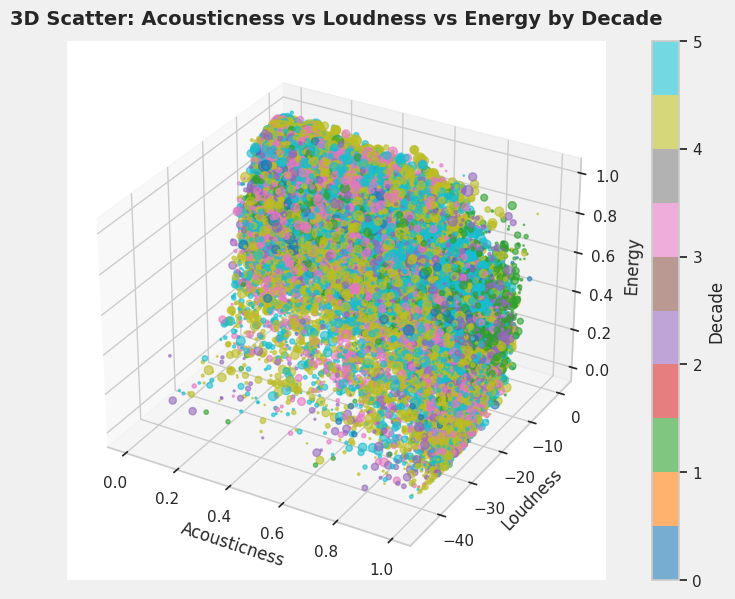

In [ ]:
# 3D Scatter Acousticness vs Loudness vs Energy by Decade
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(12, 7), facecolor  =("#f0f0f0"))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(spotify['acousticness'],spotify['loudness'],spotify['energy'],c=spotify['decade'].astype('category').cat.codes,s=spotify['popularity'],alpha=0.6,cmap="tab10")
ax.set_xlabel("Acousticness")
ax.set_ylabel("Loudness")
ax.set_zlabel("Energy")
plt.title("3D Scatter: Acousticness vs Loudness vs Energy by Decade", fontsize=14, weight="bold", pad = 12)
plt.colorbar(sc, label="Decade")
plt.show()

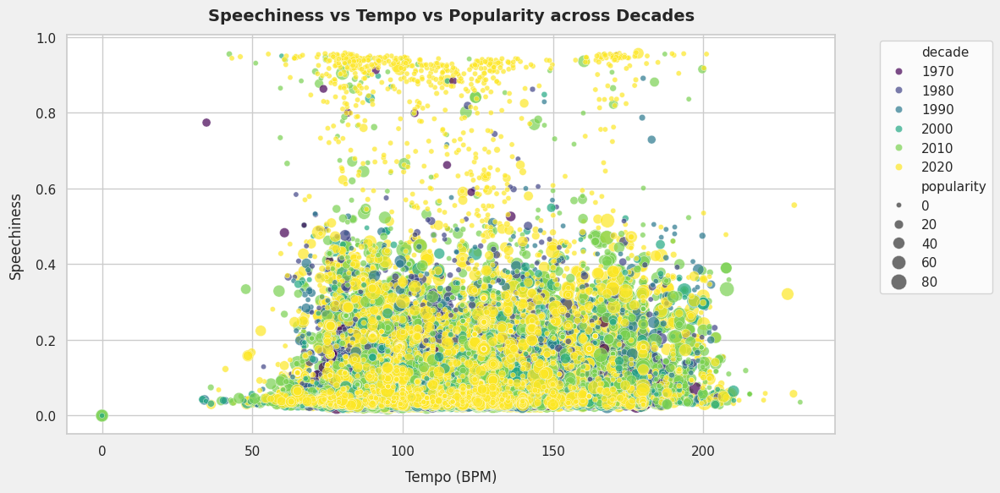

In [ ]:
# Speechiness vs Tempo vs Popularity across Decades
plt.figure(figsize=(12, 6), facecolor = ("#f0f0f0"))
sns.scatterplot(data=spotify,x="tempo",y="speechiness",hue="decade",size="popularity",sizes=(20, 200),alpha=0.7, palette = "viridis")
plt.title("Speechiness vs Tempo vs Popularity across Decades", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Tempo (BPM)", fontsize = 12, labelpad = 10)
plt.ylabel("Speechiness", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

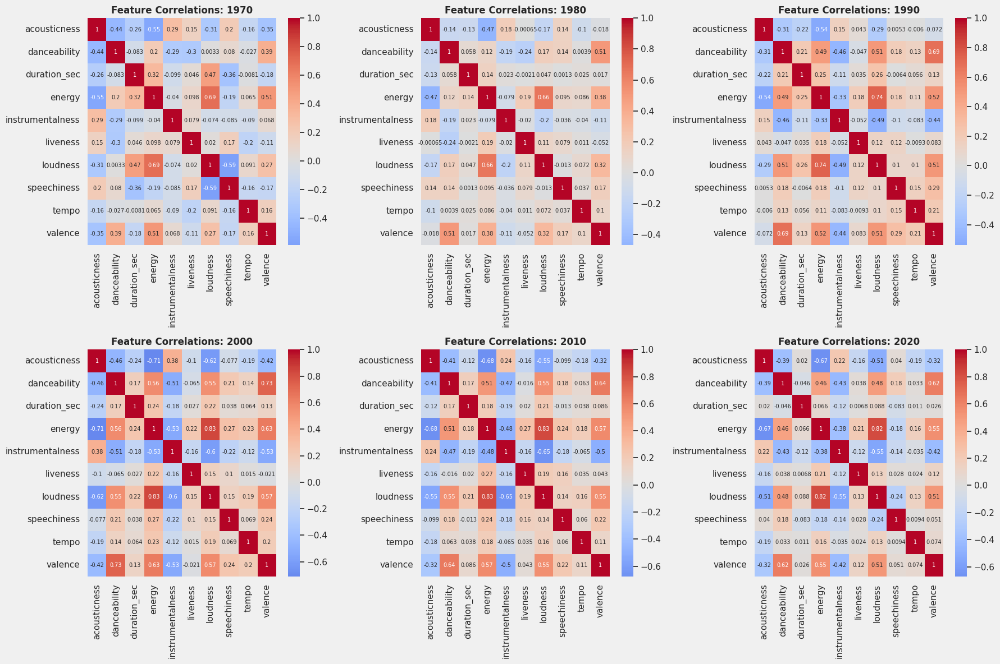

In [ ]:
# Heatmap of Feature Correlations per Decade

# Features to correlate
features = ["acousticness", "danceability", "duration_sec", "energy",
            "instrumentalness", "liveness", "loudness", "speechiness",
            "tempo", "valence"]

# Example: take the first 6 decades (or unique subsets)
decades = sorted(spotify['decade'].unique())[:6]

# Create 2x3 grid
fig, axes = plt.subplots(2, 3, figsize=(18, 12), facecolor="#f0f0f0")
axes = axes.flatten()

# Loop through each decade and plot correlation heatmap
for ax, decade in zip(axes, decades):
    subset = spotify[spotify['decade'] == decade]
    corr = subset[features].corr()
    sns.heatmap(corr, annot=True, cmap="coolwarm", center=0, ax=ax, annot_kws={"size": 7})
    ax.set_title(f"Feature Correlations: {decade}", fontsize=12, weight="bold")

# Remove any unused axes
for i in range(len(decades), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

<Figure size 1200x700 with 0 Axes>

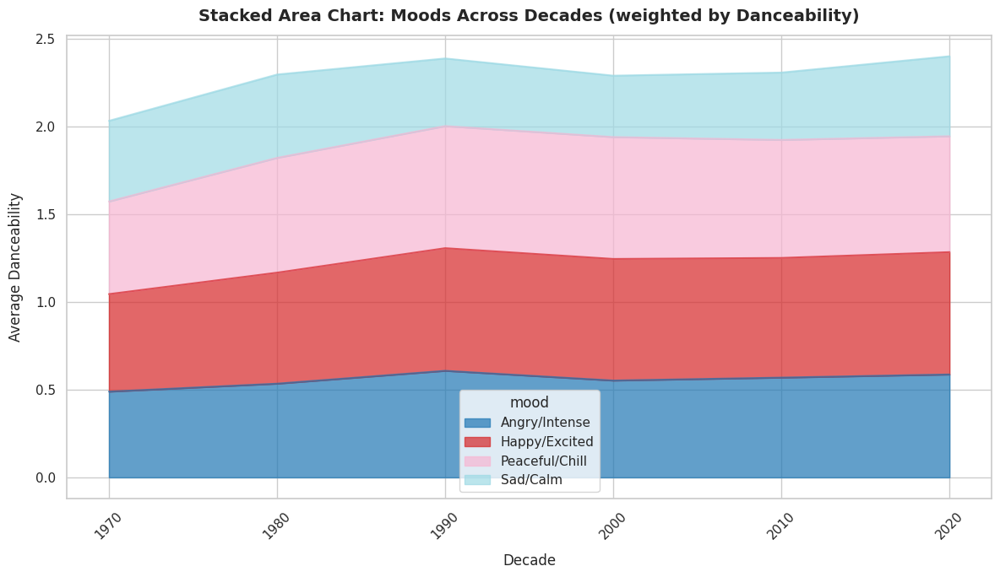

In [ ]:
# Stacked Area Chart of Moods Across Decades (weighted by Danceability)
mood_trends = spotify.groupby(["decade", "mood"]).danceability.mean().reset_index()
mood_pivot = mood_trends.pivot(index="decade", columns="mood", values="danceability").fillna(0)

plt.figure(figsize=(12, 7), facecolor = ("#f0f0f0"))
mood_pivot.plot(kind='area', alpha=0.7, figsize=(12,7), cmap="tab20")
plt.title("Stacked Area Chart: Moods Across Decades (weighted by Danceability)", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Decade", labelpad = 10, fontsize = 12)
plt.ylabel("Average Danceability", labelpad = 10, fontsize = 12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

**Insights**

*   **High‑popularity favors high energy over high valence :** In every segment, the densest clusters of top‑decade points sit at energy ≥0.6 while valence spreads wide, showing hits are driven by intensity, not necessarily “happiness.”

*   **Live feel trends down with time for hits :** Average liveness in high‑popularity songs drops from early decades to 2010s/2020s for both Happy/Excited and Sad/Calm, indicating tighter studio polish and fewer live artifacts in recent charting tracks.

*   **Mood‑by‑decade liveness :** Angry/Intense shows the widest liveness ranges in the 2000s–2020s, while Peaceful/Chill remains low and stable, suggesting aggressive genres tolerate more room/noise than chill formats.

*   **Danceability as a multiplier :** Across decades and moods, points with larger markers (higher danceability) consistently align with higher energy, reinforcing that movement plus punch is the clearest common recipe across eras.

*   **Rap proxy vs tempo :** High‑speechiness cuts (rap/spoken) appear across a wide BPM band, but the largest, most popular bubbles cluster between ~85–105 and ~120–140 BPM, implying two sweet spots for hit rap pacing.

*   **Tempo norms by language :** Medians sit tightly around ~110–125 BPM for all languages each decade, with Korean and Tamil showing slightly higher ceilings—so tempo alone rarely differentiates; arrangement and groove do.

*   **Instrumentals underperform at scale :** Across decades, high instrumentalness is concentrated in the very‑low and low popularity bands, with scarce presence in the high tiers, underscoring the advantage of vocal‑led tracks for mainstream success.

*   **Production triad :** Energy rises as loudness becomes less negative and acousticness falls; modern hits inhabit the low‑acousticness, loud, high‑energy corner, reinforcing the electronic/processed tilt of contemporary chart music.

*   **Danceability has risen for high‑movement moods :** Weighted by danceability, Happy/Excited and Angry/Intense both trend upward since the 1970s, while Peaceful/Chill plateaus and Sad/Calm dips then recovers—party‑leaning moods increasingly dominate motion.

*   **Stable feature physics across eras :** Correlations show a persistent pattern—energy correlates positively with loudness and negatively with acousticness; danceability aligns moderately with valence and tempo; instrumentalness opposes danceability/energy—modern decades strengthen the energy‑loudness link.

#**10. Exploratory Data Analysis - Timeseries Analysis**

*   Trend analysis of Numerical & Categorical KPI's.
*   Trend analysis according to Popularity Segments.
*   Trend analysis according to Languages.

##**I. Yearly trend analysis of Numerical KPI's**

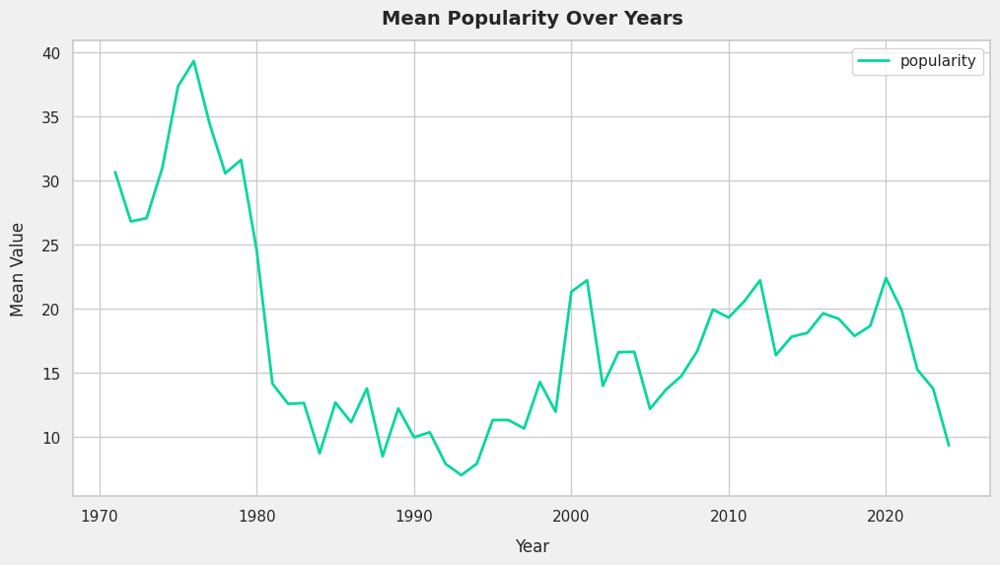

In [ ]:
# Aggregate mean values by year
features = ['popularity']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'popularity': '#06D6A0'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Mean Popularity Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


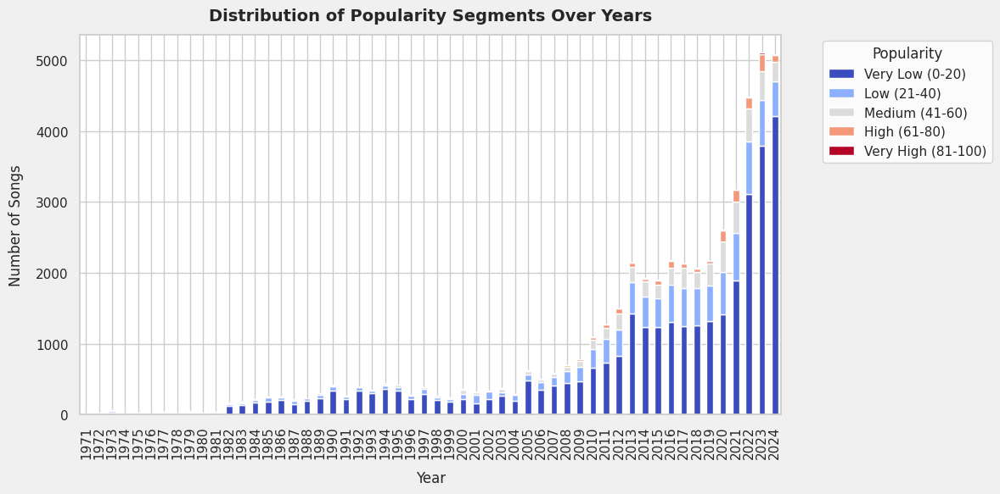

In [151]:
spotify['year_only'] = spotify['year'].dt.year
spotify_counts = spotify.groupby(['year_only', 'popularity_segment']).size().unstack(fill_value=0)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12,6))
fig.patch.set_facecolor('#f0f0f0')
spotify_counts.plot(kind='bar',  stacked=True, colormap='coolwarm', ax=ax)
plt.title('Distribution of Popularity Segments Over Years', fontsize = 14, fontweight = 'bold', pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Number of Songs', labelpad = 10, fontsize = 12)
plt.legend(title='Popularity', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

**Insights**

*   **Volume exploded after 2005 but quality concentration didn’t :** The count of released tracks per year rises sharply post‑2005 with especially large growth since 2015, yet most additions sit in the very‑low and low popularity buckets, indicating catalog expansion outpacing hit density.

*   **Mean popularity drifts downward from late‑70s highs and stabilizes mid‑2010s :** Average popularity peaks in the mid‑to‑late 1970s, declines through the 80s–90s, and hovers in the mid‑teens since 2010 despite surging output, suggesting fragmentation and long‑tail effects in streaming eras.

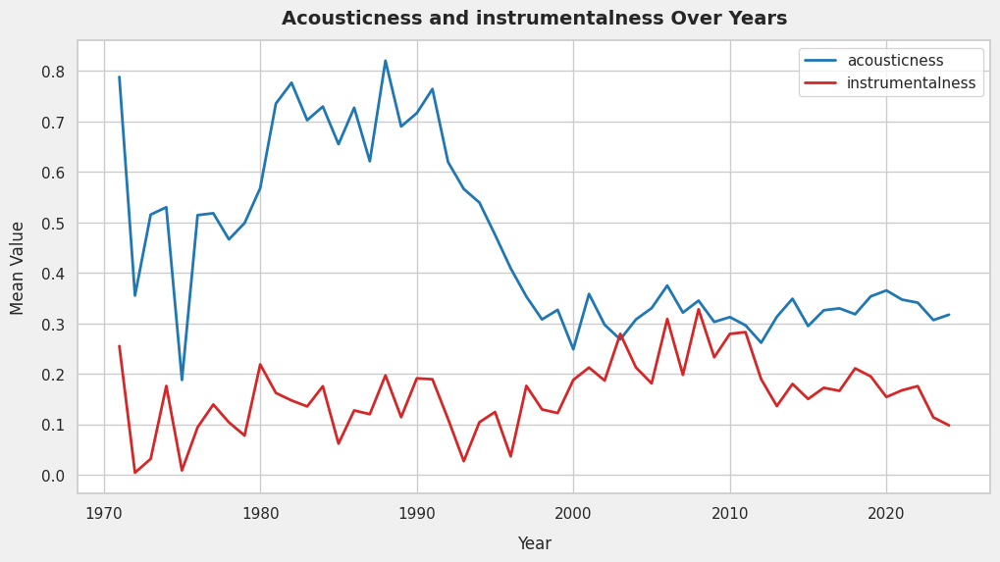

In [ ]:
# Aggregate mean values by year
features = ['acousticness', 'instrumentalness']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'acousticness': '#1f77b4', 'instrumentalness': '#d62728'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Acousticness and instrumentalness Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


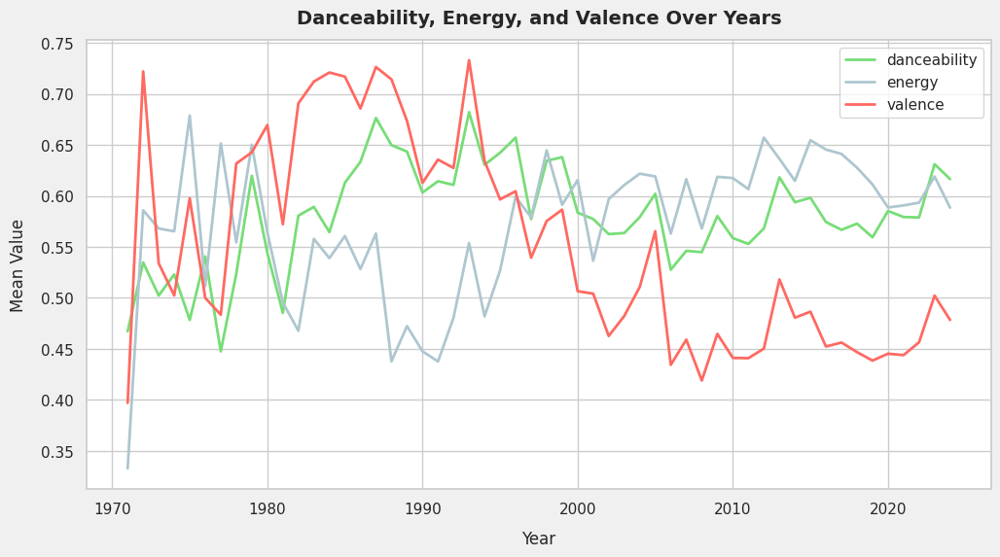

In [ ]:
# Aggregate mean values by year
features = ['danceability', 'energy', 'valence']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'danceability': '#77DD77', 'energy': '#AEC6CF', 'valence': '#FF6961'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Danceability, Energy, and Valence Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


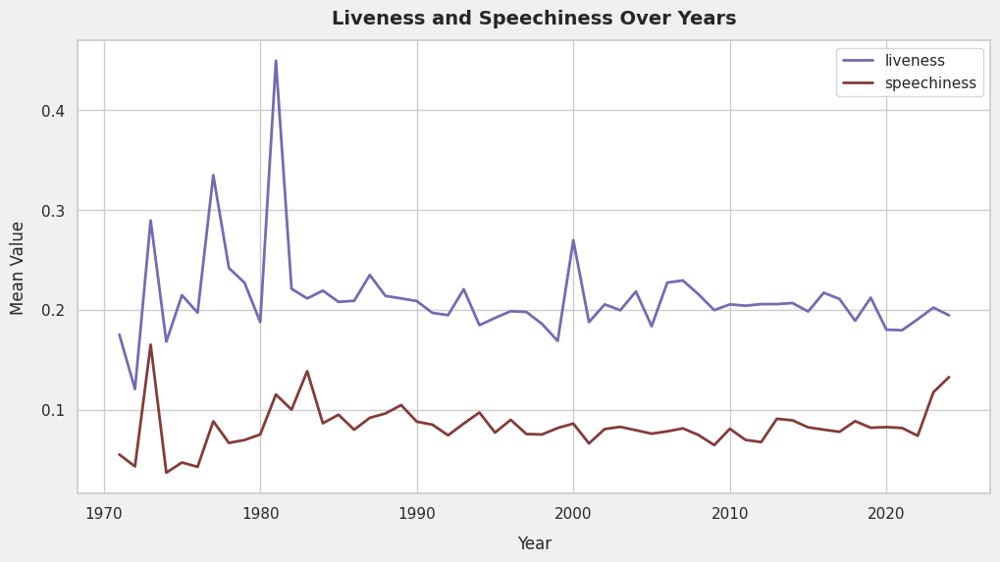

In [ ]:
# Aggregate mean values by year
features = ['liveness', 'speechiness']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'liveness': '#756bb1', 'speechiness': '#843c39'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Liveness and Speechiness Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


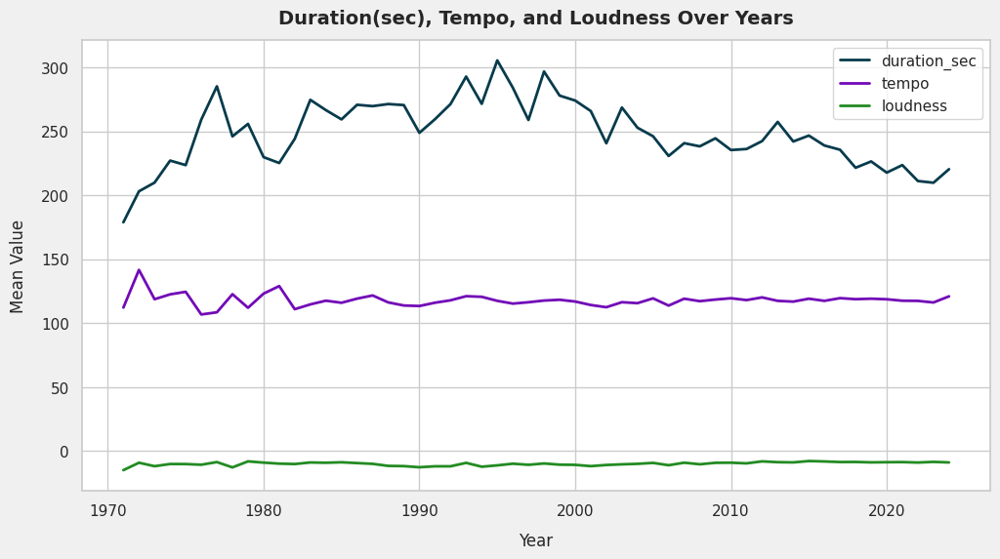

In [ ]:
# Aggregate mean values by year
features = ['duration_sec', 'tempo', 'loudness']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'duration_sec': '#073B4C', 'tempo': '#7209b7', 'loudness': '#228b22'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Duration(sec), Tempo, and Loudness Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


**Insights**

*   **Songs have become shorter, slightly faster, and louder since the 1990s :** Average duration peaked in the late 90s then trended down, tempo holds in the 110–120 BPM band with a small uptick post‑2010, and average loudness has become less negative, reflecting modern “hotter” masters.

*   **Texture shifted from acoustic to produced, while vocals remained central :** Acousticness fell steadily from the 90s onward as electronic/processed production rose; instrumentalness rose into the 2010s but remains well below vocal norms, so mainstream continues to be vocal‑led.

*   **Movement and intensity are resilient; “happiness” softened :** Danceability stays stable to slightly rising, energy trends upward from the 2000s, whereas valence drifts downward from 90s highs—today’s hits are energetic and danceable without needing bright mood.

*   **Live feel is flat‑to‑down, speechiness edges up recently :** Liveness has gradually leveled or dipped, consistent with studio‑polished releases; speechiness shows a late uptick after 2020, hinting at more talk/rap elements in recent tracks.

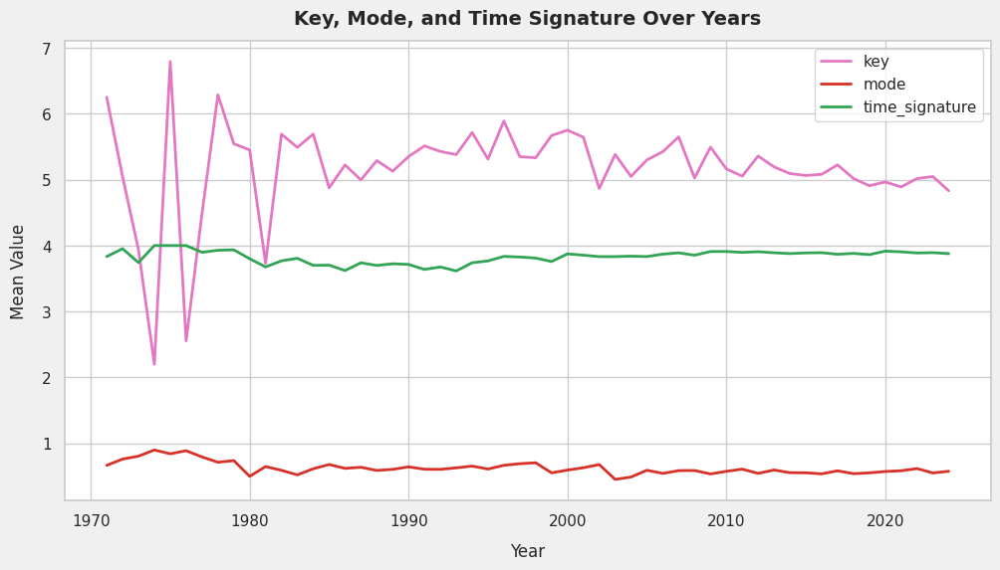

In [ ]:
# Aggregate mean values by year
features = ['key', 'mode', 'time_signature']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'key': '#e377c2', 'mode': '#d73027', 'time_signature': '#31a354'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Key, Mode, and Time Signature Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()

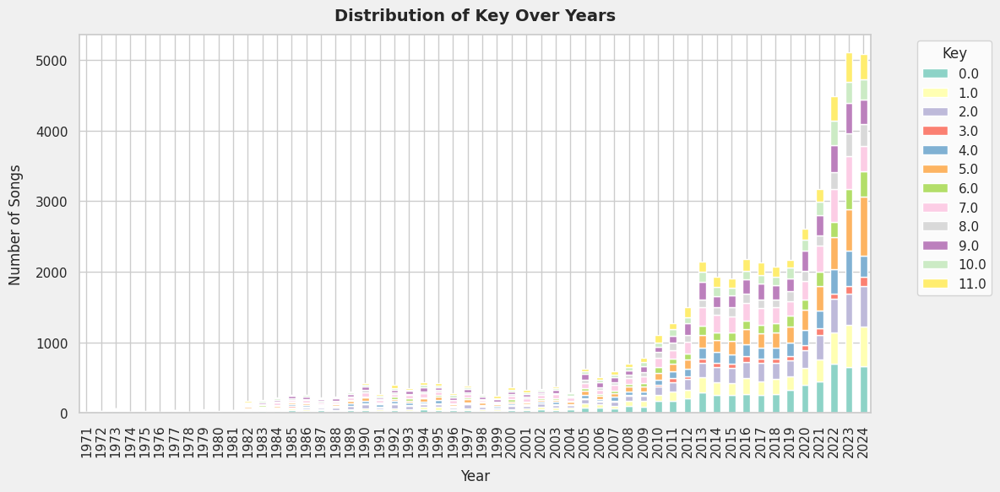

In [ ]:
spotify['year_only'] = spotify['year'].dt.year
spotify_counts = spotify.groupby(['year_only', 'key']).size().unstack(fill_value=0)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12,6))
fig.patch.set_facecolor('#f0f0f0')
spotify_counts.plot(kind='bar',  stacked=True, colormap='Set3', ax=ax)
plt.title('Distribution of Key Over Years', fontsize = 14, fontweight = 'bold', pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Number of Songs', labelpad = 10, fontsize = 12)
plt.legend(title='Key', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

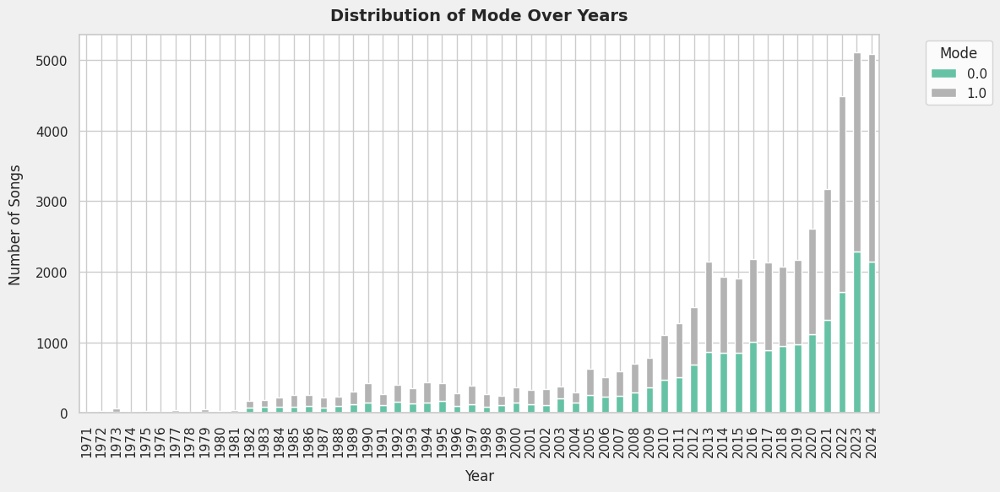

In [ ]:
spotify['year_only'] = spotify['year'].dt.year
spotify_counts = spotify.groupby(['year_only', 'mode']).size().unstack(fill_value=0)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12,6))
fig.patch.set_facecolor('#f0f0f0')
spotify_counts.plot(kind='bar',  stacked=True, colormap='Set2', ax=ax)
plt.title('Distribution of Mode Over Years', fontsize = 14, fontweight = 'bold', pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Number of Songs', labelpad = 10, fontsize = 12)
plt.legend(title='Mode', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

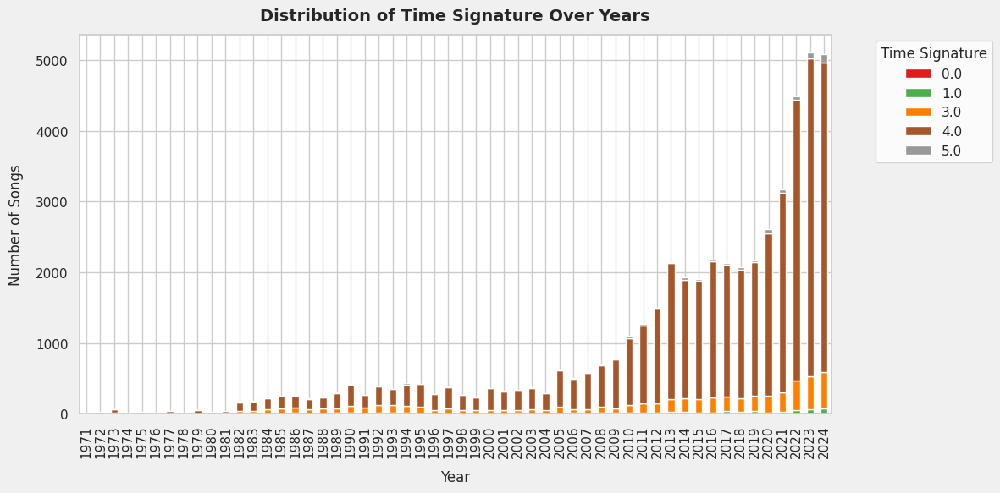

In [ ]:
spotify['year_only'] = spotify['year'].dt.year
spotify_counts = spotify.groupby(['year_only', 'time_signature']).size().unstack(fill_value=0)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12,6))
fig.patch.set_facecolor('#f0f0f0')
spotify_counts.plot(kind='bar',  stacked=True, colormap='Set1', ax=ax)
plt.title('Distribution of Time Signature Over Years', fontsize = 14, fontweight = 'bold', pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Number of Songs', labelpad = 10, fontsize = 12)
plt.legend(title='Time Signature', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

**Insights**

*   **Keys are broadly diversified but stable in aggregate :** All 12 pitch classes are represented each year with no decisive migration, and the mean key index stays near mid‑scale over time—hitmaking doesn’t hinge on specific keys.

*   **Time signature is overwhelmingly 4/4 :** The 4/4 bar dominates every year with only small growth in 3/4 and 5/4, confirming that rhythmic structure remains conventional despite genre changes.

*   **Major vs minor both scale with output :** Counts in both modes rise with overall volume, and the mean mode hovers around the major side without a strong directional trend—mood color from mode is secondary to production and groove.

##**II. Yearly trend analysis Categorical KPI's**

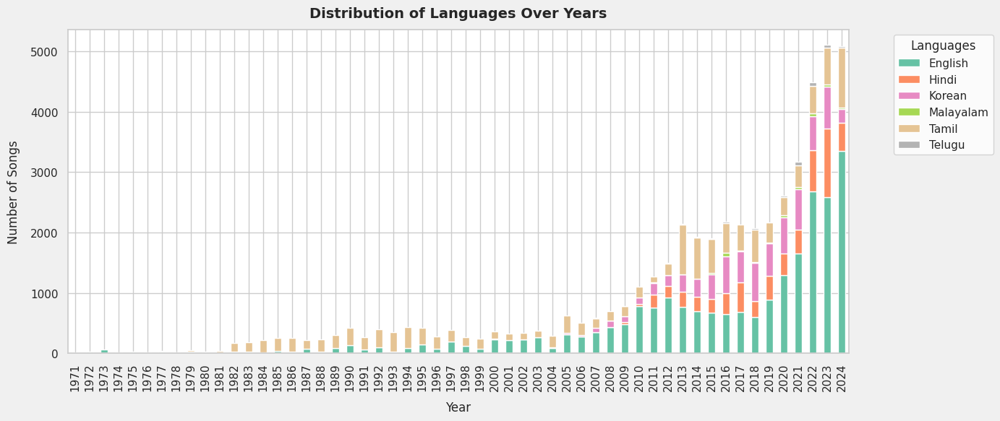

In [152]:
spotify['year_only'] = spotify['year'].dt.year

# Count number of songs per language each year
language_counts = (spotify.groupby(['year_only', 'language']).size().unstack(fill_value=0))

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(14,6), facecolor = ("#f0f0f0"))
language_counts.plot(kind='bar', stacked=True, ax=ax, colormap='Set2')

# Titles and labels
plt.title('Distribution of Languages Over Years', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Number of Songs', fontsize=12, labelpad=10)

# Legend outside the plot
plt.legend(title='Languages', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

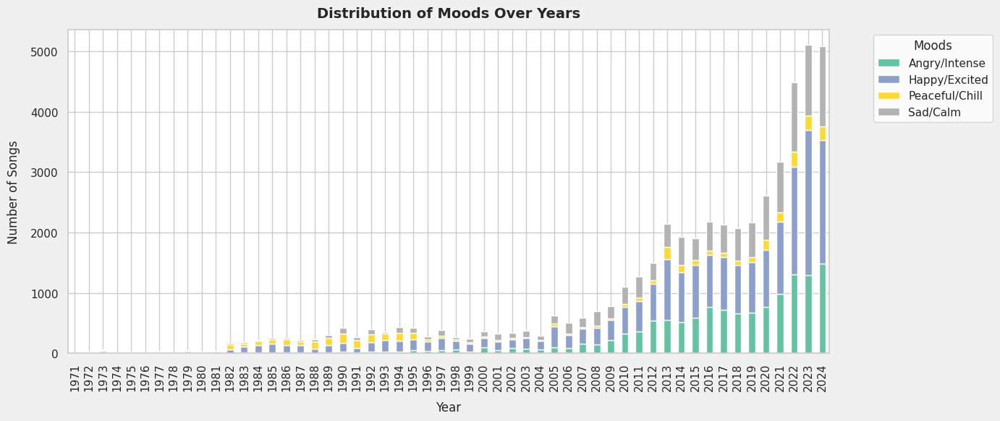

In [153]:
spotify['year_only'] = spotify['year'].dt.year

# Count number of songs per mood each year
mood_counts = (spotify.groupby(['year_only', 'mood']).size().unstack(fill_value=0))

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(14,6), facecolor = ("#f0f0f0"))
mood_counts.plot(kind='bar', stacked=True, ax=ax, colormap='Set2')

# Titles and labels
plt.title('Distribution of Moods Over Years', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Number of Songs', fontsize=12, labelpad=10)

# Legend outside the plot
plt.legend(title='Moods', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

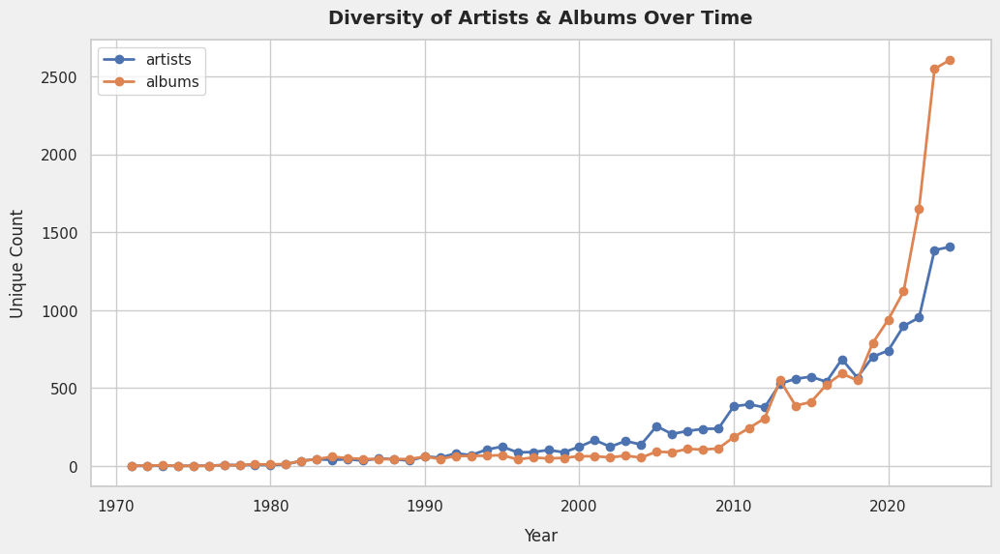

In [154]:
spotify['year_only'] = spotify['year'].dt.year
spotify_artists['year_only'] = spotify_artists['year'].dt.year

# Unique counts per year
diversity = pd.DataFrame({'artists': spotify_artists.groupby('year_only')['artist_name'].nunique(),'albums': spotify.groupby('year_only')['album_name'].nunique(),}).reset_index()

# Plot diversity over time
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
for col in ['artists', 'albums']:
    plt.plot(diversity['year_only'], diversity[col], marker='o', linewidth=2, label=col)

plt.title('Diversity of Artists & Albums Over Time', fontsize=14, fontweight='bold', pad = 12)
plt.xlabel('Year', fontsize=12, labelpad = 10)
plt.ylabel('Unique Count', fontsize=12, labelpad = 10)
plt.legend()
plt.grid(True)
plt.show()


**Insights**
*   **Catalog breadth has exploded since 2010 :** unique artists and albums grow super‑linearly, with albums surging especially after 2021—supply diversity is rising faster than artist headcount, signaling prolific multi‑release strategies and label catalog stuffing.

*   Language expansion is led by English, then rapid gains from Hindi, Korean, and Tamil post‑2015—global crossover is real, but English still contributes the largest absolute volume each year.

*   **Mood mix scales with output rather than rotating dominance :** Happy/Excited and Angry/Intense grow the most in count, while Peaceful/Chill remains a thinner slice; this supports prioritizing energetic and upbeat programming as the catalog expands.

##**III. Trends in Popularity Segments across Years**

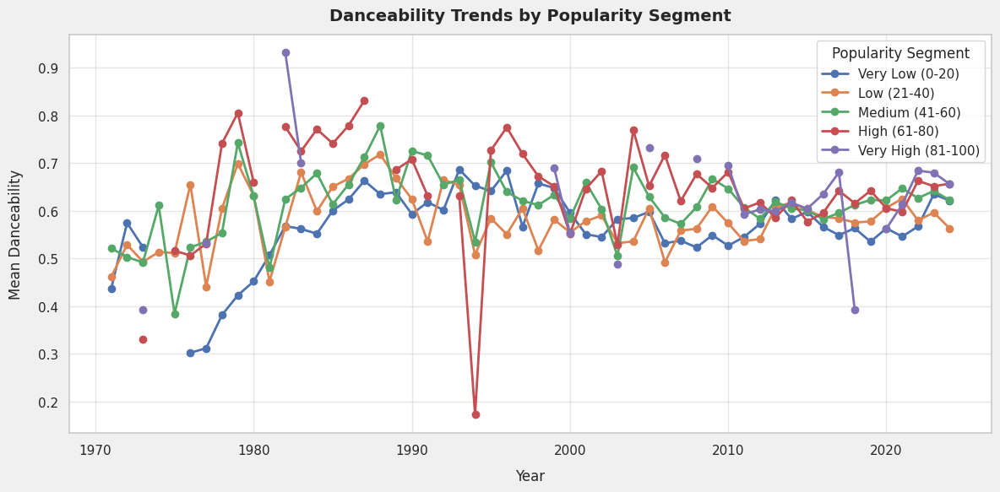

In [155]:
# Aggregate mean danceability by year and popularity segment
danceability_trend = (spotify.groupby(['year_only', 'popularity_segment'])['danceability'].mean().reset_index())

# Plot
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
for segment in danceability_trend['popularity_segment'].unique():
    data = danceability_trend[danceability_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['danceability'], marker='o', linewidth=2, label=segment)

plt.title('Danceability Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12,labelpad = 10)
plt.ylabel('Mean Danceability', fontsize=12, labelpad = 12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()


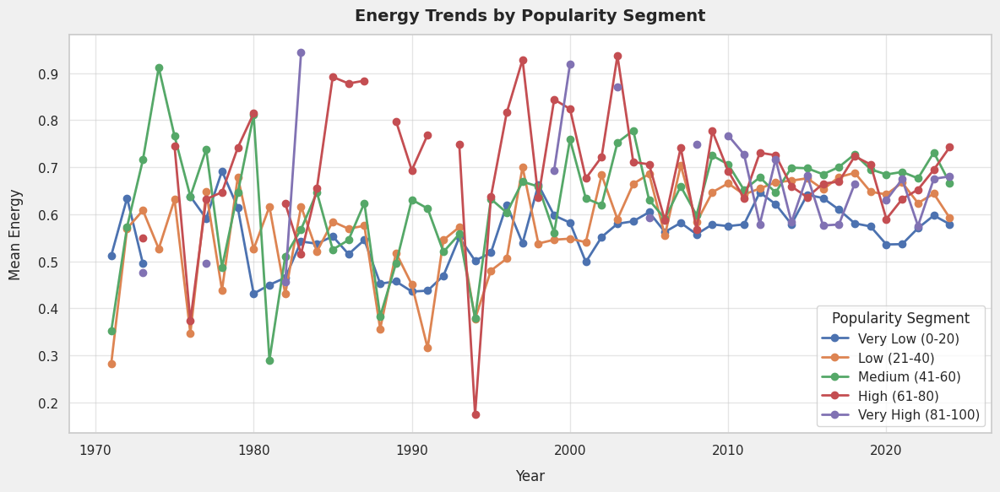

In [156]:
# Aggregate mean energy by year and popularity segment
energy_trend = (spotify.groupby(['year_only', 'popularity_segment'])['energy'].mean().reset_index())

# Plot
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
for segment in energy_trend['popularity_segment'].unique():
    data = energy_trend[energy_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['energy'], marker='o', linewidth=2, label=segment)

plt.title('Energy Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12,labelpad = 10)
plt.ylabel('Mean Energy', fontsize=12, labelpad = 12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()


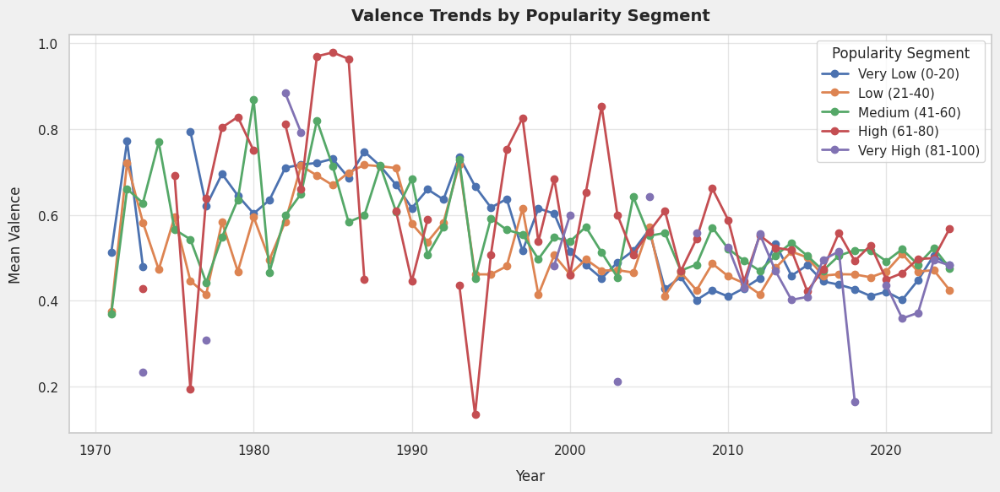

In [157]:
# Aggregate mean valence by year and popularity segment
valence_trend = (spotify.groupby(['year_only', 'popularity_segment'])['valence'].mean().reset_index())

# Plot
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
for segment in valence_trend['popularity_segment'].unique():
    data = valence_trend[valence_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['valence'], marker='o', linewidth=2, label=segment)

plt.title('Valence Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12,labelpad = 10)
plt.ylabel('Mean Valence', fontsize=12, labelpad = 12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()


**Insights**

*   Across all segments, energy trends upward since the 2000s while valence trends gently down, indicating modern hits win on intensity rather than brightness; danceability stays relatively stable to slightly rising, reinforcing movement as a constant.

*   **Segment gaps narrow in recent years :** By the 2010s–2020s, Very High, High, and Medium segments converge around energy ~0.65–0.7 and danceability ~0.6–0.65, suggesting format homogeneity at the top and less differentiation by these features alone.

*   **Early‑era volatility vs. present consistency :** 1970s–1990s curves show large swings across segments in all three metrics, whereas 2010s onward are smoother—production standardization and playlist optimization likely compress feature variance.

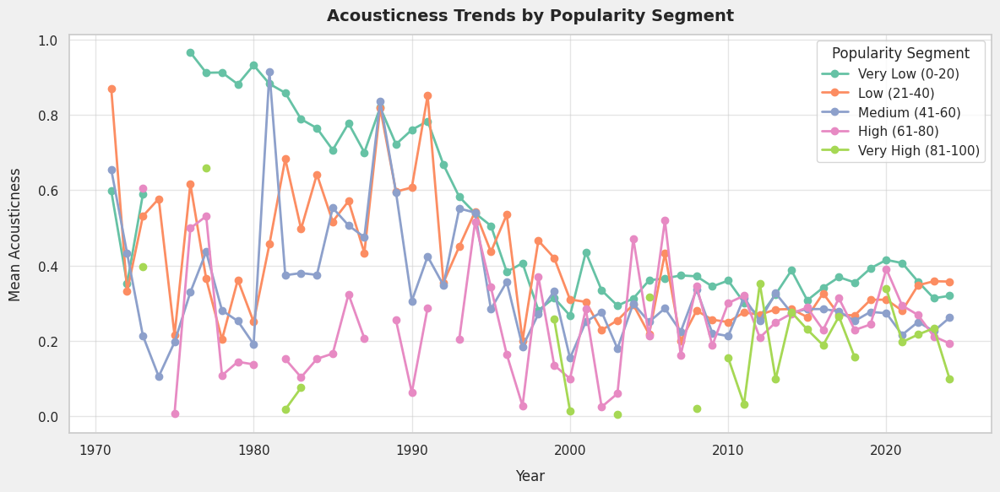

In [158]:
acousticness_trend = (spotify.groupby(['year_only', 'popularity_segment'])['acousticness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=acousticness_trend['popularity_segment'].nunique())

# Map each segment to a color from the palette
segments = acousticness_trend['popularity_segment'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = acousticness_trend[acousticness_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['acousticness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Acousticness Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Acousticness', fontsize=12, labelpad=12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

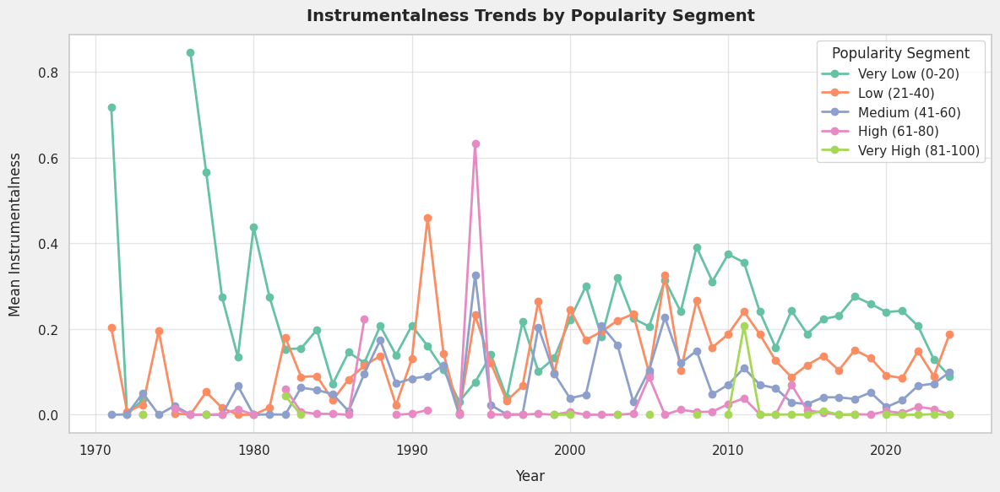

In [159]:
instrumentalness_trend = (spotify.groupby(['year_only', 'popularity_segment'])['instrumentalness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=instrumentalness_trend['popularity_segment'].nunique())

# Map each segment to a color from the palette
segments = instrumentalness_trend['popularity_segment'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = instrumentalness_trend[instrumentalness_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['instrumentalness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Instrumentalness Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Instrumentalness', fontsize=12, labelpad=12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

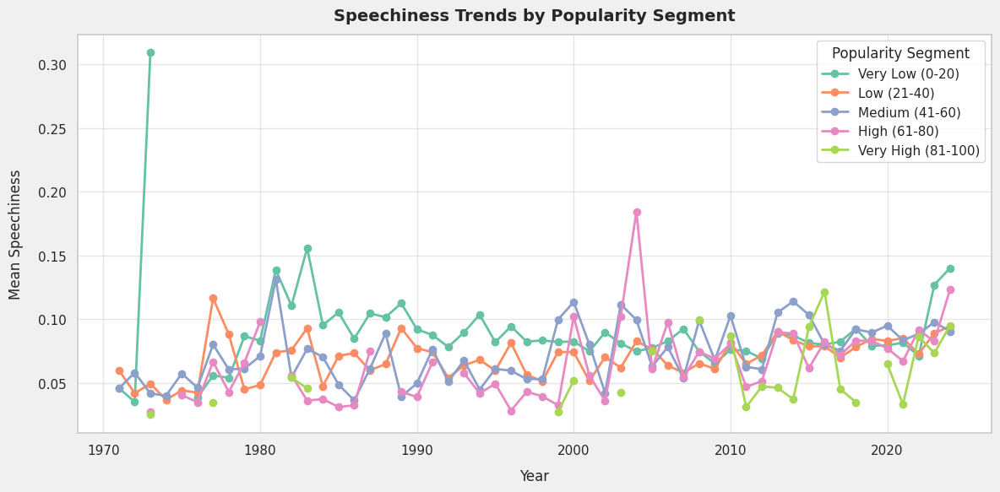

In [160]:
speechiness_trend = (spotify.groupby(['year_only', 'popularity_segment'])['speechiness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=speechiness_trend['popularity_segment'].nunique())

# Map each segment to a color from the palette
segments = speechiness_trend['popularity_segment'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = speechiness_trend[speechiness_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['speechiness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Speechiness Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Speechiness', fontsize=12, labelpad=12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

**Insights**
*   **Speechiness up, instrumentals down at the top :** Since the 2000s, Very High and High segments maintain low instrumentalness while showing mild recent upticks in speechiness, indicating vocal‑ and rap‑leaning hits, whereas very‑low segments carry most instrumental content.

*   **Acousticness convergence :** All segments trend toward lower acousticness from the 90s, then stabilize around ~0.25–0.35 post‑2010, reflecting consistent, polished, non‑acoustic production across popularity tiers.

*   **Segment separation signal :** In recent years, High/Very High tracks combine low instrumentalness with moderate acousticness and slightly elevated speechiness relative to Medium/Low—use this mix when optimizing for mainstream success.

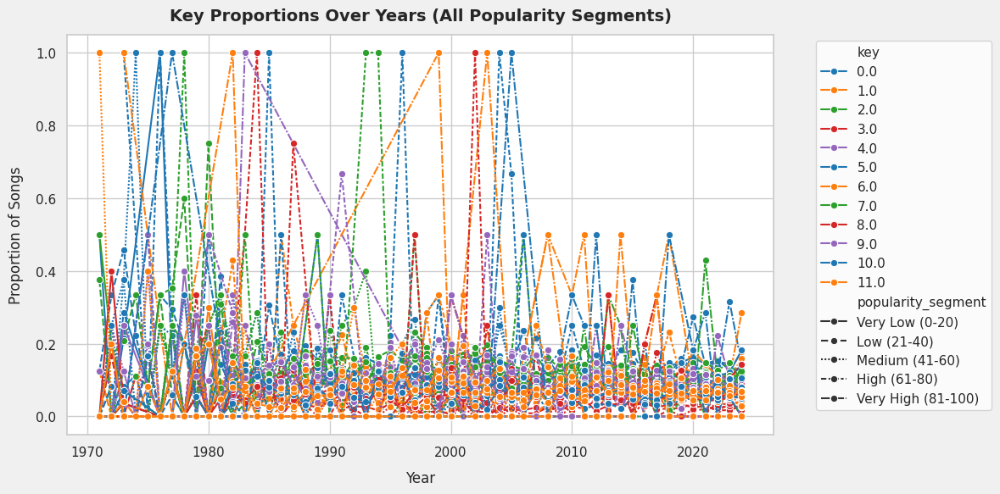

In [161]:
# Count songs per year, popularity_segment, and key
key_counts = (spotify.groupby(['year_only', 'popularity_segment', 'key']).size().reset_index(name='count'))
# Normalize counts within each year/popularity_segment
key_counts['proportion'] = key_counts.groupby(['year_only','popularity_segment'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=key_counts,x="year_only", y="proportion",hue="key", style="popularity_segment", marker="o",palette=colors)
plt.title("Key Proportions Over Years (All Popularity Segments)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

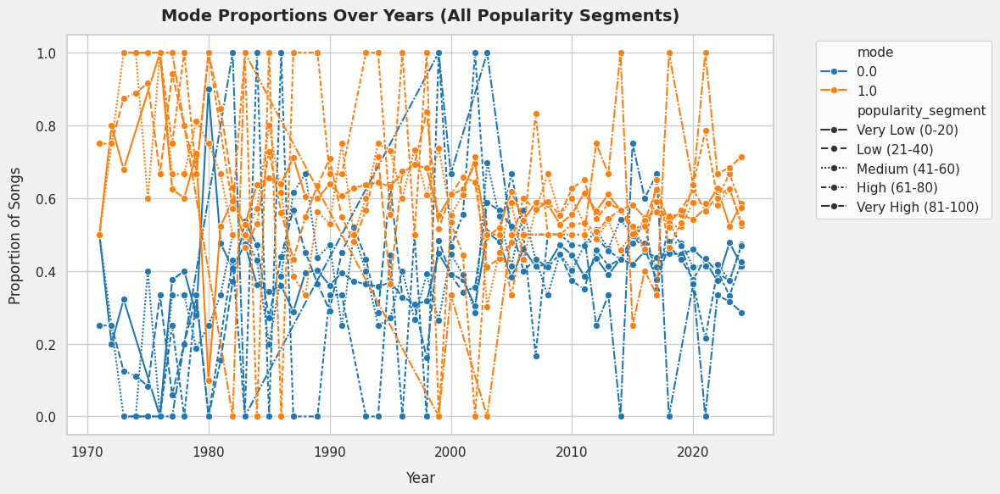

In [162]:
# Count songs per year, popularity_segment, and mode
mode_counts = (spotify.groupby(['year_only', 'popularity_segment', 'mode']).size().reset_index(name='count'))
# Normalize counts within each year/popularity_segment
mode_counts['proportion'] = mode_counts.groupby(['year_only','popularity_segment'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=mode_counts,x="year_only", y="proportion",hue="mode", style="popularity_segment", marker="o",palette=colors)
plt.title("Mode Proportions Over Years (All Popularity Segments)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

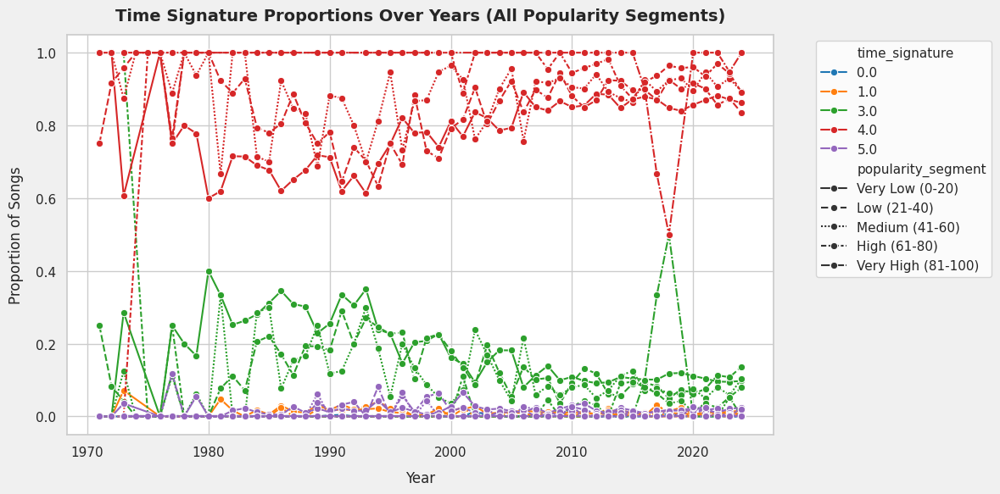

In [163]:
# Count songs per year, popularity_segment, and time_signature
time_signature_counts = (spotify.groupby(['year_only', 'popularity_segment', 'time_signature']).size().reset_index(name='count'))
# Normalize counts within each year/popularity_segment
time_signature_counts['proportion'] = time_signature_counts.groupby(['year_only','popularity_segment'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=time_signature_counts,x="year_only", y="proportion",hue="time_signature", style="popularity_segment", marker="o",palette=colors)
plt.title("Time Signature Proportions Over Years (All Popularity Segments)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

**Insights**

*   **Key proportions show no dominance :** All keys split relatively evenly within each popularity segment across years—no single key greatly outpaces others, and this holds true from lower to very high popularity, signaling creative tonal variety in hits.

*   **4/4 time signature is universal :** Over 80% of songs in every popularity bracket—especially medium, high, and very high—are in 4/4, with only minor representation for 3/4 and rare 5/4, confirming the centrality of standard meter in popular music.

*   **Major/minor mode doesn’t predict popularity :** Both modes (major = 1.0, minor = 0.0) are present in all popularity groups each year, with neither consistently leading—suggesting mode alone isn’t a differentiator for mainstream appeal or niche success.

##**IV. Trends in Languages across Years**

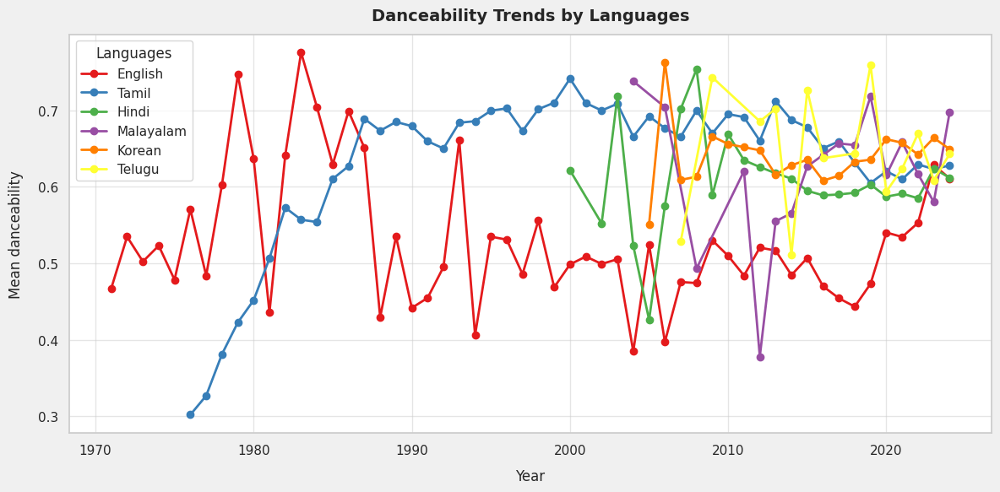

In [164]:
danceability_trend = (spotify.groupby(['year_only', 'language'])['danceability'].mean().reset_index())
palette = sns.color_palette("Set1", n_colors=danceability_trend['language'].nunique())

# Map each segment to a color from the palette
segments = danceability_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = danceability_trend[danceability_trend['language'] == segment]
    plt.plot(data['year_only'], data['danceability'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Danceability Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean danceability', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

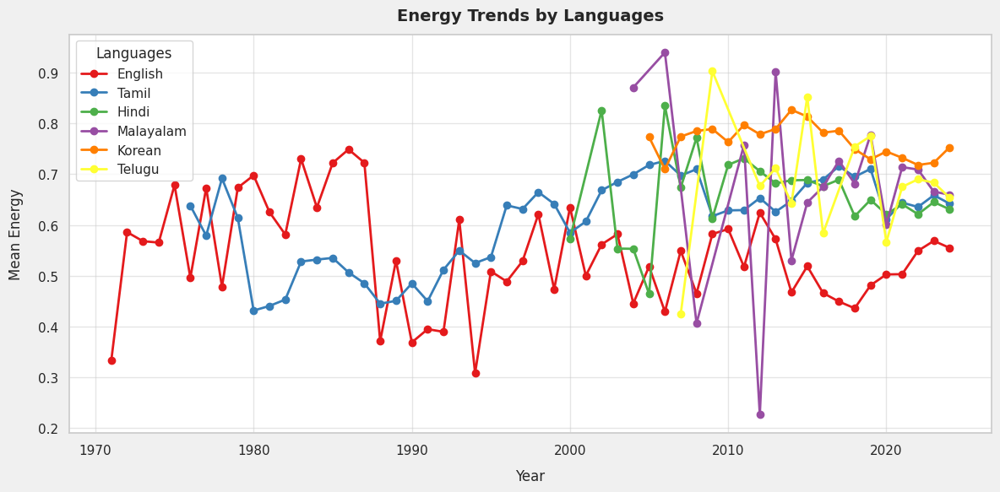

In [165]:
energy_trend = (spotify.groupby(['year_only', 'language'])['energy'].mean().reset_index())
palette = sns.color_palette("Set1", n_colors=energy_trend['language'].nunique())

# Map each segment to a color from the palette
segments = energy_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = energy_trend[energy_trend['language'] == segment]
    plt.plot(data['year_only'], data['energy'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Energy Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Energy', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

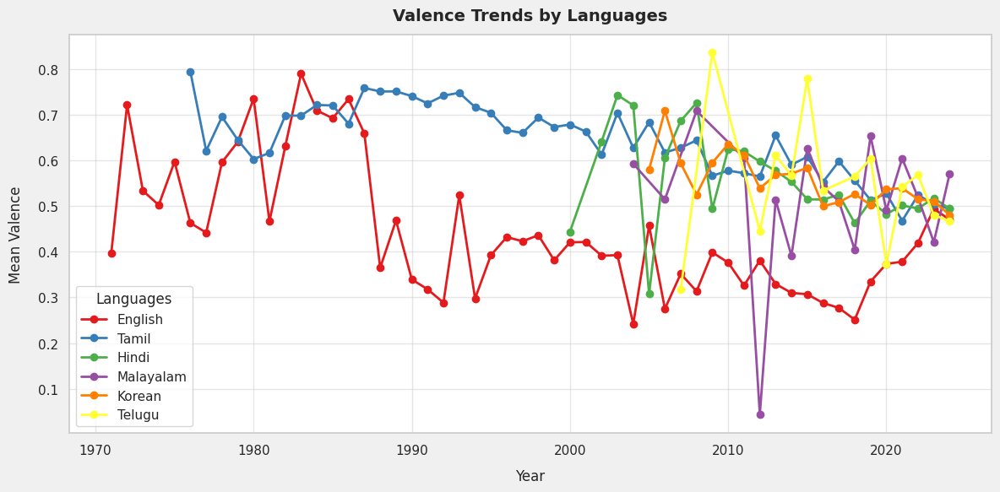

In [166]:
valence_trend = (spotify.groupby(['year_only', 'language'])['valence'].mean().reset_index())
palette = sns.color_palette("Set1", n_colors=valence_trend['language'].nunique())

# Map each segment to a color from the palette
segments = valence_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = valence_trend[valence_trend['language'] == segment]
    plt.plot(data['year_only'], data['valence'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Valence Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Valence', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

**Insights**
*   **High-energy leaders :** Korean and Telugu maintain the highest recent energy (>0.7 mid‑2010s; ~0.65–0.75 in 2020s), with Malayalam spiking earlier but normalizing—use these for hype and workout sets.

*   **Danceability edge :** Tamil stabilizes around ~0.65–0.7 since the 1990s, with Korean and Telugu close behind post‑2010; English trails at ~0.5–0.6—Tamil is the safest bet for sustained movement.

*   **Valence split :** English trends lower in valence since the 2000s (0.3–0.5), while Tamil stays higher (0.6–0.7 historically) and Korean/Telugu cluster mid (~0.5–0.6)—pair English for moody energy, Tamil for feel‑good, and Korean/Telugu for balanced uplift.

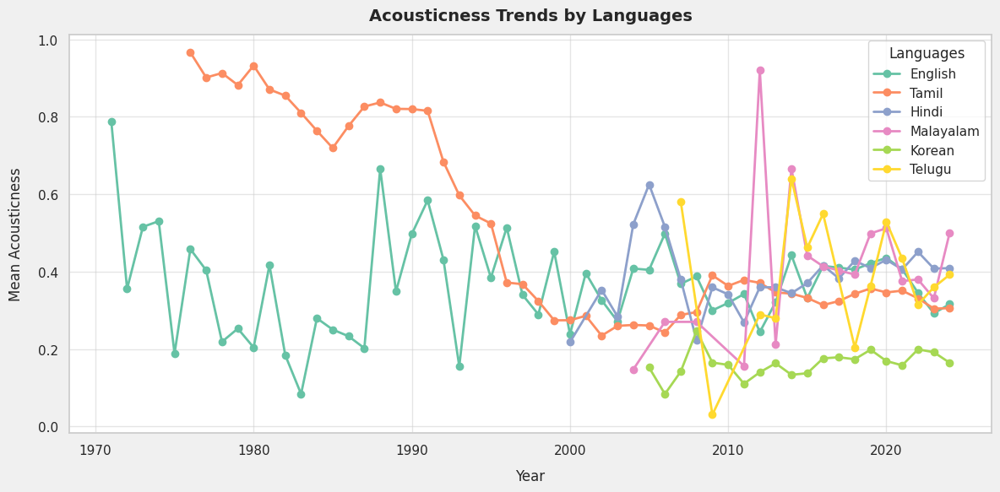

In [167]:
acousticness_trend = (spotify.groupby(['year_only', 'language'])['acousticness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=acousticness_trend['language'].nunique())

# Map each segment to a color from the palette
segments = acousticness_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = acousticness_trend[acousticness_trend['language'] == segment]
    plt.plot(data['year_only'], data['acousticness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Acousticness Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Acousticness', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

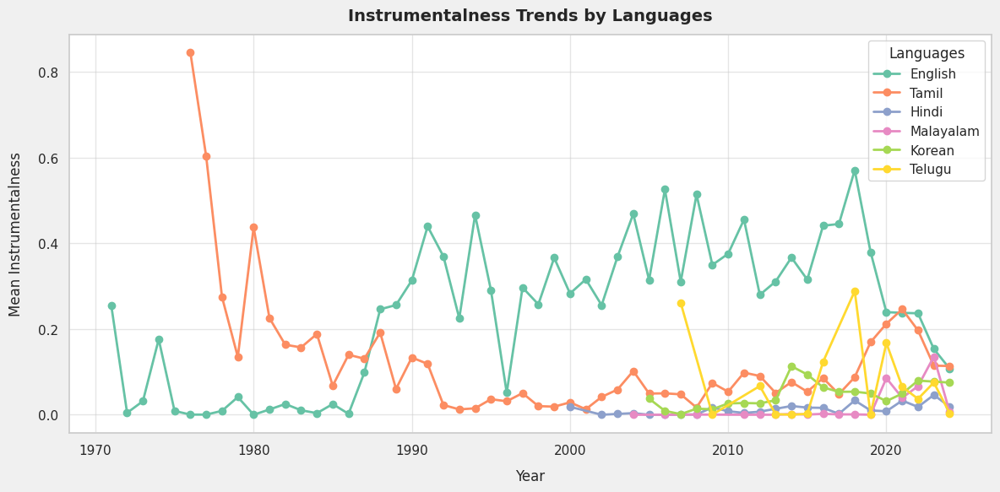

In [168]:
instrumentalness_trend = (spotify.groupby(['year_only', 'language'])['instrumentalness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=instrumentalness_trend['language'].nunique())

# Map each segment to a color from the palette
segments = instrumentalness_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = instrumentalness_trend[instrumentalness_trend['language'] == segment]
    plt.plot(data['year_only'], data['instrumentalness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Instrumentalness Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Instrumentalness', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

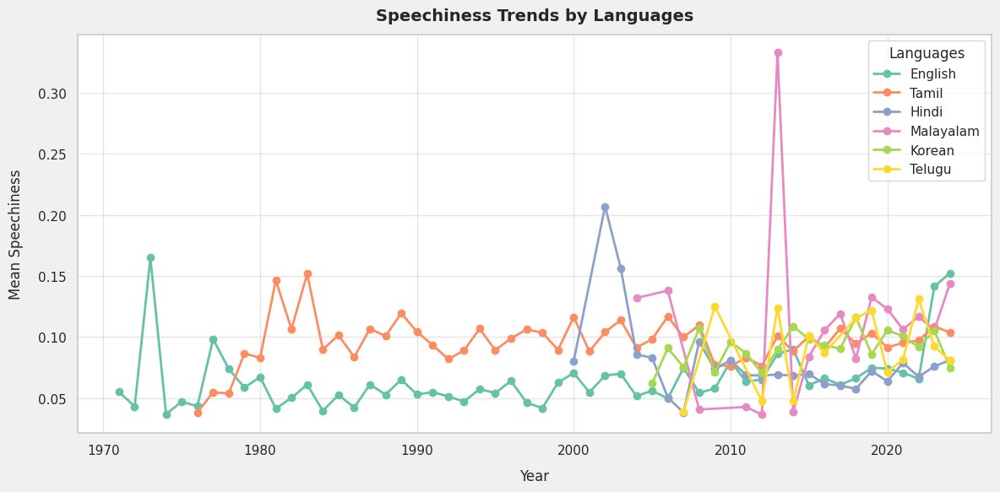

In [169]:
speechiness_trend = (spotify.groupby(['year_only', 'language'])['speechiness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=speechiness_trend['language'].nunique())

# Map each segment to a color from the palette
segments = speechiness_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = speechiness_trend[speechiness_trend['language'] == segment]
    plt.plot(data['year_only'], data['speechiness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Speechiness Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Speechiness', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

**Insights**
*   **Rap/talk elements are rising across the board :** Since ~2010, speechiness drifts upward in Korean, Telugu, and Malayalam while English/Tamil stay mid‑low; Hindi shows an early‑2000s spike but normalizes—expect more vocal presence and rap features in non‑English catalogs.

*   **Instrumentals are rare outside English and trending lower :** English has the highest and most volatile instrumentalness, peaking around the 2010s, whereas Tamil/Hindi/Korean remain near zero—vocal‑led tracks dominate Asian‑language hits.

*   **Production convergence on low acousticness :** Tamil falls from very high acousticness in the 80s–90s toward ~0.3–0.4, English sits mid (~0.3–0.5), and Korean is consistently low (~0.15–0.25); recent Telugu/Malayalam fluctuate but center near modern, processed textures—use Korean for slick electronic polish, Tamil for balanced organic‑modern blends.

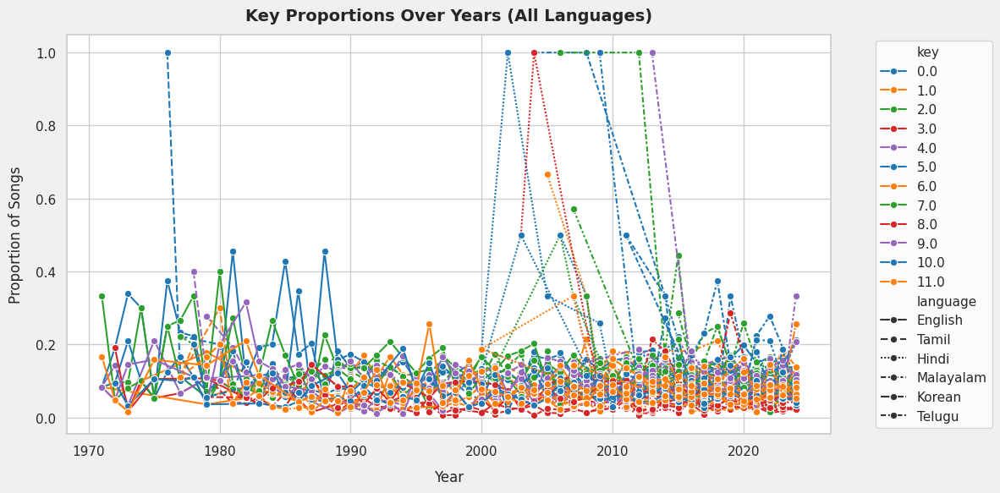

In [170]:
# Count songs per year, language, and key
key_counts = (spotify.groupby(['year_only', 'language', 'key']).size().reset_index(name='count'))
# Normalize counts within each year/language
key_counts['proportion'] = key_counts.groupby(['year_only','language'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=key_counts,x="year_only", y="proportion",hue="key", style="language", marker="o",palette=colors)
plt.title("Key Proportions Over Years (All Languages)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

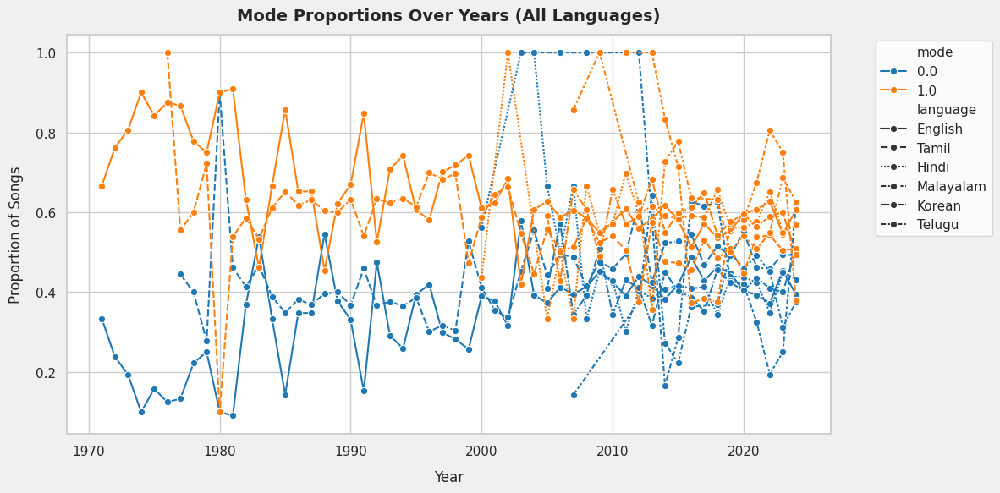

In [171]:
# Count songs per year, language, and mode
mode_counts = (spotify.groupby(['year_only', 'language', 'mode']).size().reset_index(name='count'))
# Normalize counts within each year/language
mode_counts['proportion'] = mode_counts.groupby(['year_only','language'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=mode_counts,x="year_only", y="proportion",hue="mode", style="language", marker="o",palette=colors)
plt.title("Mode Proportions Over Years (All Languages)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

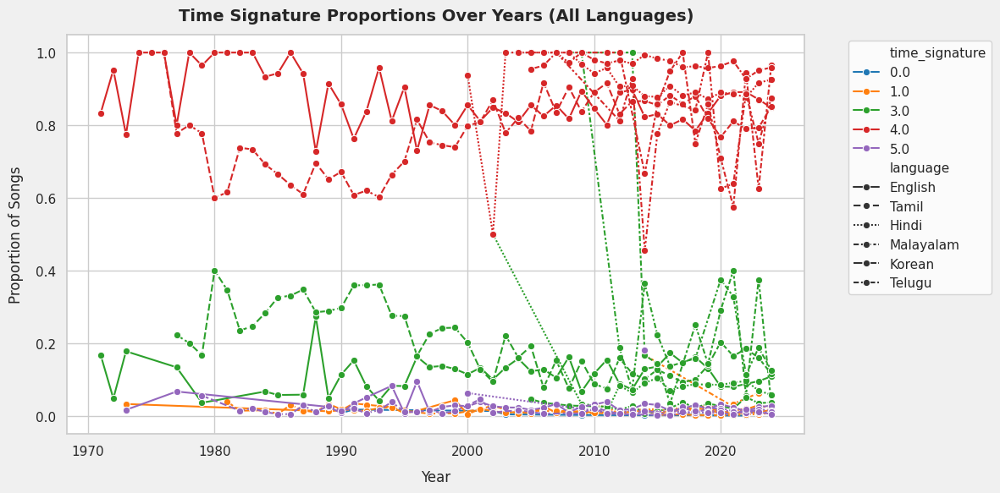

In [172]:
# Count songs per year, language, and time_signature
time_signature_counts = (spotify.groupby(['year_only', 'language', 'time_signature']).size().reset_index(name='count'))
# Normalize counts within each year/language
time_signature_counts['proportion'] = time_signature_counts.groupby(['year_only','language'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=time_signature_counts,x="year_only", y="proportion",hue="time_signature", style="language", marker="o",palette=colors)
plt.title("Time Signature Proportions Over Years (All Languages)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

**Insights**

*   **No language or era dominates key choice :** The proportional use of each key remains widely distributed among all languages with no clear long-term bias; each language’s catalog is musically diverse, and there’s no “hitmaking” key in any language.

*   **Major mode (mode=1) is favored, but the split is stable :** Across all languages, about 55–65% of songs tend to be in major, with the remainder in minor, and this balance remains steady since the 1990s—feel-good and moody tracks coexist without dramatic shifts in preference.

*   **Universal dominance of 4/4 :** All languages overwhelmingly default to 4/4 time, with minor but persistent use of 3/4 and 5/4 in some catalogs; rhythm conventions are global, forming the backbone of mainstream music regardless of language.

#**11. Exploratory Data Analysis - Top N & Bottom N Analysis**

*   Visualizing top 10 Tracks in terms of Numerical KPI's.

In [173]:
# -----------------------------
# Function to plot Top/Bottom 10 with custom wrap width
# -----------------------------
def plot_top_bottom(df, column, top=True, n=10, wrap_width=25):
    """
    Plot Top or Bottom tracks based on a given column.
    Allows custom text wrapping for long track names.

    Parameters:
    df : DataFrame
    column : str -> numerical column to rank
    top : bool -> True = Top n, False = Bottom n
    n : int -> number of tracks to show
    wrap_width : int -> max characters per line in track names
    """
    # Sorting
    if top:
        result = df.sort_values(by=column, ascending=False).head(n)
        title = f"Top {n} Tracks by {column.capitalize()}"
    else:
        result = df.sort_values(by=column, ascending=True).head(n)
        title = f"Bottom {n} Tracks by {column.capitalize()}"

    # Wrap track names
    result = result.copy()
    result["track_name_wrapped"] = result["track_name"].apply(lambda x: "\n".join(textwrap.wrap(str(x), wrap_width)))

    # Plot
    plt.figure(figsize=(12,6), facecolor="#f0f0f0")
    sns.barplot(data=result,y="track_name_wrapped",x=column,hue="artist_name",dodge=False,palette="Set1")
    plt.title(title, fontsize=14, pad=12, fontweight='bold')
    plt.xlabel(column.capitalize(), labelpad=10, fontsize=12)
    plt.ylabel("Track Name", labelpad=10, fontsize=12)
    plt.legend([], [], frameon=False)  # remove cluttered legend
    plt.tight_layout()
    plt.show()

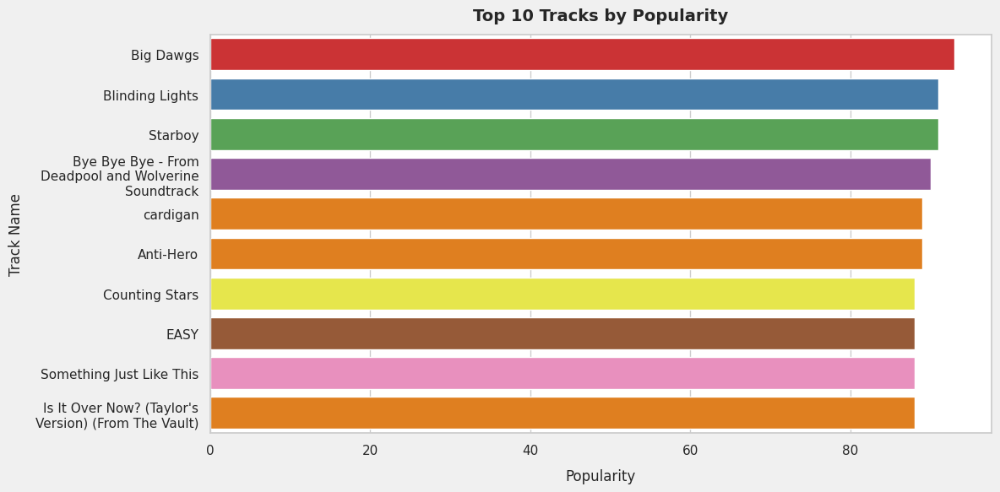

In [174]:
# Popularity
plot_top_bottom(spotify, "popularity", top=True)

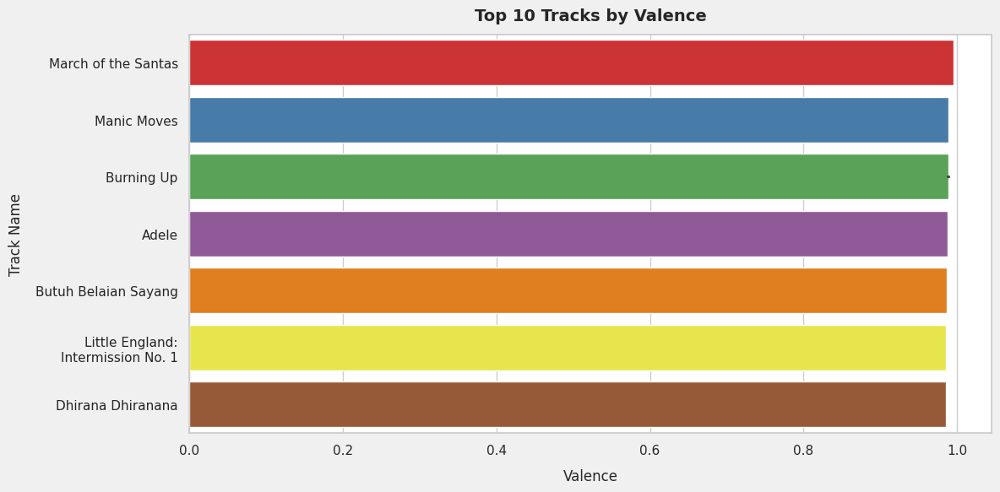

In [175]:
plot_top_bottom(spotify, "valence", top=True)

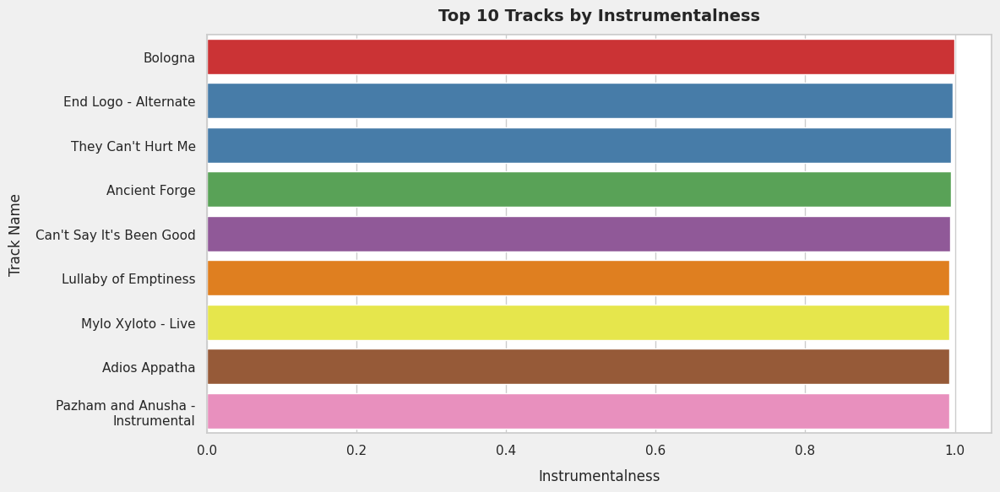

In [176]:
plot_top_bottom(spotify, "instrumentalness", top=True)

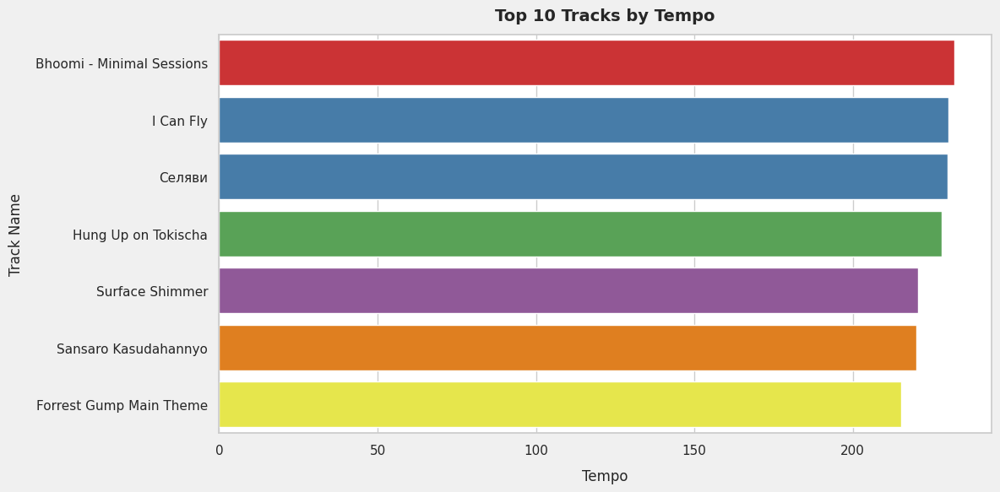

In [177]:
plot_top_bottom(spotify, "tempo", top=True)

**Insights**

*   The top tracks for instrumentalness are purely or almost entirely instrumental, with scores near 1.0, indicating no or minimal vocals.

*   The top tracks for valence are consistently near the maximum (1.0), reflecting extreme happiness or positivity in musical mood.

*   Tracks ranking highest in tempo are uniformly fast-paced, each with tempos exceeding 200 BPM, making them especially energetic and suited for dance or action-oriented playlists.

*   The most popular tracks list aligns with global chart success, featuring international hits and crowd favorites that maintain high, but not extreme, values across musical features—indicating broad mainstream appeal.

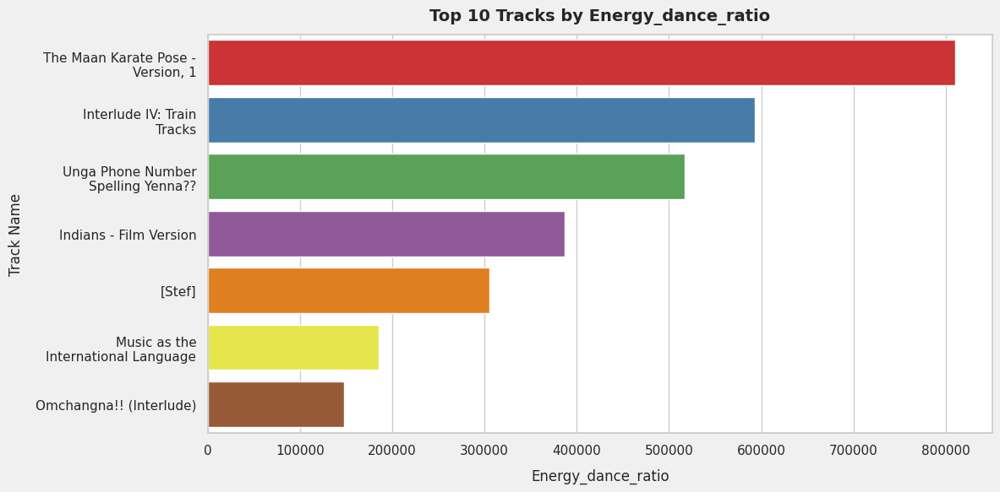

In [178]:
# Energy/Dance Ratio
plot_top_bottom(spotify, "energy_dance_ratio", top=True)

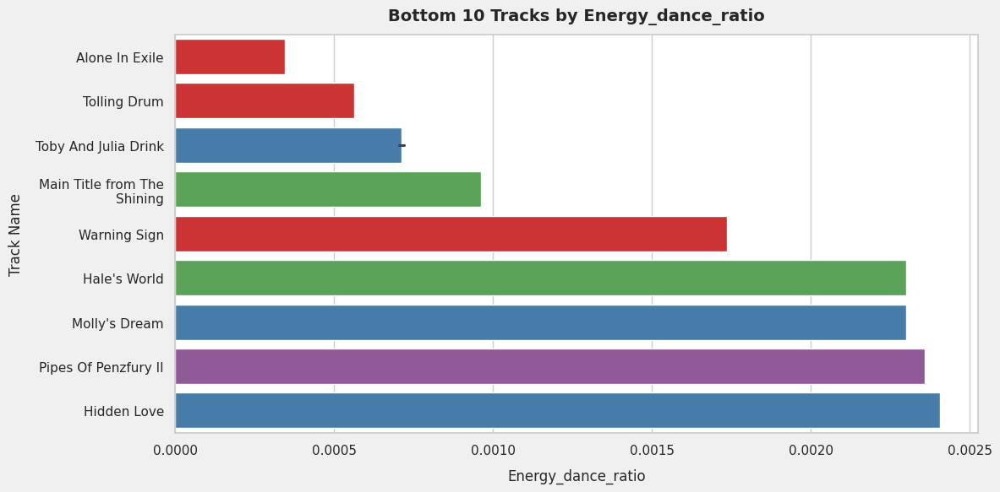

In [179]:
plot_top_bottom(spotify, "energy_dance_ratio", top=False)

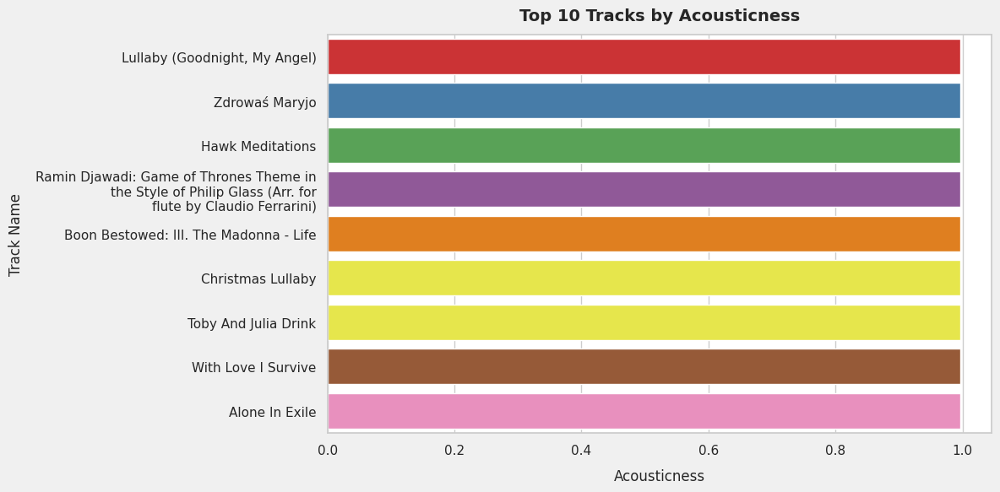

In [180]:
# Acousticness
plot_top_bottom(spotify, "acousticness", top=True, wrap_width=40)

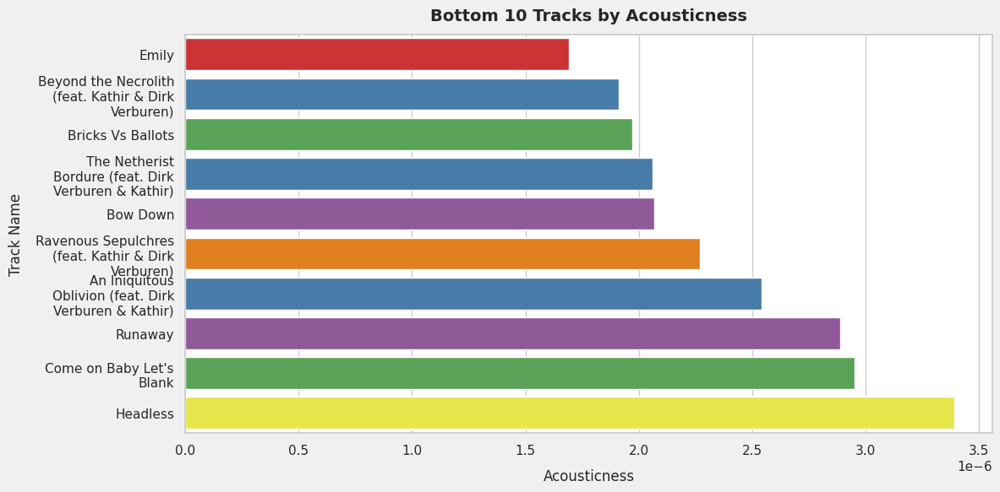

In [181]:
plot_top_bottom(spotify, "acousticness", top=False, wrap_width = 20)

**Insights**

*   Tracks with the lowest acousticness are highly electronic or synthetic, showing almost no “unplugged” qualities—these are typically modern, heavily-produced works in genres like electronic, industrial, or synthetic pop.

*   The highest energy-to-danceability ratios belong to short tracks and interludes; these tracks have extremely concentrated bursts of energy relative to dance features, standing apart from typical songs where the ratio is far lower.

*   Tracks with the lowest energy-to-danceability ratios are slow, atmospheric, or cinematic—these tend to be instrumental, lullaby, or film score tracks, where mood or ambiance dominates over movement.

*   The most acoustic tracks are classical or meditative—flute, lullabies, or soft instrumental pieces, with “organic” sound and minimal production, ideal for relaxation, sleep, or introspection.

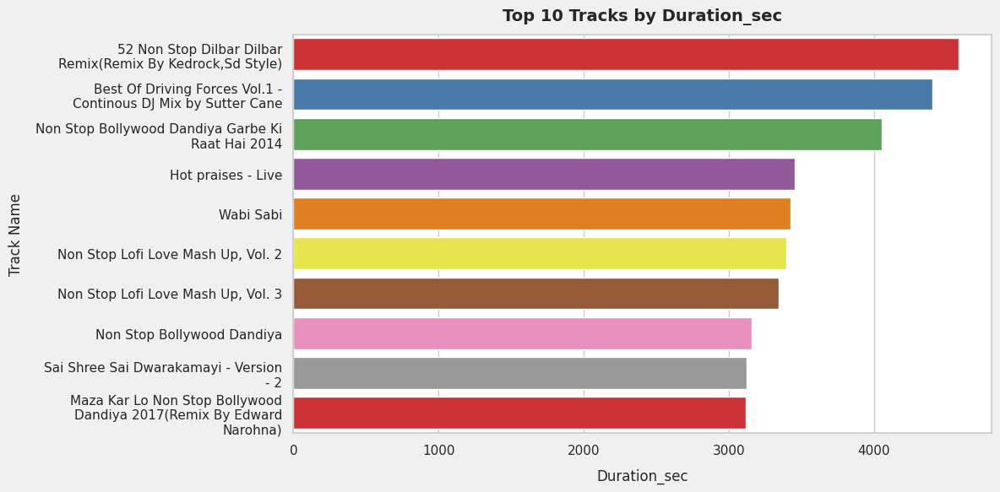

In [182]:
plot_top_bottom(spotify, "duration_sec", top=True, wrap_width=35)

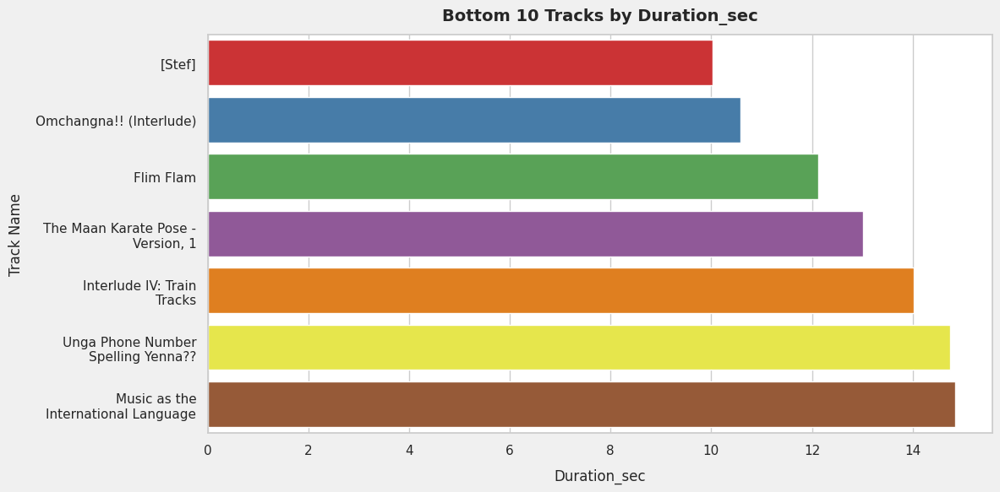

In [183]:
plot_top_bottom(spotify, "duration_sec", top=False)

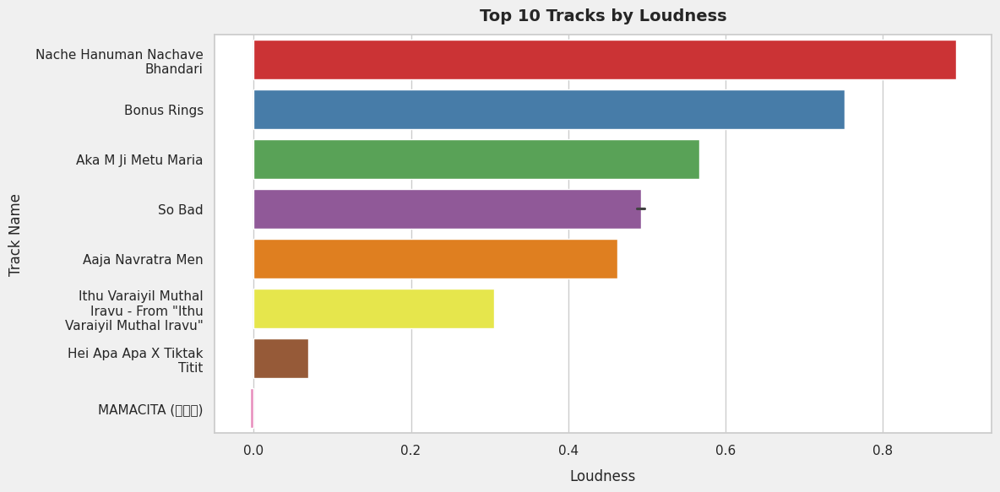

In [184]:
plot_top_bottom(spotify, "loudness", top=True)

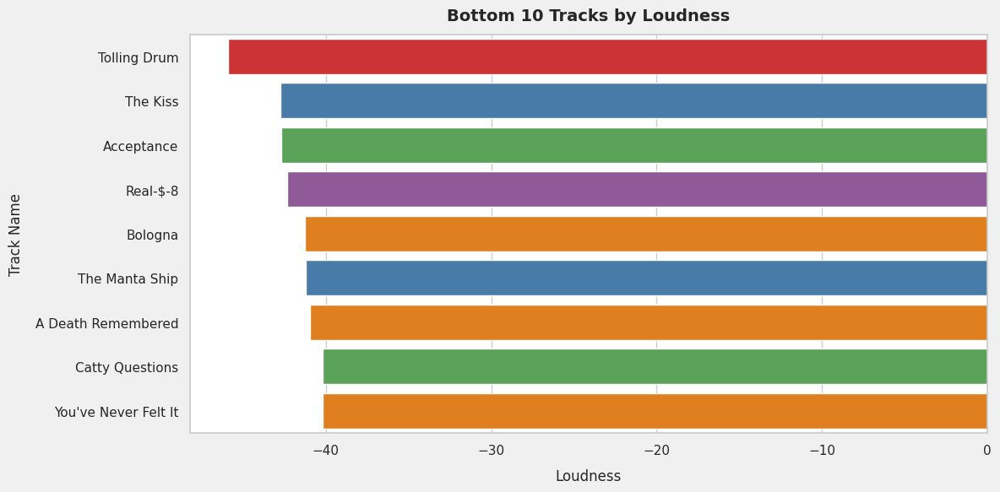

In [185]:
plot_top_bottom(spotify, "loudness", top=False)

**Insights**

*   The loudest tracks range widely, with the highest reaching near maximum loudness and the lowest not far behind, illustrating some presence of loudness maximization in popular music for impact.

*   The quietest tracks fall into very low loudness values (strong negative range), indicating ambient or minimally produced sounds, often soft or atmospheric, contrasting strongly with loud mainstream hits.

*   Long-duration tracks are mostly remixes, live recordings, or continuous mashups, explaining unusual lengths well over typical song duration caps around 3-5 minutes.

*   Very short tracks are almost all interludes, skits, or brief thematic pieces, showing a stark contrast with long tracks and illustrating diversity in album construction throughout the dataset.

#**12. Exploratory Data Analysis - Some Hypothetical Analysis**

*   Mood Profiling: Energy vs Valence.
*   Do Longer Songs Stay Popular?
*   Do Happier Songs Get Popular?
*   Audio Fingerprint: Top vs Bottom Popular Track.

In [186]:
# 1. Mood/Vibe Profiling (Energy vs Valence Scatterplot)
def plot_energy_valence_scatter(df):
    plt.figure(figsize=(8,6), facecolor="#f0f0f0")
    sns.scatterplot(data=df, x="energy", y="valence", size="popularity", hue="danceability", palette="coolwarm", alpha=0.7, edgecolor="k", linewidth=0.5)
    plt.title("Mood Profiling: Energy vs Valence", fontsize=14, fontweight='bold', pad = 12)
    plt.xlabel("Energy", labelpad = 10, fontweight = 12)
    plt.ylabel("Valence (Happiness)", labelpad = 10, fontweight = 12)
    plt.legend(title="Danceability", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# 2. Longest vs Shortest Popular Tracks (Duration vs Popularity)
def plot_duration_vs_popularity(df):
    plt.figure(figsize=(10,6), facecolor="#f0f0f0")
    sns.scatterplot(data=df, x="duration_sec", y="popularity", hue="artist_name", alpha=0.7, legend=False)
    plt.title("Do Longer Songs Stay Popular?", fontsize=14, fontweight='bold', pad = 12)
    plt.xlabel("Duration (sec)", fontsize= 12, labelpad = 10)
    plt.ylabel("Popularity", fontsize =12, labelpad = 10)
    plt.tight_layout()
    plt.show()

# 3. Popularity vs Features (Valence Example)
def plot_popularity_vs_valence(df):
    plt.figure(figsize=(9,6), facecolor="#f0f0f0")
    sns.regplot(data=df, x="valence", y="popularity", scatter_kws={"alpha":0.6}, line_kws={"color":"red"})
    plt.title("Do Happier Songs Get Popular?", fontsize=14, fontweight='bold', pad = 12)
    plt.xlabel("Valence (Happiness)", fontsize = 12, labelpad = 10)
    plt.ylabel("Popularity", fontsize =12, labelpad = 10)
    plt.tight_layout()
    plt.show()

# 4. Audio Fingerprint Radar Chart (Top 1 vs Bottom 1 Popularity)
def plot_radar_chart(df):
    # pick top and bottom
    top_track = df.sort_values("popularity", ascending=False).iloc[0]
    bottom_track = df.sort_values("popularity", ascending=True).iloc[0]

    # features to include
    features = ["energy", "danceability", "valence", "acousticness", "speechiness"]
    top_values = [top_track[f] for f in features]
    bottom_values = [bottom_track[f] for f in features]

    # radar setup
    N = len(features)
    angles = np.linspace(0, 2*np.pi, N, endpoint=False).tolist()
    top_values += top_values[:1]  # close the loop
    bottom_values += bottom_values[:1]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(7,7), subplot_kw=dict(polar=True), facecolor = ("#f0f0f0"))
    ax.set_theta_offset(np.pi/2)
    ax.set_theta_direction(-1)

    # draw labels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(features, fontsize=11)

    # plot top
    ax.plot(angles, top_values, color="green", linewidth=2, label=f"Top Track: {top_track['track_name']}")
    ax.fill(angles, top_values, color="green", alpha=0.25)

    # plot bottom
    ax.plot(angles, bottom_values, color="red", linewidth=2, label=f"Bottom Track: {bottom_track['track_name']}")
    ax.fill(angles, bottom_values, color="red", alpha=0.25)

    plt.title("Audio Fingerprint: Top vs Bottom Popular Track", fontsize=14, fontweight="bold", pad=40)
    plt.legend(loc="upper right", bbox_to_anchor=(1.3, 1.1))
    plt.show()

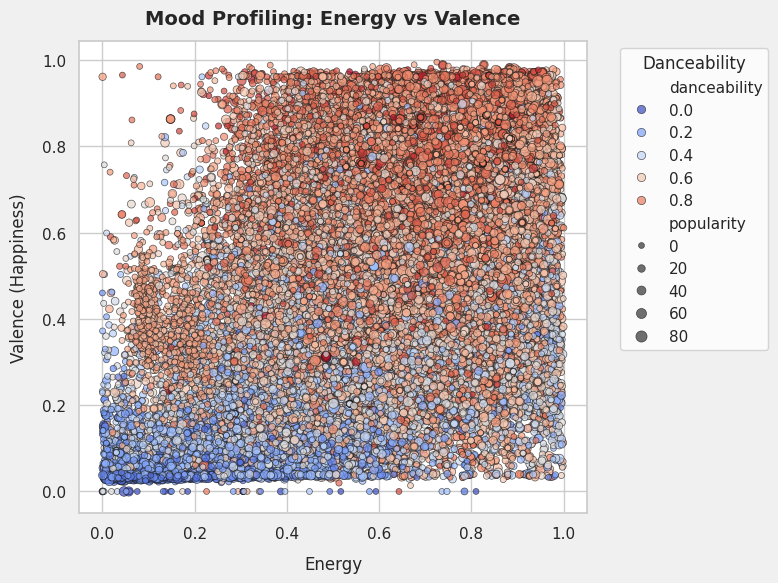

In [187]:
plot_energy_valence_scatter(spotify)

**Insights**

* Mood profile visualization shows the music catalog spanning the full ranges of energy and valence, with higher danceability tracks more densely populating the region of moderate to high energy and valence, reflecting a preference for upbeat and danceable tunes among popular songs.

*   The plot confirms a wide distribution of tracks from low-energy, low-valence (calm or sad) to high-energy, high-valence (excited, happy) moods, highlighting the diversity of emotional content in the catalog.

*   Popular songs (indicated by darker/bigger points) tend to cluster at medium to high levels of both energy and valence, reinforcing that energetic, happy tracks dominate mainstream popularity. Lower danceability tracks (lighter blue points) are scattered more broadly across the mood space, often with lower energy and valence, suggesting niche or less commercially-oriented content.

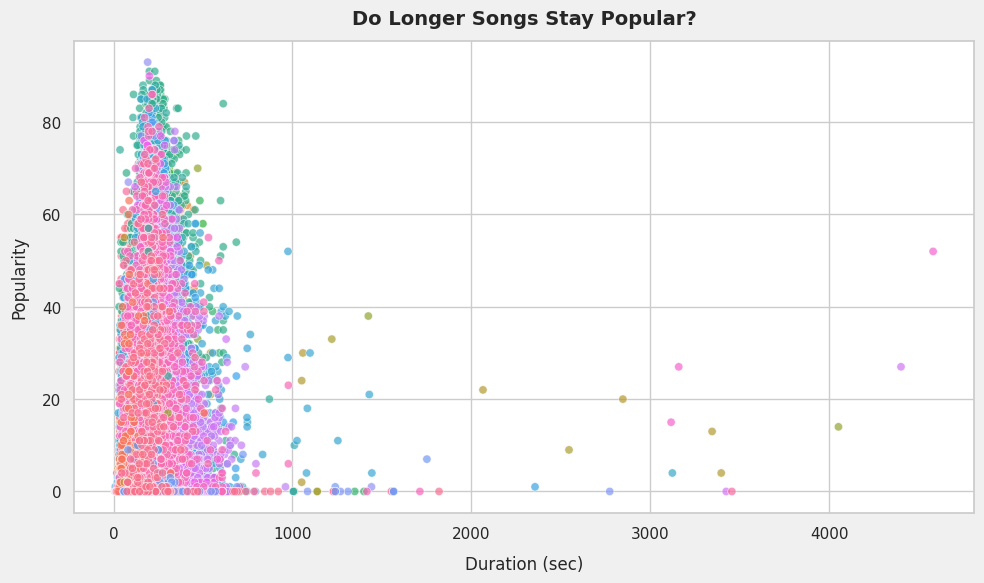

In [188]:
plot_duration_vs_popularity(spotify)

**Insights**

*   The cluster of tracks with the highest popularity (80–100) overwhelmingly falls within a duration of roughly 2 to 5 minutes (120–300 seconds), showing that mainstream hits are almost never long-form tracks.

*   As duration increases beyond approximately 7–8 minutes (500 seconds), the likelihood of high popularity drops sharply—very long tracks (e.g., DJ mixes, live sets) exist but almost never reach high chart status.

*   Short, conventional durations dominate popular music, suggesting listener, radio, and playlist-friendly lengths are essential for commercial success, while longer durations are generally associated with niche, experimental, or non-mainstream content.

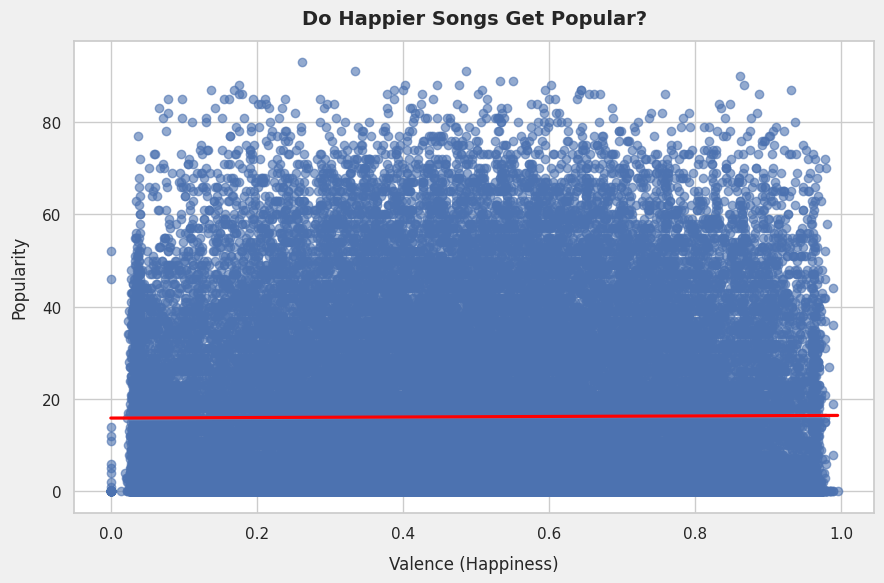

In [189]:
plot_popularity_vs_valence(spotify)

**Insights**

*   Popularity is widely distributed across the full range of valence (happiness) values, indicating that both happy and sad songs can succeed—no single happiness level guarantees popularity.

*   There is no strong upward or downward trend; highly popular tracks (popularity 80–100) are found at all valence levels, from the most somber to the most joyful.

*   The average popularity line (in red) remains almost flat relative to valence, confirming that “happiness” alone is not a key predictor for a song’s commercial success—other factors (like artist profile, marketing, or genre) play a more decisive role.

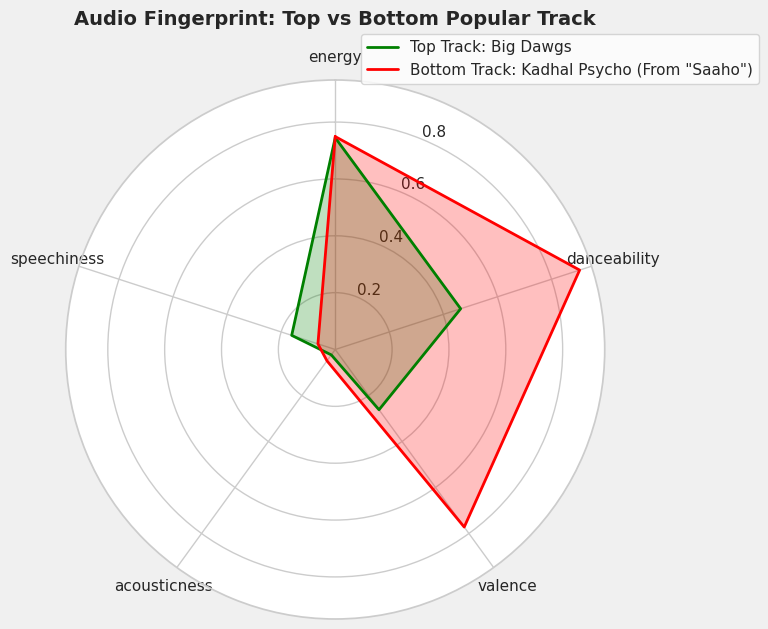

In [190]:
plot_radar_chart(spotify)

**Insights**

*   The radar plot compares the audio features of the most popular track ("Big Dawgs") vs the least popular track ("Kadhal Psycho" from "Saaho").

*   Both tracks have very high energy, though "Kadhal Psycho" is slightly higher.

*   The least popular track ("Kadhal Psycho") has much higher danceability and valence (happiness) compared to the popular track.

*   The popular track ("Big Dawgs") has higher speechiness, suggesting more vocal or rap elements.

*   Acousticness is low for both tracks, indicating studio-produced sound rather than acoustic or unplugged quality.

*   Overall, danceability and valence alone do not guarantee popularity; other features like speechiness and balance in energy are important differentiators.

#**13. Final Recommendation**

##**Strategic Music Direction**

*   Target the hit zone with concise, punchy records: 2.7–4.3 minutes, mid‑to‑fast grooves around 100–130 BPM, and assertive masters clustering near −6 to −4 dBFS where top‑popularity points concentrate.

*   Keep energy and danceability balanced in the mid‑high band (energy ≈0.6–0.85, danceability ≈0.55–0.8), as higher segments enrich “High Energy & Danceability” profiles even though danceability alone isn’t decisive.

*   Favor vocal‑led productions with very low instrumentalness and low speechiness, since top tiers compress speechiness toward low values and thin out instrumental content.

*   Maintain low‑to‑moderate liveness for a polished studio feel, as popular tracks cluster away from live‑leaning recordings.

*   Default to 4/4 for scale; key and mode choices have negligible predictive power, so select for singer comfort and hook writing rather than “hit keys.”

*   Keep acousticness modest to low for mainstream formats due to its negative ties with energy, loudness, and a weak negative relation with popularity; reserve high‑acoustic textures for calm/focus products.

*   For rap‑leaning cuts, work within the two proven tempo clusters (≈85–105 BPM and ≈120–140 BPM) and bias toward lower speechiness for mass playlists.

*   Master for perceived punch: leverage the strong energy–loudness linkage and the slight positive relation between loudness and popularity while avoiding under‑powered mixes that correlate with bottom tiers.

*   Avoid extremes that underperform: very long durations (>6–7 minutes), very high liveness, high instrumentalness, ultra‑low energy, or outlier ratios (unstable energy/dance balance).


---



##**Production & Mixing Guidelines**

*   **Loudness :** aim in the dataset’s hit corridor (approx. −6 to −4 dBFS), using limiting and transient control to sit on the “upper envelope” where higher popularity appears more often.

*   **Spectral and vocal focus :** prioritize vocal intelligibility with controlled speechiness and minimal masking, as vocal‑forward, low‑speechiness mixes dominate higher popularity bands.

*   **Texture :** reduce acousticness where energetic, processed impact is the goal; high acousticness maps to calmer, less energetic outcomes better suited to niche contexts.


---



##**Song Arrangement & Composition Strategy**

*   **Structure around replayability :** short intros, early hooks, and tight sections at mid‑tempo, reflecting that duration–popularity is flat overall but top hits cluster in radio‑friendly lengths.

*   **Groove calibration :** mid‑to‑high energy does the heavy lifting while danceability supports movement; extremely high energy does not automatically increase danceability.

*   **Meter and harmony :** keep 4/4 and use major/minor flexibly; neither key nor mode materially shifts hit odds in the dataset.


---



##**Language & Mood Optimization**

*   Lean Tamil for feel‑good party (high danceability/valence), Korean for high‑octane energy, Hindi for mainstream film/romance blends, and English for scale plus instrumental/sync‑friendly beds.

*   Prioritize Angry/Intense and Happy/Excited for scale while using Sad/Calm and Peaceful/Chill to grow session length and retention.


---



##**Release Strategy & Audience Growth**

*   **Plan for the long tail :** popularity is heavily right‑skewed—deploy collaborations, editorial pitching, and short‑form hooks for the tail, and concentrate spend on proven High tracks to lift into Very High.

*   Exploit top‑artist and album clusters for cross‑promos, remasters, and carousels, since their averages are consistently elevated.


---



##**Priority Actions & Testing Framework**

*   Iterate on loudness, groove tightness, vocal presence, and succinct runtimes; these levers show clearer associations with higher segments than key/mode/time signature.

*   Segment tests by language‑mood lanes to match strengths (e.g., Tamil party, Korean hype) and improve early traction.


---



##**Key Risks & Considerations**

*   High instrumentalness, high acousticness, high liveness, or very long durations markedly correlate with lower tiers; treat as deliberate niche choices rather than mainstream strategies.


---



##**Algorithmic Optimization Insights**

*   **Cold‑start priors :** boost candidates with mid‑high energy and danceability, low instrumentalness and liveness, low speechiness, standard 4/4, and radio‑length durations; down‑weight key/mode/time signature due to minimal predictive power.

*   **Hidden‑gem surfacing :** scan the long tail for tracks already in the hit zone on loudness, energy, danceability, duration, and liveness but with low popularity, then allocate exploration budget and editorial trials.

*   **Model hygiene :** winsorize or log‑scale unstable energy_dance ratios and regularize collinear features (energy–loudness, acousticness vs energy/loudness, danceability–valence).

*   **Language‑mood routing :** map Tamil to party/high danceability, Korean to high energy, Hindi to mainstream film/romance, and English to scale plus instrumental/sync; route early impressions accordingly.

*   **Rap pacing logic :** emphasize ≈85–105 and ≈120–140 BPM clusters with lower speechiness bias for mass playlists; reserve high‑speechiness outliers for niche editorial.

*   **Diversity guardrails :** maintain 4/4 dominance for scale while preserving non‑4/4, key, and mode diversity as novelty signals rather than ranking drivers.

*   **Evaluation :** success metrics should reflect uplift on completion, saves, and repeat plays for mid‑to‑high energy/danceability priors versus baseline, with safety checks against length and liveness extremes.